<a href="https://colab.research.google.com/github/blueeagle100/tracking_course/blob/master/3_DeepSORT_Starter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Welcome to the Deep Tracking Project!

In this workshop, we are going to move to the Deep Learning side of tracking, and **add Deep Convolutional Feature Calculations to our project**!

In [1]:
!wget https://thinkautonomous-tracking.s3.eu-west-3.amazonaws.com/tracking_course.zip && unzip tracking_course.zip

--2022-07-03 23:13:48--  https://thinkautonomous-tracking.s3.eu-west-3.amazonaws.com/tracking_course.zip
Resolving thinkautonomous-tracking.s3.eu-west-3.amazonaws.com (thinkautonomous-tracking.s3.eu-west-3.amazonaws.com)... 52.95.154.16
Connecting to thinkautonomous-tracking.s3.eu-west-3.amazonaws.com (thinkautonomous-tracking.s3.eu-west-3.amazonaws.com)|52.95.154.16|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 632297503 (603M) [application/zip]
Saving to: ‘tracking_course.zip’

tracking_course.zip 100%[===================>] 603.01M  14.4MB/s    in 45s     

2022-07-03 23:14:34 (13.5 MB/s) - ‘tracking_course.zip’ saved [632297503/632297503]

Archive:  tracking_course.zip
   creating: tracking_course/
  inflating: __MACOSX/._tracking_course  
  inflating: tracking_course/coco.names  
  inflating: __MACOSX/tracking_course/._coco.names  
  inflating: tracking_course/.DS_Store  
  inflating: __MACOSX/tracking_course/._.DS_Store  
  inflating: tracking_course/mo

## Imports

In [28]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import copy
import glob
import pickle
import cv2
import re
import numpy as np

In [29]:
import torch
import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils
from torch.utils.data import DataLoader,Dataset
from torch.autograd import Variable
import torch.nn as nn
from torch import optim
import torch.nn.functional as F

## Load & Visualize the Images

In [3]:
def visualize_images(input_images):
    fig=plt.figure(figsize=(150,75))
    for i in range(len(input_images)):
        fig.add_subplot(1, len(input_images), i+1)
        plt.imshow(input_images[i])
    plt.show()

In [4]:
#images_files = sorted(glob.glob("tracking_course/data/*.png"))
#Indexes to test on:
# 100 — Same number of detections
# 300 — 2 Lost Tracks
# 782 — 1 New Detection

# NVIDIA AI CHALLENGE
images_files = sorted(glob.glob("tracking_course/nvidia/*.jpg"), key=lambda x:float(re.findall("(\d+)",x)[0]))
images = []

index = 57
for img in images_files[index:index+2]:
    images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

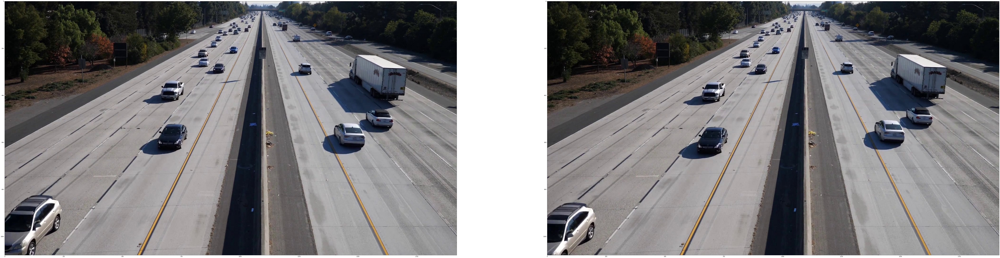

In [5]:
visualize_images(images)

## 1) YOLOv5 — Object Detection

-- Just copy and paste the parts from the object detection workshop

In [ ]:
!pip install yolo5 # version 0.0.1 used at the moment of recording

In [22]:
import yolov5
model = yolov5.load('tracking_course/yolov5s.pt')

In [23]:
model.conf = 0.5
model.iou = 0.4

In [24]:
classesFile = "tracking_course/coco.names"
with open(classesFile,'rt') as f:
    classes = f.read().rstrip('\n').split('\n')

def id_to_color(idx):
    """
    Random function to convert an id to a color
    Do what you want here but keep numbers below 255
    """
    blue = idx*5 % 256
    green = idx*12 %256
    red = idx*23 %256
    return (red, green, blue)

def draw_boxes_v5(image, boxes, categories, mot_mode=False):
    h, w, _ = image.shape
    for i, box in enumerate(boxes):
        label = classes[int(categories[i])]
        color = id_to_color(i*10) if mot_mode==True else (255,0,0)
        cv2.rectangle(image, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), color, thickness=7)
        cv2.putText(image, str(label), (int(box[0]), int(box[1])), cv2.FONT_HERSHEY_SIMPLEX, 1, (255,255,255), thickness=3)
    return image

def inference(img):
    results = model(img)
    predictions = results.pred[0]
    boxes = predictions[:, :4].tolist()
    boxes_int = [[int(v) for v in box] for box in boxes]
    scores = predictions[:,4].tolist()
    categories = predictions[:,5].tolist()
    categories_int = [int(c) for c in categories]
    img_out = draw_boxes_v5(img, boxes_int, categories_int, mot_mode=True)
    return img_out, boxes_int, categories_int, scores

In [25]:
yolo_images = []
yolo_boxes = []
yolo_categories = []
yolo_scores = []
pics = copy.deepcopy(images)

for img in pics:
    result, pred_bboxes, pred_categories, pred_scores = inference(img)
    yolo_boxes.append(pred_bboxes)
    yolo_images.append(result)
    yolo_categories.append(pred_categories)
    yolo_scores.append(pred_scores)

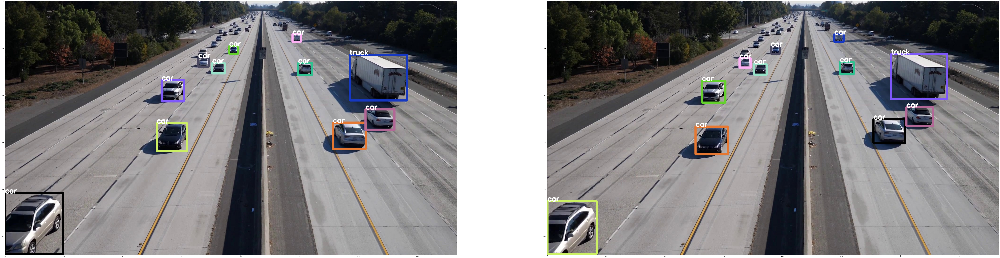

In [26]:
visualize_images(yolo_images)

In [27]:
print("Frame 1")
print(yolo_boxes[0])
print(yolo_categories[0])
print(yolo_scores[0])
print("Frame 2")
print(yolo_boxes[1])
print(yolo_categories[1])
print(yolo_scores[1])

Frame 1
[[0, 816, 247, 1074], [1392, 516, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [880, 263, 933, 307], [665, 336, 761, 426], [952, 191, 991, 223], [821, 241, 865, 278], [1245, 263, 1304, 314], [1464, 228, 1707, 422], [1221, 141, 1258, 172]]
[2, 2, 2, 2, 2, 2, 2, 2, 2, 7, 2]
[0.8724923729896545, 0.84758061170578, 0.8346817493438721, 0.8217247724533081, 0.7534336447715759, 0.7276580929756165, 0.674136757850647, 0.6619362831115723, 0.6110766530036926, 0.6107071042060852, 0.5088111758232117]
Frame 2
[[1385, 502, 1519, 603], [629, 533, 768, 651], [0, 850, 209, 1074], [1525, 451, 1638, 530], [877, 266, 931, 312], [1460, 225, 1698, 416], [656, 338, 756, 431], [949, 192, 988, 223], [1242, 258, 1301, 311], [1219, 141, 1258, 172], [816, 243, 863, 282]]
[2, 2, 2, 2, 2, 7, 2, 2, 2, 2, 2]
[0.8644407987594604, 0.8332921266555786, 0.8202304840087891, 0.7664721608161926, 0.7634636163711548, 0.701960563659668, 0.6731871366500854, 0.6427668929100037, 0.5756676197052002, 0.563746452331

## 2) Hungarian Algorithm with Deep Association Metrics

### 2.1 Load the Siamese Network

In [30]:
!mv tracking_course/siamese_net.py .

In [31]:
encoder = torch.load("tracking_course/model640.pt", map_location=torch.device('cpu'))
encoder = encoder.eval()

/usr/local/lib/python3.7/dist-packages/torch/serialization.py:786: SourceChangeWarning: source code of class 'siamese_net.SiameseNetwork' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/usr/local/lib/python3.7/dist-packages/torch/serialization.py:786: SourceChangeWarning: source code of class 'torch.nn.modules.container.Sequential' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch.nn.Module.dump_patches = True` and use the patch tool to revert the changes.
  warnings.warn(msg, SourceChangeWarning)
/usr/local/lib/python3.7/dist-packages/torch/serialization.py:786: SourceChangeWarning: source code of class 'torch.nn.modules.conv.Conv2d' has changed. you can retrieve the original source code by accessing the object's source attribute or set `torch

### 2.2 Crop the obstacles

In [32]:
def crop_frames(frame, boxes):
    try:
        transforms = torchvision.transforms.Compose([torchvision.transforms.ToPILImage(), torchvision.transforms.Resize((128,128)), torchvision.transforms.ToTensor()])
        crops = []
        crops_pytorch = []
        for box in boxes:
            crop = frame[int(box[1]):int(box[3]), int(box[0]):int(box[2])]
            crops.append(crop)
            crops_pytorch.append(transforms(crop))
        return crops, torch.stack(crops_pytorch)
    except:
        return [],[]

In [35]:
from scipy.stats import multivariate_normal

def get_gaussian_mask():
	#128 is image size
	x, y = np.mgrid[0:1.0:128j, 0:1.0:128j]
	xy = np.column_stack([x.flat, y.flat])
	mu = np.array([0.5,0.5])
	sigma = np.array([0.22,0.22])
	covariance = np.diag(sigma**2)
	z = multivariate_normal.pdf(xy, mean=mu, cov=covariance)
	z = z.reshape(x.shape)

	z = z / z.max()
	z  = z.astype(np.float32)

	mask = torch.from_numpy(z)

	return mask
gaussian_mask = get_gaussian_mask()

#### Frame 1

In [45]:
pics = copy.deepcopy(images)

In [46]:
print(pics[0].shape)
h, w, _ = pics[0].shape

(1080, 1920, 3)


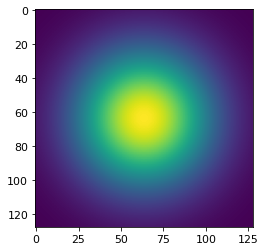

In [54]:
plt.imshow(gaussian_mask.numpy())

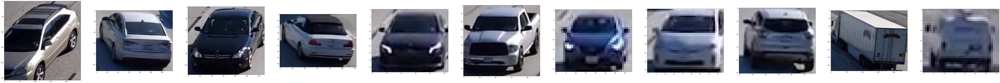

In [79]:
crops_1, crops_pytorch_1 = crop_frames(images[0], yolo_boxes[0])
crops_pytorch_1 = crops_pytorch_1*gaussian_mask
visualize_images(crops_1)

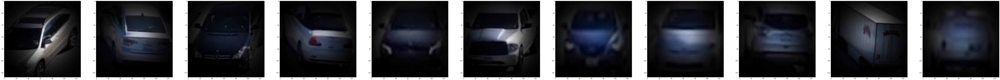

In [80]:
# visualize images with Guassian filtering (masking?)
visualize_images([crop.numpy().transpose(1,2,0) for crop in crops_pytorch_1])

#### Frame 2

In [ ]:
print(pics[1].shape)
h, w, _ = pics[1].shape

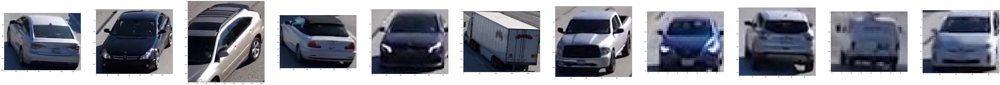

In [81]:
crops_2, crops_pytorch_2 = crop_frames(images[1], yolo_boxes[1])
crops_pytorch_2 = crops_pytorch_2*gaussian_mask
visualize_images(crops_2)

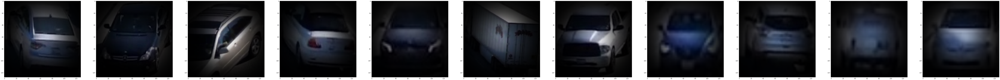

In [82]:
# visualize images with Guassian filtering (masking?)
visualize_images([crop.numpy().transpose(1,2,0) for crop in crops_pytorch_2])

### 2.3 Cosine Distance

In [62]:
def cosine_similarity(a, b, data_is_normalized=False):
    if not data_is_normalized:
        a = np.asarray(a) / np.linalg.norm(a, axis=1, keepdims=True)
        b = np.asarray(b) / np.linalg.norm(b, axis=1, keepdims=True)
    return np.dot(a, b.T)

In [63]:
## EXAMPLE
a = np.array([[0,0,1]])
b = np.array([[0,1,1]])
c = np.array([[1,1,0]])

print(cosine_similarity(a,b))
print(cosine_similarity(a,c))
print(cosine_similarity(a,a))

[[    0.70711]]
[[          0]]
[[          1]]


In [65]:
encoder

SiameseNetwork(
  (net): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2))
    (4): ReLU(inplace=True)
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
    (7): ReLU(inplace=True)
    (8): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): Conv2d(128, 256, kernel_size=(1, 1), stride=(2, 2))
    (10): ReLU(inplace=True)
    (11): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (12): Conv2d(256, 256, kernel_size=(1, 1), stride=(2, 2))
    (13): ReLU(inplace=True)
    (14): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (15): Conv2d(256, 512, kernel_size=(3, 3), stride=(2, 2))
    (16):

In [83]:
crops_pytorch_2.shape

torch.Size([11, 3, 128, 128])

In [84]:
out = encoder.forward_once(crops_pytorch_2)
out.shape

torch.Size([11, 1024])

In [157]:
def get_features(encoder, processed_crops):
    features = []
    if len(processed_crops) > 0:
        features = encoder.forward_once(processed_crops).detach().cpu().numpy()
        if len(features.shape) == 1:
            features = np.expand_dims(features, axis=0)

    return features

In [158]:
features_1 = get_features(encoder, crops_pytorch_1)
features_2 = get_features(encoder, crops_pytorch_2) 

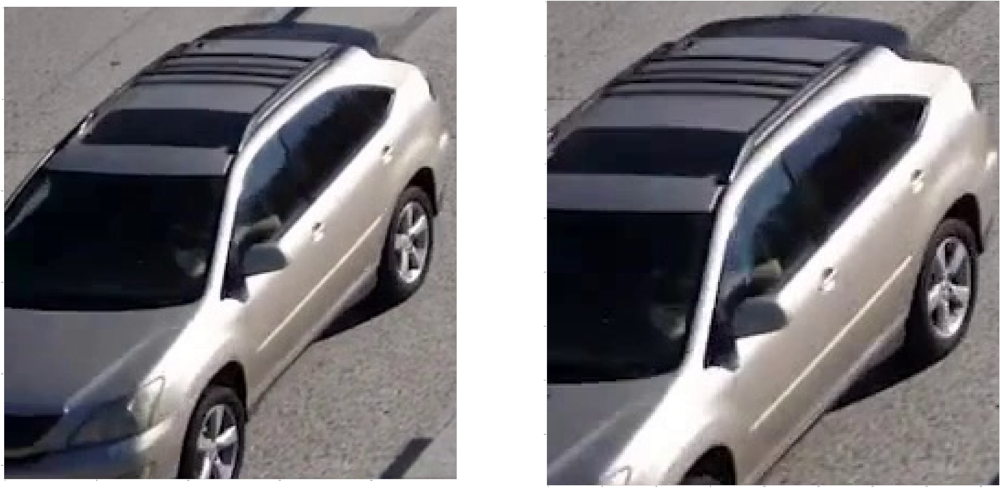

In [94]:
visualize_images([crops_1[0], crops_2[2]])

In [95]:
print(a)
features_1[a].shape

0


torch.Size([1024])

In [160]:
for a, box1 in enumerate(yolo_boxes[0]):
    print("--")
    for b, box2 in enumerate(yolo_boxes[1]):
        dist = cosine_similarity(features_1[a].reshape(1,1024), features_2[b].reshape(1,1024))
        print("Box ", a , ": ", str(box1),"Box ", b, ": ", str(box2), "Distance: ", str(dist[0][0]))

--
Box  0 :  [0, 816, 247, 1074] Box  0 :  [1385, 502, 1519, 603] Distance:  0.12224023
Box  0 :  [0, 816, 247, 1074] Box  1 :  [629, 533, 768, 651] Distance:  0.117675856
Box  0 :  [0, 816, 247, 1074] Box  2 :  [0, 850, 209, 1074] Distance:  0.30660355
Box  0 :  [0, 816, 247, 1074] Box  3 :  [1525, 451, 1638, 530] Distance:  0.05174515
Box  0 :  [0, 816, 247, 1074] Box  4 :  [877, 266, 931, 312] Distance:  0.08417874
Box  0 :  [0, 816, 247, 1074] Box  5 :  [1460, 225, 1698, 416] Distance:  0.3326859
Box  0 :  [0, 816, 247, 1074] Box  6 :  [656, 338, 756, 431] Distance:  0.032691438
Box  0 :  [0, 816, 247, 1074] Box  7 :  [949, 192, 988, 223] Distance:  0.14239135
Box  0 :  [0, 816, 247, 1074] Box  8 :  [1242, 258, 1301, 311] Distance:  0.3326804
Box  0 :  [0, 816, 247, 1074] Box  9 :  [1219, 141, 1258, 172] Distance:  0.18392527
Box  0 :  [0, 816, 247, 1074] Box  10 :  [816, 243, 863, 282] Distance:  0.04726727
--
Box  1 :  [1392, 516, 1532, 628] Box  0 :  [1385, 502, 1519, 603] Dista

### 2.4 Adding the other costs

In [161]:
def box_iou(box1, box2, w = 1280, h=360):
    xA = max(box1[0], box2[0])
    yA = max(box1[1], box2[1])
    xB = min(box1[2], box2[2])
    yB = min(box1[3], box2[3])

    inter_area = max(0, xB - xA + 1) * max(0, yB - yA + 1) #abs((xi2 - xi1)*(yi2 - yi1))
    # Calculate the Union area by using Formula: Union(A,B) = A + B - Inter(A,B)
    box1_area = (box1[2] - box1[0] + 1) * (box1[3] - box1[1] + 1) #abs((box1[3] - box1[1])*(box1[2]- box1[0]))
    box2_area = (box2[2] - box2[0] + 1) * (box2[3] - box2[1] + 1) #abs((box2[3] - box2[1])*(box2[2]- box2[0]))
    union_area = (box1_area + box2_area) - inter_area
    # compute the IoU
    iou = inter_area/float(union_area)
    return iou

In [162]:
def check_division_by_0(value, epsilon=0.01):
    if value < epsilon:
        value = epsilon
    return value

In [163]:
def sanchez_matilla(box1, box2, w = 1280, h=360):
    Q_dist = sqrt(pow(w,2)+pow(h,2)) # First real-life Pythagore use in your life
    Q_shape = w*h
    distance_term = Q_dist/check_division_by_0(sqrt(pow(box1[0] - box2[0], 2)+pow(box1[1] -box2[1],2)))
    shape_term = Q_shape/check_division_by_0(sqrt(pow(box1[2] - box2[2], 2)+pow(box1[3] - box2[3],2)))
    linear_cost = distance_term*shape_term
    return linear_cost

In [164]:
from math import sqrt, exp

def yu(box1, box2):
    w1 = 0.5
    w2 = 1.5
    a= (box1[0] - box2[0])/check_division_by_0(box1[2])
    a_2 = pow(a,2)
    b = (box1[1] - box2[1])/check_division_by_0(box1[3])
    b_2 = pow(b,2)
    ab = (a_2+b_2)*w1*(-1)
    c = abs(box1[3] - box2[3])/(box1[3]+box2[3])
    d = abs(box1[2]-box2[2])/(box1[2]+box2[2])
    cd = (c+d)*w2*(-1)
    exponential_cost = exp(ab)*exp(cd)
    return exponential_cost

In [165]:
def feature_cost(feature_1, feature_2):
  dist = cosine_similarity(feature_1, feature_2).squeeze()
  return dist
      

### 2.5. Main Function

In [166]:
def total_cost(old_box, new_box, old_features, new_features, iou_thresh = 0.3, linear_thresh = 10000, exp_thresh = 0.5, feat_thresh = 0.2):
    iou_cost = box_iou(old_box, new_box)
    linear_cost = sanchez_matilla(old_box, new_box, w= 1920, h=1080)
    exponential_cost = yu(old_box, new_box)
    feature_cost = cosine_similarity(old_features, new_features).squeeze()

    if (iou_cost >= iou_thresh and linear_cost >= linear_thresh and exponential_cost>=exp_thresh and feature_cost >= feat_thresh):
        return iou_cost

    else:
        return 0

#### Association

In [167]:
from scipy.optimize import linear_sum_assignment

def associate(old_boxes, new_boxes, old_features, new_features):
    """
    old_boxes will represent the former bounding boxes (at time 0)
    new_boxes will represent the new bounding boxes (at time 1)
    Function goal: Define a Hungarian Matrix with IOU as a metric and return, for each box, an id
    """
    if len(old_boxes)==0 and len(new_boxes)==0:
        return [], [], []
    elif(len(old_boxes)==0):
        return [], [i for i in range(len(new_boxes))], [] #Weird trick
    elif(len(new_boxes)==0):
        return [], [], [i for i in range(len(old_boxes))]# Weird trick 
        
    # Define a new IOU Matrix nxm with old and new boxes
    iou_matrix = np.zeros((len(old_boxes),len(new_boxes)),dtype=np.float32)
    
    # Go through boxes and store the IOU value for each box 
    # You can also use the more challenging cost but still use IOU as a reference for convenience (use as a filter only)
    for i,old_box in enumerate(old_boxes):
        for j,new_box in enumerate(new_boxes):
            iou_matrix[i][j] = total_cost(old_box, new_box, old_features[i].reshape(1,1024), new_features[j].reshape(1,1024))

    #print(iou_matrix)
    # Call for the Hungarian Algorithm
    hungarian_row, hungarian_col = linear_sum_assignment(-iou_matrix)
    hungarian_matrix = np.array(list(zip(hungarian_row, hungarian_col)))

    # Create new unmatched lists for old and new boxes
    matches, unmatched_detections, unmatched_trackers = [], [], []

    #print(hungarian_matrix)
    
    # Go through old boxes, if no matched detection, add it to the unmatched_old_boxes
    for t,trk in enumerate(old_boxes):
	    if(t not in hungarian_matrix[:,0]):
		    unmatched_trackers.append(t)
    
    # Go through new boxes, if no matched tracking, add it to the unmatched_new_boxes
    for d, det in enumerate(new_boxes):
        if(d not in hungarian_matrix[:,1]):
                unmatched_detections.append(d)
    
    # Go through the Hungarian Matrix, if matched element has IOU < threshold (0.3), add it to the unmatched 
    for h in hungarian_matrix:
        if(iou_matrix[h[0],h[1]]<0.3):
            unmatched_trackers.append(h[0]) # Return INDICES directly
            unmatched_detections.append(h[1]) # Return INDICES directly
        else:
            matches.append(h.reshape(1,2))
    
    if(len(matches)==0):
        matches = np.empty((0,2),dtype=int)
    else:
        matches = np.concatenate(matches,axis=0)
    

    return matches, unmatched_detections, unmatched_trackers

In [168]:
matches, unmatched_detections, unmatched_trackers = associate(yolo_boxes[0], yolo_boxes[1], features_1, features_2)

In [169]:
print(yolo_boxes[0])
print(yolo_boxes[1])
print(matches)

[[0, 816, 247, 1074], [1392, 516, 1532, 628], [644, 519, 774, 636], [1531, 460, 1654, 546], [880, 263, 933, 307], [665, 336, 761, 426], [952, 191, 991, 223], [821, 241, 865, 278], [1245, 263, 1304, 314], [1464, 228, 1707, 422], [1221, 141, 1258, 172]]
[[1385, 502, 1519, 603], [629, 533, 768, 651], [0, 850, 209, 1074], [1525, 451, 1638, 530], [877, 266, 931, 312], [1460, 225, 1698, 416], [656, 338, 756, 431], [949, 192, 988, 223], [1242, 258, 1301, 311], [1219, 141, 1258, 172], [816, 243, 863, 282]]
[[ 0  2]
 [ 1  0]
 [ 2  1]
 [ 3  3]
 [ 5  6]
 [ 6  7]
 [ 7 10]
 [ 8  8]
 [ 9  5]
 [10  9]]


In [170]:
print(unmatched_detections)

[4]


In [171]:
print(unmatched_trackers)

[4]


## 3) Hungarian Tracking Loop

In [174]:
MIN_HIT_STREAK = 2
MAX_UNMATCHED_AGE = 3

In [175]:
class Obstacle():
    def __init__(self, idx, box, features=None,  age=1, unmatched_age=0):
        """
        Init function. The obstacle must have an id and a box.
        """
        self.idx = idx
        self.box = box
        self.features = features
        self.age = age
        self.unmatched_age = unmatched_age

In [176]:
def main(input_image):
    global stored_obstacles
    global idx

    # 1 — Run Obstacle Detection & Convert the Boxes
    final_image = copy.deepcopy(input_image)
    h, w, _ = final_image.shape

    _, out_boxes, _, _ = inference(input_image)
    crops, crops_pytorch = crop_frames(final_image, out_boxes)
    features = get_features(encoder, crops_pytorch)
    
    print("----> New Detections: ", out_boxes)
    # Define the list we'll return:
    new_obstacles = []

    old_obstacles = [obs.box for obs in stored_obstacles] # Simply get the boxes
    old_features = [obs.features for obs in stored_obstacles]
    
    matches, unmatched_detections, unmatched_tracks = associate(old_obstacles, out_boxes, old_features, features)

    # Matching
    for match in matches:
        # get previous obstacle from stored obstacles
        obs = stored_obstacles[match[0]]

        # update track box, features, and age
        obs.box = out_boxes[match[1]]
        obs.features = features[match[1]]
        obs.age += 1
      
        new_obstacles.append(obs)
        print("Obstacle ", obs.idx, " with box: ", obs.box, "has been matched with obstacle ", stored_obstacles[match[0]].box, "and now has age: ", obs.age)
    
    # New (Unmatched) Detections
    for d in unmatched_detections:
        obs = Obstacle(idx, out_boxes[d], features[d])
        new_obstacles.append(obs)
        idx+=1
        print("Obstacle ", obs.idx, " has been detected for the first time: ", obs.box)

    # Unmatched Tracks
    for t in unmatched_tracks:
        i = old_obstacles.index(stored_obstacles[t].box)
        print("Old Obstacles tracked: ", stored_obstacles[i].box)
        if i is not None:
            obs = stored_obstacles[i]
            obs.unmatched_age +=1
            new_obstacles.append(obs)
            print("Obstacle ", obs.idx, "is a long term obstacle unmatched ", obs.unmatched_age, "times.")

    # Draw the Boxes
    for i, obs in enumerate(new_obstacles):
        if obs.unmatched_age > MAX_UNMATCHED_AGE:
            new_obstacles.remove(obs)

        if obs.age >= MIN_HIT_STREAK:
            left, top, right, bottom = obs.box
            cv2.rectangle(final_image, (left, top), (right, bottom), id_to_color(obs.idx*10), thickness=7)
            final_image = cv2.putText(final_image, str(obs.idx),(left - 10,top - 10),cv2.FONT_HERSHEY_SIMPLEX, 1,id_to_color(obs.idx*10),thickness=4)

    stored_obstacles = new_obstacles

    return final_image, stored_obstacles

----> New Detections:  [[502, 663, 676, 831], [545, 431, 664, 534], [829, 323, 901, 383], [785, 250, 850, 310], [932, 202, 976, 239], [974, 162, 1008, 187], [1618, 304, 1920, 844], [1331, 385, 1424, 467]]
Obstacle  0  has been detected for the first time:  [502, 663, 676, 831]
Obstacle  1  has been detected for the first time:  [545, 431, 664, 534]
Obstacle  2  has been detected for the first time:  [829, 323, 901, 383]
Obstacle  3  has been detected for the first time:  [785, 250, 850, 310]
Obstacle  4  has been detected for the first time:  [932, 202, 976, 239]
Obstacle  5  has been detected for the first time:  [974, 162, 1008, 187]
Obstacle  6  has been detected for the first time:  [1618, 304, 1920, 844]
Obstacle  7  has been detected for the first time:  [1331, 385, 1424, 467]
----> New Detections:  [[478, 682, 661, 859], [530, 437, 654, 548], [782, 256, 848, 313], [970, 163, 1007, 188], [826, 328, 896, 391], [931, 204, 975, 242], [1326, 378, 1418, 460], [1609, 304, 1920, 798]]
O

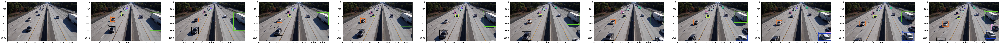

In [177]:
### Call the main loop

fig=plt.figure(figsize=(100,100))
out_imgs = []
idx = 0
stored_obstacles = []

for i in range(len(images)):
    out_img, stored_obstacles = main(images[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(images), i+1)
    plt.imshow(out_imgs[i])

plt.show()

Test Again with more images

In [178]:
images = []
index = 34

# 100 — Same number of detections
# 300 — 2 Lost Tracks
# 782 — 1 New Detection
# 654 — Edge Case

for img in images_files[index-2:index+10]:
    images.append(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))

----> New Detections:  [[502, 663, 676, 831], [545, 431, 664, 534], [829, 323, 901, 383], [785, 250, 850, 310], [932, 202, 976, 239], [974, 162, 1008, 187], [1618, 304, 1920, 844], [1331, 385, 1424, 467]]
Obstacle  0  has been detected for the first time:  [502, 663, 676, 831]
Obstacle  1  has been detected for the first time:  [545, 431, 664, 534]
Obstacle  2  has been detected for the first time:  [829, 323, 901, 383]
Obstacle  3  has been detected for the first time:  [785, 250, 850, 310]
Obstacle  4  has been detected for the first time:  [932, 202, 976, 239]
Obstacle  5  has been detected for the first time:  [974, 162, 1008, 187]
Obstacle  6  has been detected for the first time:  [1618, 304, 1920, 844]
Obstacle  7  has been detected for the first time:  [1331, 385, 1424, 467]
----> New Detections:  [[478, 682, 661, 859], [530, 437, 654, 548], [782, 256, 848, 313], [970, 163, 1007, 188], [826, 328, 896, 391], [931, 204, 975, 242], [1326, 378, 1418, 460], [1609, 304, 1920, 798]]
O

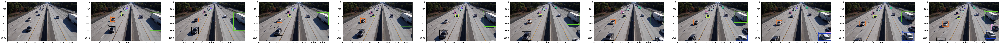

In [179]:
### Call the main loop
idx = 0
stored_obstacles = []
fig=plt.figure(figsize=(100,100))
pics = copy.deepcopy(images)
out_imgs = []

for i in range(len(pics)):
    out_img, stored_obstacles = main(pics[i])
    out_imgs.append(out_img)
    fig.add_subplot(1, len(pics), i+1)
    plt.imshow(out_imgs[i])

plt.show()

# Video


Now is the time to run on a video. 

In [154]:
len(sorted(glob.glob("tracking_course/data/*.png")))

837

In [188]:
import glob 
from tqdm import tqdm

idx = 0
stored_obstacles = []

video_images = sorted(glob.glob("tracking_course/data/*.png")) #kitti
# video_images = images_files #nvidia
result_video = []

for img in tqdm(video_images):
    out_img, stored_obstacles = main(cv2.cvtColor(cv2.imread(img), cv2.COLOR_BGR2RGB))
    if out_img is not None:
        result_video.append(out_img)

  0%|          | 0/837 [00:00<?, ?it/s]

----> New Detections:  [[686, 190, 791, 286], [0, 192, 196, 307], [288, 177, 368, 233], [349, 183, 470, 269], [463, 179, 523, 226], [623, 177, 652, 203], [662, 181, 721, 229], [582, 177, 618, 205]]
Obstacle  0  has been detected for the first time:  [686, 190, 791, 286]
Obstacle  1  has been detected for the first time:  [0, 192, 196, 307]
Obstacle  2  has been detected for the first time:  [288, 177, 368, 233]
Obstacle  3  has been detected for the first time:  [349, 183, 470, 269]
Obstacle  4  has been detected for the first time:  [463, 179, 523, 226]
Obstacle  5  has been detected for the first time:  [623, 177, 652, 203]
Obstacle  6  has been detected for the first time:  [662, 181, 721, 229]
Obstacle  7  has been detected for the first time:  [582, 177, 618, 205]


  0%|          | 3/837 [00:00<03:01,  4.60it/s]

----> New Detections:  [[0, 192, 190, 309], [689, 190, 795, 283], [346, 182, 470, 271], [282, 177, 367, 234], [462, 179, 523, 227], [664, 180, 721, 230], [583, 177, 618, 204], [622, 178, 652, 202]]
Obstacle  0  with box:  [689, 190, 795, 283] has been matched with obstacle  [689, 190, 795, 283] and now has age:  2
Obstacle  1  with box:  [0, 192, 190, 309] has been matched with obstacle  [0, 192, 190, 309] and now has age:  2
Obstacle  2  with box:  [282, 177, 367, 234] has been matched with obstacle  [282, 177, 367, 234] and now has age:  2
Obstacle  3  with box:  [346, 182, 470, 271] has been matched with obstacle  [346, 182, 470, 271] and now has age:  2
Obstacle  4  with box:  [462, 179, 523, 227] has been matched with obstacle  [462, 179, 523, 227] and now has age:  2
Obstacle  5  with box:  [622, 178, 652, 202] has been matched with obstacle  [622, 178, 652, 202] and now has age:  2
Obstacle  6  with box:  [664, 180, 721, 230] has been matched with obstacle  [664, 180, 721, 230] 

  1%|          | 5/837 [00:00<02:03,  6.75it/s]

----> New Detections:  [[334, 183, 467, 275], [698, 191, 810, 285], [1, 194, 166, 319], [268, 179, 357, 237], [459, 178, 520, 227], [663, 179, 722, 229]]
Obstacle  0  with box:  [698, 191, 810, 285] has been matched with obstacle  [698, 191, 810, 285] and now has age:  5
Obstacle  1  with box:  [1, 194, 166, 319] has been matched with obstacle  [1, 194, 166, 319] and now has age:  5
Obstacle  2  with box:  [268, 179, 357, 237] has been matched with obstacle  [268, 179, 357, 237] and now has age:  5
Obstacle  3  with box:  [334, 183, 467, 275] has been matched with obstacle  [334, 183, 467, 275] and now has age:  5
Obstacle  4  with box:  [459, 178, 520, 227] has been matched with obstacle  [459, 178, 520, 227] and now has age:  5
Obstacle  6  with box:  [663, 179, 722, 229] has been matched with obstacle  [663, 179, 722, 229] and now has age:  5
Old Obstacles tracked:  [581, 176, 617, 204]
Obstacle  7 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [622, 178, 651, 2

  1%|          | 9/837 [00:01<01:30,  9.18it/s]

----> New Detections:  [[253, 178, 346, 241], [702, 192, 817, 287], [321, 183, 462, 279], [0, 191, 142, 317], [664, 182, 722, 230], [451, 178, 514, 227], [579, 177, 617, 205]]
Obstacle  0  with box:  [702, 192, 817, 287] has been matched with obstacle  [702, 192, 817, 287] and now has age:  8
Obstacle  1  with box:  [0, 191, 142, 317] has been matched with obstacle  [0, 191, 142, 317] and now has age:  8
Obstacle  2  with box:  [253, 178, 346, 241] has been matched with obstacle  [253, 178, 346, 241] and now has age:  8
Obstacle  3  with box:  [321, 183, 462, 279] has been matched with obstacle  [321, 183, 462, 279] and now has age:  8
Obstacle  4  with box:  [451, 178, 514, 227] has been matched with obstacle  [451, 178, 514, 227] and now has age:  8
Obstacle  6  with box:  [664, 182, 722, 230] has been matched with obstacle  [664, 182, 722, 230] and now has age:  8
Obstacle  7  with box:  [579, 177, 617, 205] has been matched with obstacle  [579, 177, 617, 205] and now has age:  7
Ol

  2%|▏         | 13/837 [00:01<01:18, 10.55it/s]

----> New Detections:  [[235, 179, 335, 243], [705, 191, 827, 287], [313, 185, 460, 282], [664, 181, 724, 229], [0, 186, 117, 320], [451, 179, 515, 228]]
Obstacle  0  with box:  [705, 191, 827, 287] has been matched with obstacle  [705, 191, 827, 287] and now has age:  11
Obstacle  2  with box:  [235, 179, 335, 243] has been matched with obstacle  [235, 179, 335, 243] and now has age:  11
Obstacle  3  with box:  [313, 185, 460, 282] has been matched with obstacle  [313, 185, 460, 282] and now has age:  11
Obstacle  4  with box:  [451, 179, 515, 228] has been matched with obstacle  [451, 179, 515, 228] and now has age:  11
Obstacle  6  with box:  [664, 181, 724, 229] has been matched with obstacle  [664, 181, 724, 229] and now has age:  11
Obstacle  9  with box:  [0, 186, 117, 320] has been matched with obstacle  [0, 186, 117, 320] and now has age:  2
Old Obstacles tracked:  [582, 177, 614, 205]
Obstacle  7 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 193, 134

  2%|▏         | 15/837 [00:01<01:14, 10.97it/s]

----> New Detections:  [[710, 190, 831, 285], [304, 184, 455, 288], [216, 179, 325, 248], [665, 181, 726, 228], [448, 179, 514, 230], [580, 176, 612, 202]]
Obstacle  0  with box:  [710, 190, 831, 285] has been matched with obstacle  [710, 190, 831, 285] and now has age:  14
Obstacle  2  with box:  [216, 179, 325, 248] has been matched with obstacle  [216, 179, 325, 248] and now has age:  14
Obstacle  3  with box:  [304, 184, 455, 288] has been matched with obstacle  [304, 184, 455, 288] and now has age:  14
Obstacle  4  with box:  [448, 179, 514, 230] has been matched with obstacle  [448, 179, 514, 230] and now has age:  14
Obstacle  6  with box:  [665, 181, 726, 228] has been matched with obstacle  [665, 181, 726, 228] and now has age:  14
Obstacle  10  has been detected for the first time:  [580, 176, 612, 202]
Old Obstacles tracked:  [0, 207, 97, 311]
Obstacle  1 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 195, 110, 316]
Obstacle  9 is a long term obstacl

  2%|▏         | 19/837 [00:02<01:11, 11.50it/s]

----> New Detections:  [[711, 190, 838, 289], [296, 185, 455, 291], [195, 179, 317, 251], [664, 181, 727, 228], [447, 180, 515, 230], [581, 176, 613, 202]]
Obstacle  0  with box:  [711, 190, 838, 289] has been matched with obstacle  [711, 190, 838, 289] and now has age:  17
Obstacle  2  with box:  [195, 179, 317, 251] has been matched with obstacle  [195, 179, 317, 251] and now has age:  17
Obstacle  3  with box:  [296, 185, 455, 291] has been matched with obstacle  [296, 185, 455, 291] and now has age:  17
Obstacle  4  with box:  [447, 180, 515, 230] has been matched with obstacle  [447, 180, 515, 230] and now has age:  17
Obstacle  6  with box:  [664, 181, 727, 228] has been matched with obstacle  [664, 181, 727, 228] and now has age:  17
Obstacle  10  with box:  [581, 176, 613, 202] has been matched with obstacle  [581, 176, 613, 202] and now has age:  4
----> New Detections:  [[711, 190, 839, 286], [293, 185, 454, 291], [187, 178, 312, 253], [663, 180, 727, 229], [448, 180, 515, 23

  3%|▎         | 21/837 [00:02<01:08, 11.98it/s]

----> New Detections:  [[712, 191, 840, 284], [173, 178, 306, 256], [289, 184, 452, 293], [662, 181, 726, 228], [444, 179, 515, 231], [582, 177, 614, 201]]
Obstacle  0  with box:  [712, 191, 840, 284] has been matched with obstacle  [712, 191, 840, 284] and now has age:  20
Obstacle  2  with box:  [173, 178, 306, 256] has been matched with obstacle  [173, 178, 306, 256] and now has age:  20
Obstacle  3  with box:  [289, 184, 452, 293] has been matched with obstacle  [289, 184, 452, 293] and now has age:  20
Obstacle  4  with box:  [444, 179, 515, 231] has been matched with obstacle  [444, 179, 515, 231] and now has age:  20
Obstacle  6  with box:  [662, 181, 726, 228] has been matched with obstacle  [662, 181, 726, 228] and now has age:  20
Obstacle  10  with box:  [582, 177, 614, 201] has been matched with obstacle  [582, 177, 614, 201] and now has age:  7
----> New Detections:  [[164, 179, 305, 257], [287, 184, 453, 294], [712, 190, 839, 283], [444, 179, 515, 233], [662, 181, 725, 22

  3%|▎         | 25/837 [00:02<01:07, 12.08it/s]

----> New Detections:  [[146, 181, 295, 262], [283, 185, 448, 295], [713, 190, 839, 280], [445, 179, 515, 231], [664, 181, 723, 226], [583, 177, 614, 201]]
Obstacle  0  with box:  [713, 190, 839, 280] has been matched with obstacle  [713, 190, 839, 280] and now has age:  23
Obstacle  2  with box:  [146, 181, 295, 262] has been matched with obstacle  [146, 181, 295, 262] and now has age:  23
Obstacle  3  with box:  [283, 185, 448, 295] has been matched with obstacle  [283, 185, 448, 295] and now has age:  23
Obstacle  4  with box:  [445, 179, 515, 231] has been matched with obstacle  [445, 179, 515, 231] and now has age:  23
Obstacle  6  with box:  [664, 181, 723, 226] has been matched with obstacle  [664, 181, 723, 226] and now has age:  23
Obstacle  10  with box:  [583, 177, 614, 201] has been matched with obstacle  [583, 177, 614, 201] and now has age:  10
----> New Detections:  [[138, 180, 293, 263], [281, 186, 447, 295], [713, 190, 839, 280], [444, 180, 516, 232], [662, 181, 722, 2

  3%|▎         | 27/837 [00:02<01:06, 12.22it/s]

----> New Detections:  [[119, 179, 282, 266], [278, 185, 448, 296], [711, 189, 837, 278], [661, 180, 721, 225], [442, 179, 515, 231], [581, 174, 611, 201]]
Obstacle  0  with box:  [711, 189, 837, 278] has been matched with obstacle  [711, 189, 837, 278] and now has age:  26
Obstacle  3  with box:  [278, 185, 448, 296] has been matched with obstacle  [278, 185, 448, 296] and now has age:  26
Obstacle  4  with box:  [442, 179, 515, 231] has been matched with obstacle  [442, 179, 515, 231] and now has age:  26
Obstacle  6  with box:  [661, 180, 721, 225] has been matched with obstacle  [661, 180, 721, 225] and now has age:  26
Obstacle  11  with box:  [119, 179, 282, 266] has been matched with obstacle  [119, 179, 282, 266] and now has age:  3
Obstacle  10  with box:  [581, 174, 611, 201] has been matched with obstacle  [581, 174, 611, 201] and now has age:  12
Old Obstacles tracked:  [14, 181, 81, 215]
Obstacle  13 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [505,

  4%|▎         | 31/837 [00:03<01:05, 12.22it/s]

----> New Detections:  [[91, 179, 263, 272], [710, 189, 831, 275], [273, 185, 447, 298], [659, 180, 719, 224], [437, 180, 511, 233]]
Obstacle  0  with box:  [710, 189, 831, 275] has been matched with obstacle  [710, 189, 831, 275] and now has age:  29
Obstacle  3  with box:  [273, 185, 447, 298] has been matched with obstacle  [273, 185, 447, 298] and now has age:  29
Obstacle  4  with box:  [437, 180, 511, 233] has been matched with obstacle  [437, 180, 511, 233] and now has age:  29
Obstacle  6  with box:  [659, 180, 719, 224] has been matched with obstacle  [659, 180, 719, 224] and now has age:  29
Obstacle  14  has been detected for the first time:  [91, 179, 263, 272]
Old Obstacles tracked:  [98, 179, 276, 269]
Obstacle  11 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [581, 174, 611, 200]
Obstacle  10 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [14, 181, 81, 215]
Obstacle  13 is a long term obstacle unmatched  4 times.
----> New Detec

  4%|▍         | 33/837 [00:03<01:07, 11.87it/s]

----> New Detections:  [[57, 181, 255, 275], [269, 184, 447, 299], [710, 188, 826, 269], [656, 179, 713, 222], [435, 180, 509, 234], [502, 179, 536, 215], [581, 175, 610, 199]]
Obstacle  0  with box:  [710, 188, 826, 269] has been matched with obstacle  [710, 188, 826, 269] and now has age:  32
Obstacle  3  with box:  [269, 184, 447, 299] has been matched with obstacle  [269, 184, 447, 299] and now has age:  32
Obstacle  4  with box:  [435, 180, 509, 234] has been matched with obstacle  [435, 180, 509, 234] and now has age:  32
Obstacle  6  with box:  [656, 179, 713, 222] has been matched with obstacle  [656, 179, 713, 222] and now has age:  32
Obstacle  14  with box:  [57, 181, 255, 275] has been matched with obstacle  [57, 181, 255, 275] and now has age:  4
Obstacle  15  with box:  [502, 179, 536, 215] has been matched with obstacle  [502, 179, 536, 215] and now has age:  2
Obstacle  16  has been detected for the first time:  [581, 175, 610, 199]
Old Obstacles tracked:  [98, 179, 276

  4%|▍         | 35/837 [00:03<01:07, 11.80it/s]

----> New Detections:  [[24, 182, 232, 282], [265, 186, 445, 300], [705, 188, 819, 265], [436, 179, 509, 236], [655, 180, 710, 221], [580, 176, 608, 199], [505, 179, 535, 216]]
Obstacle  3  with box:  [265, 186, 445, 300] has been matched with obstacle  [265, 186, 445, 300] and now has age:  35
Obstacle  4  with box:  [436, 179, 509, 236] has been matched with obstacle  [436, 179, 509, 236] and now has age:  35
Obstacle  6  with box:  [655, 180, 710, 221] has been matched with obstacle  [655, 180, 710, 221] and now has age:  35
Obstacle  14  with box:  [24, 182, 232, 282] has been matched with obstacle  [24, 182, 232, 282] and now has age:  7
Obstacle  16  with box:  [580, 176, 608, 199] has been matched with obstacle  [580, 176, 608, 199] and now has age:  4
Obstacle  17  with box:  [705, 188, 819, 265] has been matched with obstacle  [705, 188, 819, 265] and now has age:  3
Obstacle  15  with box:  [505, 179, 535, 216] has been matched with obstacle  [505, 179, 535, 216] and now has 

  5%|▍         | 39/837 [00:03<01:03, 12.50it/s]

----> New Detections:  [[2, 183, 218, 292], [701, 189, 813, 265], [260, 187, 444, 304], [653, 180, 705, 219], [437, 181, 507, 237]]
Obstacle  3  with box:  [260, 187, 444, 304] has been matched with obstacle  [260, 187, 444, 304] and now has age:  38
Obstacle  4  with box:  [437, 181, 507, 237] has been matched with obstacle  [437, 181, 507, 237] and now has age:  38
Obstacle  6  with box:  [653, 180, 705, 219] has been matched with obstacle  [653, 180, 705, 219] and now has age:  38
Obstacle  17  with box:  [701, 189, 813, 265] has been matched with obstacle  [701, 189, 813, 265] and now has age:  6
Obstacle  19  has been detected for the first time:  [2, 183, 218, 292]
Old Obstacles tracked:  [1, 183, 225, 290]
Obstacle  14 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [580, 176, 610, 200]
Obstacle  16 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [534, 180, 559, 201]
Obstacle  18 is a long term obstacle unmatched  2 times.
Old Obstacles tr

  5%|▍         | 41/837 [00:03<01:08, 11.64it/s]

----> New Detections:  [[0, 184, 200, 300], [704, 189, 807, 264], [252, 188, 441, 306], [651, 181, 705, 221], [433, 182, 507, 238], [531, 179, 561, 205]]
Obstacle  3  with box:  [252, 188, 441, 306] has been matched with obstacle  [252, 188, 441, 306] and now has age:  41
Obstacle  4  with box:  [433, 182, 507, 238] has been matched with obstacle  [433, 182, 507, 238] and now has age:  41
Obstacle  17  with box:  [704, 189, 807, 264] has been matched with obstacle  [704, 189, 807, 264] and now has age:  9
Obstacle  21  with box:  [0, 184, 200, 300] has been matched with obstacle  [0, 184, 200, 300] and now has age:  3
Obstacle  6  with box:  [651, 181, 705, 221] has been matched with obstacle  [651, 181, 705, 221] and now has age:  40
Obstacle  22  has been detected for the first time:  [531, 179, 561, 205]
Old Obstacles tracked:  [653, 180, 704, 220]
Obstacle  20 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [2, 183, 218, 292]
Obstacle  19 is a long term obstacle

  5%|▌         | 43/837 [00:04<01:13, 10.87it/s]

----> New Detections:  [[704, 189, 805, 264], [0, 184, 186, 304], [251, 190, 439, 307], [653, 182, 702, 220], [431, 181, 507, 240], [50, 152, 166, 214], [534, 181, 559, 202], [499, 179, 534, 219], [578, 173, 610, 201]]
Obstacle  3  with box:  [251, 190, 439, 307] has been matched with obstacle  [251, 190, 439, 307] and now has age:  43
Obstacle  4  with box:  [431, 181, 507, 240] has been matched with obstacle  [431, 181, 507, 240] and now has age:  43
Obstacle  21  with box:  [0, 184, 186, 304] has been matched with obstacle  [0, 184, 186, 304] and now has age:  5
Obstacle  20  with box:  [653, 182, 702, 220] has been matched with obstacle  [653, 182, 702, 220] and now has age:  3
Obstacle  24  with box:  [499, 179, 534, 219] has been matched with obstacle  [499, 179, 534, 219] and now has age:  2
Obstacle  25  with box:  [704, 189, 805, 264] has been matched with obstacle  [704, 189, 805, 264] and now has age:  2
Obstacle  22  with box:  [534, 181, 559, 202] has been matched with obs

  5%|▌         | 45/837 [00:04<01:17, 10.27it/s]

----> New Detections:  [[0, 184, 171, 311], [703, 189, 803, 264], [241, 192, 437, 311], [653, 182, 700, 220], [431, 181, 507, 243], [389, 185, 442, 220]]
Obstacle  3  with box:  [241, 192, 437, 311] has been matched with obstacle  [241, 192, 437, 311] and now has age:  45
Obstacle  4  with box:  [431, 181, 507, 243] has been matched with obstacle  [431, 181, 507, 243] and now has age:  45
Obstacle  21  with box:  [0, 184, 171, 311] has been matched with obstacle  [0, 184, 171, 311] and now has age:  7
Obstacle  20  with box:  [653, 182, 700, 220] has been matched with obstacle  [653, 182, 700, 220] and now has age:  5
Obstacle  25  with box:  [703, 189, 803, 264] has been matched with obstacle  [703, 189, 803, 264] and now has age:  4
Obstacle  28  has been detected for the first time:  [389, 185, 442, 220]
Old Obstacles tracked:  [500, 179, 535, 219]
Obstacle  24 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [534, 181, 559, 203]
Obstacle  22 is a long term obstac

  6%|▌         | 47/837 [00:04<01:19,  9.95it/s]

----> New Detections:  [[230, 191, 433, 318], [0, 185, 151, 318], [702, 190, 802, 264], [651, 184, 699, 219], [428, 183, 509, 242], [384, 185, 439, 227], [578, 173, 613, 202]]
Obstacle  3  with box:  [230, 191, 433, 318] has been matched with obstacle  [230, 191, 433, 318] and now has age:  47
Obstacle  4  with box:  [428, 183, 509, 242] has been matched with obstacle  [428, 183, 509, 242] and now has age:  47
Obstacle  21  with box:  [0, 185, 151, 318] has been matched with obstacle  [0, 185, 151, 318] and now has age:  9
Obstacle  20  with box:  [651, 184, 699, 219] has been matched with obstacle  [651, 184, 699, 219] and now has age:  7
Obstacle  28  with box:  [384, 185, 439, 227] has been matched with obstacle  [384, 185, 439, 227] and now has age:  3
Obstacle  26  with box:  [578, 173, 613, 202] has been matched with obstacle  [578, 173, 613, 202] and now has age:  3
Obstacle  29  with box:  [702, 190, 802, 264] has been matched with obstacle  [702, 190, 802, 264] and now has age

  6%|▌         | 49/837 [00:04<01:13, 10.70it/s]

Obstacle  3  with box:  [208, 188, 432, 325] has been matched with obstacle  [208, 188, 432, 325] and now has age:  49
Obstacle  4  with box:  [426, 182, 508, 244] has been matched with obstacle  [426, 182, 508, 244] and now has age:  49
Obstacle  21  with box:  [0, 184, 133, 319] has been matched with obstacle  [0, 184, 133, 319] and now has age:  11
Obstacle  20  with box:  [652, 184, 697, 218] has been matched with obstacle  [652, 184, 697, 218] and now has age:  9
Obstacle  28  with box:  [383, 186, 437, 227] has been matched with obstacle  [383, 186, 437, 227] and now has age:  5
Obstacle  29  with box:  [703, 191, 802, 264] has been matched with obstacle  [703, 191, 802, 264] and now has age:  4
Old Obstacles tracked:  [578, 173, 613, 202]
Obstacle  26 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [703, 189, 803, 264]
Obstacle  25 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [50, 152, 166, 214]
Obstacle  27 is a long term obstacle unma

  6%|▋         | 53/837 [00:05<01:15, 10.39it/s]

----> New Detections:  [[701, 192, 800, 263], [178, 190, 423, 336], [649, 182, 695, 219], [0, 188, 96, 316], [375, 186, 432, 226], [421, 184, 506, 248]]
Obstacle  3  with box:  [178, 190, 423, 336] has been matched with obstacle  [178, 190, 423, 336] and now has age:  52
Obstacle  4  with box:  [421, 184, 506, 248] has been matched with obstacle  [421, 184, 506, 248] and now has age:  52
Obstacle  28  with box:  [375, 186, 432, 226] has been matched with obstacle  [375, 186, 432, 226] and now has age:  8
Obstacle  29  with box:  [701, 192, 800, 263] has been matched with obstacle  [701, 192, 800, 263] and now has age:  7
Obstacle  31  with box:  [649, 182, 695, 219] has been matched with obstacle  [649, 182, 695, 219] and now has age:  2
Obstacle  32  with box:  [0, 188, 96, 316] has been matched with obstacle  [0, 188, 96, 316] and now has age:  2
Old Obstacles tracked:  [0, 183, 121, 319]
Obstacle  21 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [652, 184, 695,

  7%|▋         | 55/837 [00:05<01:14, 10.49it/s]

Obstacle  3  with box:  [145, 190, 413, 350] has been matched with obstacle  [145, 190, 413, 350] and now has age:  54
Obstacle  4  with box:  [418, 183, 502, 248] has been matched with obstacle  [418, 183, 502, 248] and now has age:  54
Obstacle  28  with box:  [371, 186, 429, 228] has been matched with obstacle  [371, 186, 429, 228] and now has age:  10
Obstacle  29  with box:  [699, 193, 799, 263] has been matched with obstacle  [699, 193, 799, 263] and now has age:  9
Obstacle  31  with box:  [649, 183, 693, 219] has been matched with obstacle  [649, 183, 693, 219] and now has age:  4
Obstacle  32  with box:  [0, 203, 66, 313] has been matched with obstacle  [0, 203, 66, 313] and now has age:  4
Obstacle  33  with box:  [586, 181, 615, 204] has been matched with obstacle  [586, 181, 615, 204] and now has age:  2
Old Obstacles tracked:  [0, 183, 121, 319]
Obstacle  21 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [493, 180, 534, 222]
Obstacle  30 is a long term

  7%|▋         | 57/837 [00:05<01:12, 10.81it/s]

----> New Detections:  [[76, 194, 395, 371], [697, 193, 799, 263], [411, 184, 500, 254], [648, 185, 690, 218], [362, 187, 423, 231], [481, 184, 533, 227]]
Obstacle  3  with box:  [76, 194, 395, 371] has been matched with obstacle  [76, 194, 395, 371] and now has age:  57
Obstacle  4  with box:  [411, 184, 500, 254] has been matched with obstacle  [411, 184, 500, 254] and now has age:  57
Obstacle  28  with box:  [362, 187, 423, 231] has been matched with obstacle  [362, 187, 423, 231] and now has age:  13
Obstacle  29  with box:  [697, 193, 799, 263] has been matched with obstacle  [697, 193, 799, 263] and now has age:  12
Obstacle  31  with box:  [648, 185, 690, 218] has been matched with obstacle  [648, 185, 690, 218] and now has age:  7
Obstacle  34  with box:  [481, 184, 533, 227] has been matched with obstacle  [481, 184, 533, 227] and now has age:  2
Old Obstacles tracked:  [580, 179, 614, 203]
Obstacle  33 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 1

  7%|▋         | 61/837 [00:05<01:11, 10.80it/s]

----> New Detections:  [[0, 203, 367, 373], [697, 194, 796, 261], [400, 185, 495, 257], [357, 187, 410, 227], [648, 184, 688, 218], [471, 183, 528, 228], [225, 189, 335, 231], [528, 184, 561, 206], [578, 176, 612, 203]]
Obstacle  3  with box:  [0, 203, 367, 373] has been matched with obstacle  [0, 203, 367, 373] and now has age:  60
Obstacle  4  with box:  [400, 185, 495, 257] has been matched with obstacle  [400, 185, 495, 257] and now has age:  60
Obstacle  28  with box:  [357, 187, 410, 227] has been matched with obstacle  [357, 187, 410, 227] and now has age:  16
Obstacle  29  with box:  [697, 194, 796, 261] has been matched with obstacle  [697, 194, 796, 261] and now has age:  15
Obstacle  34  with box:  [471, 183, 528, 228] has been matched with obstacle  [471, 183, 528, 228] and now has age:  5
Obstacle  35  with box:  [528, 184, 561, 206] has been matched with obstacle  [528, 184, 561, 206] and now has age:  3
Obstacle  36  with box:  [578, 176, 612, 203] has been matched with 

  8%|▊         | 63/837 [00:06<01:13, 10.59it/s]

Obstacle  3  with box:  [0, 207, 342, 376] has been matched with obstacle  [0, 207, 342, 376] and now has age:  62
Obstacle  4  with box:  [392, 185, 492, 261] has been matched with obstacle  [392, 185, 492, 261] and now has age:  62
Obstacle  28  with box:  [349, 188, 405, 229] has been matched with obstacle  [349, 188, 405, 229] and now has age:  18
Obstacle  29  with box:  [697, 193, 796, 261] has been matched with obstacle  [697, 193, 796, 261] and now has age:  17
Obstacle  34  with box:  [475, 184, 529, 231] has been matched with obstacle  [475, 184, 529, 231] and now has age:  7
Obstacle  35  with box:  [528, 183, 560, 206] has been matched with obstacle  [528, 183, 560, 206] and now has age:  5
Obstacle  37  with box:  [203, 188, 330, 257] has been matched with obstacle  [203, 188, 330, 257] and now has age:  3
Obstacle  38  with box:  [649, 184, 686, 216] has been matched with obstacle  [649, 184, 686, 216] and now has age:  3
Obstacle  36  with box:  [579, 177, 612, 203] has 

  8%|▊         | 65/837 [00:06<01:14, 10.43it/s]

----> New Detections:  [[0, 214, 292, 376], [697, 190, 798, 259], [161, 189, 312, 261], [646, 181, 686, 215], [374, 183, 486, 264], [338, 184, 388, 228], [465, 180, 511, 227]]
Obstacle  3  with box:  [0, 214, 292, 376] has been matched with obstacle  [0, 214, 292, 376] and now has age:  65
Obstacle  4  with box:  [374, 183, 486, 264] has been matched with obstacle  [374, 183, 486, 264] and now has age:  65
Obstacle  29  with box:  [697, 190, 798, 259] has been matched with obstacle  [697, 190, 798, 259] and now has age:  20
Obstacle  38  with box:  [646, 181, 686, 215] has been matched with obstacle  [646, 181, 686, 215] and now has age:  6
Obstacle  39  with box:  [465, 180, 511, 227] has been matched with obstacle  [465, 180, 511, 227] and now has age:  2
Obstacle  40  has been detected for the first time:  [338, 184, 388, 228]
Obstacle  41  has been detected for the first time:  [161, 189, 312, 261]
Old Obstacles tracked:  [343, 187, 393, 229]
Obstacle  28 is a long term obstacle un

  8%|▊         | 67/837 [00:06<01:16, 10.08it/s]

----> New Detections:  [[132, 186, 299, 267], [0, 225, 243, 376], [697, 187, 799, 257], [363, 181, 481, 268], [647, 177, 684, 210], [329, 183, 378, 228], [454, 178, 513, 228], [525, 180, 549, 205], [584, 176, 611, 199]]
Obstacle  3  with box:  [0, 225, 243, 376] has been matched with obstacle  [0, 225, 243, 376] and now has age:  67
Obstacle  4  with box:  [363, 181, 481, 268] has been matched with obstacle  [363, 181, 481, 268] and now has age:  67
Obstacle  38  with box:  [647, 177, 684, 210] has been matched with obstacle  [647, 177, 684, 210] and now has age:  8
Obstacle  39  with box:  [454, 178, 513, 228] has been matched with obstacle  [454, 178, 513, 228] and now has age:  4
Obstacle  40  with box:  [329, 183, 378, 228] has been matched with obstacle  [329, 183, 378, 228] and now has age:  3
Obstacle  41  with box:  [132, 186, 299, 267] has been matched with obstacle  [132, 186, 299, 267] and now has age:  3
Obstacle  35  with box:  [525, 180, 549, 205] has been matched with ob

  8%|▊         | 70/837 [00:06<01:18,  9.80it/s]

----> New Detections:  [[107, 185, 285, 271], [697, 187, 800, 259], [345, 182, 473, 272], [0, 264, 176, 375], [647, 177, 683, 208], [448, 178, 509, 231], [520, 180, 545, 206]]
Obstacle  3  with box:  [0, 264, 176, 375] has been matched with obstacle  [0, 264, 176, 375] and now has age:  69
Obstacle  4  with box:  [345, 182, 473, 272] has been matched with obstacle  [345, 182, 473, 272] and now has age:  69
Obstacle  38  with box:  [647, 177, 683, 208] has been matched with obstacle  [647, 177, 683, 208] and now has age:  10
Obstacle  39  with box:  [448, 178, 509, 231] has been matched with obstacle  [448, 178, 509, 231] and now has age:  6
Obstacle  41  with box:  [107, 185, 285, 271] has been matched with obstacle  [107, 185, 285, 271] and now has age:  5
Obstacle  35  with box:  [520, 180, 545, 206] has been matched with obstacle  [520, 180, 545, 206] and now has age:  9
Obstacle  43  with box:  [697, 187, 800, 259] has been matched with obstacle  [697, 187, 800, 259] and now has ag

  9%|▊         | 72/837 [00:06<01:14, 10.25it/s]

----> New Detections:  [[63, 186, 259, 280], [698, 187, 802, 259], [318, 182, 467, 281], [434, 177, 507, 237], [644, 178, 681, 207], [519, 179, 545, 204], [581, 173, 612, 197]]
Obstacle  4  with box:  [318, 182, 467, 281] has been matched with obstacle  [318, 182, 467, 281] and now has age:  72
Obstacle  38  with box:  [644, 178, 681, 207] has been matched with obstacle  [644, 178, 681, 207] and now has age:  13
Obstacle  39  with box:  [434, 177, 507, 237] has been matched with obstacle  [434, 177, 507, 237] and now has age:  9
Obstacle  35  with box:  [519, 179, 545, 204] has been matched with obstacle  [519, 179, 545, 204] and now has age:  12
Obstacle  43  with box:  [698, 187, 802, 259] has been matched with obstacle  [698, 187, 802, 259] and now has age:  6
Obstacle  42  with box:  [581, 173, 612, 197] has been matched with obstacle  [581, 173, 612, 197] and now has age:  5
Obstacle  44  with box:  [63, 186, 259, 280] has been matched with obstacle  [63, 186, 259, 280] and now ha

  9%|▉         | 74/837 [00:07<01:10, 10.76it/s]

Obstacle  4  with box:  [299, 180, 458, 292] has been matched with obstacle  [299, 180, 458, 292] and now has age:  74
Obstacle  38  with box:  [641, 177, 680, 206] has been matched with obstacle  [641, 177, 680, 206] and now has age:  15
Obstacle  39  with box:  [428, 177, 501, 238] has been matched with obstacle  [428, 177, 501, 238] and now has age:  11
Obstacle  35  with box:  [517, 177, 544, 203] has been matched with obstacle  [517, 177, 544, 203] and now has age:  14
Obstacle  43  with box:  [699, 184, 800, 259] has been matched with obstacle  [699, 184, 800, 259] and now has age:  8
Obstacle  42  with box:  [583, 174, 612, 197] has been matched with obstacle  [583, 174, 612, 197] and now has age:  7
Obstacle  44  with box:  [26, 185, 246, 286] has been matched with obstacle  [26, 185, 246, 286] and now has age:  5
Obstacle  45  with box:  [485, 176, 522, 213] has been matched with obstacle  [485, 176, 522, 213] and now has age:  2
Old Obstacles tracked:  [107, 185, 285, 271]
Ob

  9%|▉         | 78/837 [00:07<01:12, 10.50it/s]

----> New Detections:  [[1, 187, 218, 297], [262, 179, 444, 304], [700, 184, 801, 258], [414, 177, 500, 244], [642, 176, 678, 206], [582, 173, 614, 198], [485, 178, 521, 216]]
Obstacle  4  with box:  [262, 179, 444, 304] has been matched with obstacle  [262, 179, 444, 304] and now has age:  77
Obstacle  38  with box:  [642, 176, 678, 206] has been matched with obstacle  [642, 176, 678, 206] and now has age:  18
Obstacle  39  with box:  [414, 177, 500, 244] has been matched with obstacle  [414, 177, 500, 244] and now has age:  14
Obstacle  43  with box:  [700, 184, 801, 258] has been matched with obstacle  [700, 184, 801, 258] and now has age:  11
Obstacle  42  with box:  [582, 173, 614, 198] has been matched with obstacle  [582, 173, 614, 198] and now has age:  10
Obstacle  45  with box:  [485, 178, 521, 216] has been matched with obstacle  [485, 178, 521, 216] and now has age:  5
Obstacle  46  with box:  [1, 187, 218, 297] has been matched with obstacle  [1, 187, 218, 297] and now has

 10%|▉         | 80/837 [00:07<01:12, 10.43it/s]

----> New Detections:  [[0, 187, 187, 306], [212, 183, 428, 325], [698, 187, 799, 257], [399, 179, 492, 245], [639, 176, 675, 205], [473, 176, 519, 218], [515, 178, 543, 203], [582, 174, 615, 199]]
Obstacle  4  with box:  [212, 183, 428, 325] has been matched with obstacle  [212, 183, 428, 325] and now has age:  80
Obstacle  38  with box:  [639, 176, 675, 205] has been matched with obstacle  [639, 176, 675, 205] and now has age:  21
Obstacle  39  with box:  [399, 179, 492, 245] has been matched with obstacle  [399, 179, 492, 245] and now has age:  17
Obstacle  43  with box:  [698, 187, 799, 257] has been matched with obstacle  [698, 187, 799, 257] and now has age:  14
Obstacle  42  with box:  [582, 174, 615, 199] has been matched with obstacle  [582, 174, 615, 199] and now has age:  13
Obstacle  45  with box:  [473, 176, 519, 218] has been matched with obstacle  [473, 176, 519, 218] and now has age:  8
Obstacle  44  with box:  [0, 187, 187, 306] has been matched with obstacle  [0, 187,

 10%|▉         | 82/837 [00:07<01:09, 10.86it/s]

Obstacle  4  with box:  [172, 185, 415, 340] has been matched with obstacle  [172, 185, 415, 340] and now has age:  82
Obstacle  38  with box:  [639, 177, 675, 206] has been matched with obstacle  [639, 177, 675, 206] and now has age:  23
Obstacle  39  with box:  [385, 180, 480, 256] has been matched with obstacle  [385, 180, 480, 256] and now has age:  19
Obstacle  43  with box:  [697, 187, 797, 257] has been matched with obstacle  [697, 187, 797, 257] and now has age:  16
Obstacle  42  with box:  [580, 174, 616, 200] has been matched with obstacle  [580, 174, 616, 200] and now has age:  15
Obstacle  45  with box:  [464, 177, 516, 221] has been matched with obstacle  [464, 177, 516, 221] and now has age:  10
Obstacle  47  with box:  [511, 178, 542, 204] has been matched with obstacle  [511, 178, 542, 204] and now has age:  5
Obstacle  48  with box:  [0, 191, 163, 315] has been matched with obstacle  [0, 191, 163, 315] and now has age:  2
Obstacle  49  has been detected for the first t

 10%|█         | 86/837 [00:08<01:13, 10.23it/s]

----> New Detections:  [[82, 183, 395, 368], [349, 180, 480, 263], [696, 187, 793, 255], [0, 191, 99, 325], [637, 178, 673, 205], [462, 179, 514, 220], [510, 180, 540, 208], [580, 175, 616, 203]]
Obstacle  4  with box:  [82, 183, 395, 368] has been matched with obstacle  [82, 183, 395, 368] and now has age:  85
Obstacle  38  with box:  [637, 178, 673, 205] has been matched with obstacle  [637, 178, 673, 205] and now has age:  26
Obstacle  39  with box:  [349, 180, 480, 263] has been matched with obstacle  [349, 180, 480, 263] and now has age:  22
Obstacle  43  with box:  [696, 187, 793, 255] has been matched with obstacle  [696, 187, 793, 255] and now has age:  19
Obstacle  42  with box:  [580, 175, 616, 203] has been matched with obstacle  [580, 175, 616, 203] and now has age:  18
Obstacle  45  with box:  [462, 179, 514, 220] has been matched with obstacle  [462, 179, 514, 220] and now has age:  13
Obstacle  47  with box:  [510, 180, 540, 208] has been matched with obstacle  [510, 180

 11%|█         | 88/837 [00:08<01:13, 10.22it/s]

Obstacle  4  with box:  [4, 186, 376, 375] has been matched with obstacle  [4, 186, 376, 375] and now has age:  87
Obstacle  38  with box:  [636, 178, 670, 205] has been matched with obstacle  [636, 178, 670, 205] and now has age:  28
Obstacle  39  with box:  [342, 182, 463, 270] has been matched with obstacle  [342, 182, 463, 270] and now has age:  24
Obstacle  43  with box:  [693, 186, 790, 254] has been matched with obstacle  [693, 186, 790, 254] and now has age:  21
Obstacle  42  with box:  [580, 174, 616, 203] has been matched with obstacle  [580, 174, 616, 203] and now has age:  20
Obstacle  45  with box:  [454, 176, 514, 224] has been matched with obstacle  [454, 176, 514, 224] and now has age:  15
Obstacle  47  with box:  [508, 181, 539, 209] has been matched with obstacle  [508, 181, 539, 209] and now has age:  10
Obstacle  48  with box:  [0, 198, 40, 337] has been matched with obstacle  [0, 198, 40, 337] and now has age:  7
----> New Detections:  [[692, 186, 788, 253], [332, 

 11%|█         | 90/837 [00:08<01:14,  9.99it/s]

----> New Detections:  [[1, 192, 335, 376], [690, 187, 784, 252], [315, 183, 464, 282], [634, 177, 667, 204], [448, 180, 508, 229], [211, 187, 320, 243], [504, 182, 534, 208], [579, 176, 616, 203]]
Obstacle  4  with box:  [1, 192, 335, 376] has been matched with obstacle  [1, 192, 335, 376] and now has age:  90
Obstacle  39  with box:  [315, 183, 464, 282] has been matched with obstacle  [315, 183, 464, 282] and now has age:  27
Obstacle  43  with box:  [690, 187, 784, 252] has been matched with obstacle  [690, 187, 784, 252] and now has age:  24
Obstacle  42  with box:  [579, 176, 616, 203] has been matched with obstacle  [579, 176, 616, 203] and now has age:  23
Obstacle  45  with box:  [448, 180, 508, 229] has been matched with obstacle  [448, 180, 508, 229] and now has age:  18
Obstacle  47  with box:  [504, 182, 534, 208] has been matched with obstacle  [504, 182, 534, 208] and now has age:  13
Obstacle  51  has been detected for the first time:  [211, 187, 320, 243]
Obstacle  52 

 11%|█         | 93/837 [00:08<01:18,  9.53it/s]

----> New Detections:  [[0, 195, 297, 376], [296, 183, 460, 292], [688, 186, 779, 249], [442, 180, 507, 231], [166, 186, 304, 248], [634, 179, 666, 204], [503, 182, 533, 208], [580, 176, 616, 203]]
Obstacle  4  with box:  [0, 195, 297, 376] has been matched with obstacle  [0, 195, 297, 376] and now has age:  92
Obstacle  39  with box:  [296, 183, 460, 292] has been matched with obstacle  [296, 183, 460, 292] and now has age:  29
Obstacle  43  with box:  [688, 186, 779, 249] has been matched with obstacle  [688, 186, 779, 249] and now has age:  26
Obstacle  42  with box:  [580, 176, 616, 203] has been matched with obstacle  [580, 176, 616, 203] and now has age:  25
Obstacle  45  with box:  [442, 180, 507, 231] has been matched with obstacle  [442, 180, 507, 231] and now has age:  20
Obstacle  51  with box:  [166, 186, 304, 248] has been matched with obstacle  [166, 186, 304, 248] and now has age:  3
Obstacle  47  with box:  [503, 182, 533, 208] has been matched with obstacle  [503, 182,

 11%|█         | 94/837 [00:09<01:17,  9.56it/s]

----> New Detections:  [[0, 196, 255, 376], [272, 183, 451, 299], [122, 187, 284, 263], [685, 187, 770, 247], [439, 178, 504, 231], [500, 183, 533, 210], [633, 178, 664, 205]]
Obstacle  4  with box:  [0, 196, 255, 376] has been matched with obstacle  [0, 196, 255, 376] and now has age:  94
Obstacle  39  with box:  [272, 183, 451, 299] has been matched with obstacle  [272, 183, 451, 299] and now has age:  31
Obstacle  43  with box:  [685, 187, 770, 247] has been matched with obstacle  [685, 187, 770, 247] and now has age:  28
Obstacle  45  with box:  [439, 178, 504, 231] has been matched with obstacle  [439, 178, 504, 231] and now has age:  22
Obstacle  51  with box:  [122, 187, 284, 263] has been matched with obstacle  [122, 187, 284, 263] and now has age:  5
Obstacle  47  with box:  [500, 183, 533, 210] has been matched with obstacle  [500, 183, 533, 210] and now has age:  16
Obstacle  52  with box:  [633, 178, 664, 205] has been matched with obstacle  [633, 178, 664, 205] and now has

 12%|█▏        | 98/837 [00:09<01:11, 10.31it/s]

 51  with box:  [94, 188, 261, 271] has been matched with obstacle  [94, 188, 261, 271] and now has age:  7
Obstacle  47  with box:  [497, 180, 533, 210] has been matched with obstacle  [497, 180, 533, 210] and now has age:  18
Obstacle  52  with box:  [631, 178, 662, 204] has been matched with obstacle  [631, 178, 662, 204] and now has age:  6
Old Obstacles tracked:  [503, 181, 535, 208]
Obstacle  53 is a long term obstacle unmatched  5 times.
----> New Detections:  [[227, 183, 439, 310], [683, 187, 762, 245], [76, 188, 247, 274], [0, 238, 155, 374], [428, 180, 493, 233], [629, 178, 661, 204]]
Obstacle  39  with box:  [227, 183, 439, 310] has been matched with obstacle  [227, 183, 439, 310] and now has age:  34
Obstacle  43  with box:  [683, 187, 762, 245] has been matched with obstacle  [683, 187, 762, 245] and now has age:  31
Obstacle  45  with box:  [428, 180, 493, 233] has been matched with obstacle  [428, 180, 493, 233] and now has age:  25
Obstacle  51  with box:  [76, 188, 247

 12%|█▏        | 100/837 [00:09<01:13, 10.05it/s]

----> New Detections:  [[42, 191, 219, 281], [191, 185, 430, 325], [681, 186, 756, 243], [424, 179, 496, 235], [627, 178, 656, 203], [381, 172, 433, 220], [492, 179, 529, 212]]
Obstacle  39  with box:  [191, 185, 430, 325] has been matched with obstacle  [191, 185, 430, 325] and now has age:  36
Obstacle  43  with box:  [681, 186, 756, 243] has been matched with obstacle  [681, 186, 756, 243] and now has age:  33
Obstacle  45  with box:  [424, 179, 496, 235] has been matched with obstacle  [424, 179, 496, 235] and now has age:  27
Obstacle  51  with box:  [42, 191, 219, 281] has been matched with obstacle  [42, 191, 219, 281] and now has age:  10
Obstacle  52  with box:  [627, 178, 656, 203] has been matched with obstacle  [627, 178, 656, 203] and now has age:  9
Obstacle  47  with box:  [492, 179, 529, 212] has been matched with obstacle  [492, 179, 529, 212] and now has age:  20
Obstacle  55  with box:  [381, 172, 433, 220] has been matched with obstacle  [381, 172, 433, 220] and now

 12%|█▏        | 102/837 [00:09<01:14,  9.87it/s]

----> New Detections:  [[5, 190, 191, 286], [146, 186, 416, 337], [678, 184, 751, 240], [416, 177, 489, 237], [626, 177, 654, 202], [374, 171, 427, 225], [492, 181, 527, 212], [524, 177, 551, 203]]
Obstacle  39  with box:  [146, 186, 416, 337] has been matched with obstacle  [146, 186, 416, 337] and now has age:  38
Obstacle  43  with box:  [678, 184, 751, 240] has been matched with obstacle  [678, 184, 751, 240] and now has age:  35
Obstacle  45  with box:  [416, 177, 489, 237] has been matched with obstacle  [416, 177, 489, 237] and now has age:  29
Obstacle  51  with box:  [5, 190, 191, 286] has been matched with obstacle  [5, 190, 191, 286] and now has age:  12
Obstacle  47  with box:  [492, 181, 527, 212] has been matched with obstacle  [492, 181, 527, 212] and now has age:  22
Obstacle  55  with box:  [374, 171, 427, 225] has been matched with obstacle  [374, 171, 427, 225] and now has age:  4
Obstacle  57  with box:  [626, 177, 654, 202] has been matched with obstacle  [626, 177

 12%|█▏        | 104/837 [00:10<01:15,  9.68it/s]

----> New Detections:  [[0, 192, 156, 291], [90, 187, 401, 359], [675, 184, 748, 236], [412, 178, 487, 237], [371, 172, 416, 217], [624, 177, 653, 200], [489, 182, 526, 212], [520, 176, 550, 203]]
Obstacle  39  with box:  [90, 187, 401, 359] has been matched with obstacle  [90, 187, 401, 359] and now has age:  40
Obstacle  43  with box:  [675, 184, 748, 236] has been matched with obstacle  [675, 184, 748, 236] and now has age:  37
Obstacle  45  with box:  [412, 178, 487, 237] has been matched with obstacle  [412, 178, 487, 237] and now has age:  31
Obstacle  51  with box:  [0, 192, 156, 291] has been matched with obstacle  [0, 192, 156, 291] and now has age:  14
Obstacle  47  with box:  [489, 182, 526, 212] has been matched with obstacle  [489, 182, 526, 212] and now has age:  24
Obstacle  55  with box:  [371, 172, 416, 217] has been matched with obstacle  [371, 172, 416, 217] and now has age:  6
Obstacle  57  with box:  [624, 177, 653, 200] has been matched with obstacle  [624, 177, 6

 13%|█▎        | 105/837 [00:10<01:18,  9.35it/s]

----> New Detections:  [[27, 188, 391, 369], [408, 177, 487, 240], [673, 182, 740, 233], [0, 193, 115, 299], [363, 172, 418, 217], [623, 176, 651, 200], [485, 179, 525, 213], [518, 175, 550, 204], [281, 181, 370, 234]]
Obstacle  39  with box:  [27, 188, 391, 369] has been matched with obstacle  [27, 188, 391, 369] and now has age:  42
Obstacle  43  with box:  [673, 182, 740, 233] has been matched with obstacle  [673, 182, 740, 233] and now has age:  39
Obstacle  45  with box:  [408, 177, 487, 240] has been matched with obstacle  [408, 177, 487, 240] and now has age:  33
Obstacle  51  with box:  [0, 193, 115, 299] has been matched with obstacle  [0, 193, 115, 299] and now has age:  16
Obstacle  47  with box:  [485, 179, 525, 213] has been matched with obstacle  [485, 179, 525, 213] and now has age:  26
Obstacle  55  with box:  [363, 172, 418, 217] has been matched with obstacle  [363, 172, 418, 217] and now has age:  8
Obstacle  56  with box:  [518, 175, 550, 204] has been matched with 

 13%|█▎        | 107/837 [00:10<01:11, 10.19it/s]

Obstacle  39  with box:  [0, 189, 381, 375] has been matched with obstacle  [0, 189, 381, 375] and now has age:  44
Obstacle  45  with box:  [403, 177, 484, 241] has been matched with obstacle  [403, 177, 484, 241] and now has age:  35
Obstacle  47  with box:  [485, 180, 524, 213] has been matched with obstacle  [485, 180, 524, 213] and now has age:  28
Obstacle  59  with box:  [265, 182, 359, 239] has been matched with obstacle  [265, 182, 359, 239] and now has age:  3
Obstacle  57  with box:  [624, 177, 651, 200] has been matched with obstacle  [624, 177, 651, 200] and now has age:  7
Obstacle  60  has been detected for the first time:  [361, 171, 411, 217]
Obstacle  61  has been detected for the first time:  [669, 181, 735, 232]
Old Obstacles tracked:  [672, 183, 737, 233]
Obstacle  43 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [362, 170, 409, 217]
Obstacle  55 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [518, 175, 551, 202]
Obstacle 

 13%|█▎        | 110/837 [00:10<01:15,  9.57it/s]

 and now has age:  37
Obstacle  47  with box:  [485, 178, 525, 214] has been matched with obstacle  [485, 178, 525, 214] and now has age:  30
Obstacle  59  with box:  [255, 182, 355, 237] has been matched with obstacle  [255, 182, 355, 237] and now has age:  5
Obstacle  57  with box:  [624, 177, 651, 199] has been matched with obstacle  [624, 177, 651, 199] and now has age:  9
Obstacle  43  with box:  [666, 182, 732, 230] has been matched with obstacle  [666, 182, 732, 230] and now has age:  42
Obstacle  55  with box:  [353, 170, 407, 218] has been matched with obstacle  [353, 170, 407, 218] and now has age:  11
Obstacle  62  with box:  [516, 174, 547, 202] has been matched with obstacle  [516, 174, 547, 202] and now has age:  2
Old Obstacles tracked:  [361, 171, 411, 217]
Obstacle  60 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [669, 181, 735, 232]
Obstacle  61 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 193, 115, 299]
Obstacle  51 i

 13%|█▎        | 112/837 [00:10<01:14,  9.68it/s]

----> New Detections:  [[1, 196, 321, 375], [393, 175, 482, 244], [231, 183, 346, 241], [480, 181, 524, 214], [666, 181, 726, 228], [347, 170, 406, 219], [515, 175, 551, 202]]
Obstacle  39  with box:  [1, 196, 321, 375] has been matched with obstacle  [1, 196, 321, 375] and now has age:  49
Obstacle  45  with box:  [393, 175, 482, 244] has been matched with obstacle  [393, 175, 482, 244] and now has age:  40
Obstacle  47  with box:  [480, 181, 524, 214] has been matched with obstacle  [480, 181, 524, 214] and now has age:  33
Obstacle  59  with box:  [231, 183, 346, 241] has been matched with obstacle  [231, 183, 346, 241] and now has age:  8
Obstacle  43  with box:  [666, 181, 726, 228] has been matched with obstacle  [666, 181, 726, 228] and now has age:  45
Obstacle  62  with box:  [515, 175, 551, 202] has been matched with obstacle  [515, 175, 551, 202] and now has age:  5
Obstacle  55  with box:  [347, 170, 406, 219] has been matched with obstacle  [347, 170, 406, 219] and now has

 14%|█▎        | 114/837 [00:11<01:09, 10.46it/s]

Obstacle  39  with box:  [0, 200, 294, 375] has been matched with obstacle  [0, 200, 294, 375] and now has age:  51
Obstacle  45  with box:  [387, 176, 475, 246] has been matched with obstacle  [387, 176, 475, 246] and now has age:  42
Obstacle  47  with box:  [480, 179, 525, 215] has been matched with obstacle  [480, 179, 525, 215] and now has age:  35
Obstacle  59  with box:  [224, 183, 341, 243] has been matched with obstacle  [224, 183, 341, 243] and now has age:  10
Obstacle  43  with box:  [666, 180, 719, 224] has been matched with obstacle  [666, 180, 719, 224] and now has age:  47
Obstacle  62  with box:  [517, 174, 549, 201] has been matched with obstacle  [517, 174, 549, 201] and now has age:  7
Obstacle  55  with box:  [344, 169, 401, 219] has been matched with obstacle  [344, 169, 401, 219] and now has age:  15
Old Obstacles tracked:  [579, 175, 616, 203]
Obstacle  63 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 202, 283, 374], [216, 183, 339, 244

 14%|█▍        | 118/837 [00:11<01:10, 10.25it/s]

----> New Detections:  [[0, 210, 248, 372], [205, 183, 335, 246], [664, 180, 716, 222], [379, 177, 475, 250], [475, 177, 525, 216], [517, 174, 551, 202], [337, 170, 396, 221]]
Obstacle  39  with box:  [0, 210, 248, 372] has been matched with obstacle  [0, 210, 248, 372] and now has age:  54
Obstacle  45  with box:  [379, 177, 475, 250] has been matched with obstacle  [379, 177, 475, 250] and now has age:  45
Obstacle  47  with box:  [475, 177, 525, 216] has been matched with obstacle  [475, 177, 525, 216] and now has age:  38
Obstacle  59  with box:  [205, 183, 335, 246] has been matched with obstacle  [205, 183, 335, 246] and now has age:  13
Obstacle  62  with box:  [517, 174, 551, 202] has been matched with obstacle  [517, 174, 551, 202] and now has age:  10
Obstacle  55  with box:  [337, 170, 396, 221] has been matched with obstacle  [337, 170, 396, 221] and now has age:  18
Obstacle  65  has been detected for the first time:  [664, 180, 716, 222]
Old Obstacles tracked:  [664, 180,

 14%|█▍        | 120/837 [00:11<01:10, 10.21it/s]

----> New Detections:  [[188, 183, 323, 249], [371, 177, 469, 253], [663, 179, 710, 220], [0, 243, 185, 376], [471, 180, 524, 218], [515, 177, 550, 206], [587, 175, 624, 207]]
Obstacle  39  with box:  [0, 243, 185, 376] has been matched with obstacle  [0, 243, 185, 376] and now has age:  57
Obstacle  45  with box:  [371, 177, 469, 253] has been matched with obstacle  [371, 177, 469, 253] and now has age:  48
Obstacle  47  with box:  [471, 180, 524, 218] has been matched with obstacle  [471, 180, 524, 218] and now has age:  41
Obstacle  59  with box:  [188, 183, 323, 249] has been matched with obstacle  [188, 183, 323, 249] and now has age:  16
Obstacle  62  with box:  [515, 177, 550, 206] has been matched with obstacle  [515, 177, 550, 206] and now has age:  13
Obstacle  64  with box:  [587, 175, 624, 207] has been matched with obstacle  [587, 175, 624, 207] and now has age:  2
Obstacle  67  has been detected for the first time:  [663, 179, 710, 220]
Old Obstacles tracked:  [333, 170, 

 15%|█▍        | 124/837 [00:12<01:08, 10.44it/s]

----> New Detections:  [[168, 183, 315, 255], [361, 179, 467, 257], [661, 179, 708, 219], [470, 180, 524, 218], [324, 168, 391, 224], [587, 174, 626, 206], [516, 176, 551, 205]]
Obstacle  45  with box:  [361, 179, 467, 257] has been matched with obstacle  [361, 179, 467, 257] and now has age:  51
Obstacle  47  with box:  [470, 180, 524, 218] has been matched with obstacle  [470, 180, 524, 218] and now has age:  44
Obstacle  59  with box:  [168, 183, 315, 255] has been matched with obstacle  [168, 183, 315, 255] and now has age:  19
Obstacle  62  with box:  [516, 176, 551, 205] has been matched with obstacle  [516, 176, 551, 205] and now has age:  16
Obstacle  67  with box:  [661, 179, 708, 219] has been matched with obstacle  [661, 179, 708, 219] and now has age:  4
Obstacle  68  with box:  [587, 174, 626, 206] has been matched with obstacle  [587, 174, 626, 206] and now has age:  2
Obstacle  69  has been detected for the first time:  [324, 168, 391, 224]
Old Obstacles tracked:  [0, 31

 15%|█▌        | 126/837 [00:12<01:07, 10.51it/s]

----> New Detections:  [[150, 184, 305, 257], [351, 177, 465, 259], [661, 179, 703, 216], [455, 177, 523, 219], [519, 175, 551, 203]]
Obstacle  45  with box:  [351, 177, 465, 259] has been matched with obstacle  [351, 177, 465, 259] and now has age:  54
Obstacle  59  with box:  [150, 184, 305, 257] has been matched with obstacle  [150, 184, 305, 257] and now has age:  22
Obstacle  62  with box:  [519, 175, 551, 203] has been matched with obstacle  [519, 175, 551, 203] and now has age:  19
Obstacle  67  with box:  [661, 179, 703, 216] has been matched with obstacle  [661, 179, 703, 216] and now has age:  7
Obstacle  72  has been detected for the first time:  [455, 177, 523, 219]
Old Obstacles tracked:  [472, 181, 523, 218]
Obstacle  70 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [318, 167, 388, 225]
Obstacle  69 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [321, 169, 383, 225]
Obstacle  71 is a long term obstacle unmatched  2 times.
Old Obs

 16%|█▌        | 130/837 [00:12<01:04, 10.93it/s]

----> New Detections:  [[126, 183, 291, 261], [339, 180, 458, 264], [659, 178, 700, 212], [453, 182, 521, 219], [305, 166, 378, 225], [515, 174, 549, 206]]
Obstacle  45  with box:  [339, 180, 458, 264] has been matched with obstacle  [339, 180, 458, 264] and now has age:  57
Obstacle  59  with box:  [126, 183, 291, 261] has been matched with obstacle  [126, 183, 291, 261] and now has age:  25
Obstacle  67  with box:  [659, 178, 700, 212] has been matched with obstacle  [659, 178, 700, 212] and now has age:  10
Obstacle  72  with box:  [453, 182, 521, 219] has been matched with obstacle  [453, 182, 521, 219] and now has age:  4
Obstacle  69  with box:  [305, 166, 378, 225] has been matched with obstacle  [305, 166, 378, 225] and now has age:  4
Obstacle  73  has been detected for the first time:  [515, 174, 549, 206]
Old Obstacles tracked:  [516, 175, 549, 207]
Obstacle  62 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [472, 181, 523, 218]
Obstacle  70 is a long te

 16%|█▌        | 134/837 [00:12<00:58, 11.93it/s]

----> New Detections:  [[102, 185, 283, 266], [325, 181, 452, 268], [654, 178, 695, 212], [462, 181, 521, 221]]
Obstacle  45  with box:  [325, 181, 452, 268] has been matched with obstacle  [325, 181, 452, 268] and now has age:  60
Obstacle  59  with box:  [102, 185, 283, 266] has been matched with obstacle  [102, 185, 283, 266] and now has age:  28
Obstacle  67  with box:  [654, 178, 695, 212] has been matched with obstacle  [654, 178, 695, 212] and now has age:  13
Obstacle  72  with box:  [462, 181, 521, 221] has been matched with obstacle  [462, 181, 521, 221] and now has age:  7
Old Obstacles tracked:  [516, 175, 549, 205]
Obstacle  62 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [515, 174, 549, 206]
Obstacle  73 is a long term obstacle unmatched  3 times.
----> New Detections:  [[94, 184, 276, 267], [319, 182, 451, 270], [653, 178, 694, 211], [458, 185, 521, 223], [514, 175, 551, 206]]
Obstacle  45  with box:  [319, 182, 451, 270] has been matched with obst

 16%|█▌        | 136/837 [00:13<00:59, 11.87it/s]

----> New Detections:  [[81, 184, 267, 268], [312, 181, 448, 273], [651, 179, 689, 210], [443, 179, 517, 223], [286, 167, 356, 230], [511, 175, 552, 205]]
Obstacle  45  with box:  [312, 181, 448, 273] has been matched with obstacle  [312, 181, 448, 273] and now has age:  63
Obstacle  62  with box:  [511, 175, 552, 205] has been matched with obstacle  [511, 175, 552, 205] and now has age:  26
Obstacle  74  with box:  [81, 184, 267, 268] has been matched with obstacle  [81, 184, 267, 268] and now has age:  3
Obstacle  75  with box:  [443, 179, 517, 223] has been matched with obstacle  [443, 179, 517, 223] and now has age:  2
Obstacle  76  with box:  [651, 179, 689, 210] has been matched with obstacle  [651, 179, 689, 210] and now has age:  2
Obstacle  77  has been detected for the first time:  [286, 167, 356, 230]
Old Obstacles tracked:  [653, 178, 694, 211]
Obstacle  67 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [458, 185, 521, 223]
Obstacle  72 is a long term o

 17%|█▋        | 140/837 [00:13<00:59, 11.80it/s]

----> New Detections:  [[56, 186, 261, 274], [302, 180, 442, 277], [650, 178, 685, 210], [457, 184, 516, 225], [277, 167, 355, 230]]
Obstacle  45  with box:  [302, 180, 442, 277] has been matched with obstacle  [302, 180, 442, 277] and now has age:  66
Obstacle  74  with box:  [56, 186, 261, 274] has been matched with obstacle  [56, 186, 261, 274] and now has age:  6
Obstacle  77  with box:  [277, 167, 355, 230] has been matched with obstacle  [277, 167, 355, 230] and now has age:  4
Obstacle  76  with box:  [650, 178, 685, 210] has been matched with obstacle  [650, 178, 685, 210] and now has age:  4
Obstacle  78  has been detected for the first time:  [457, 184, 516, 225]
Old Obstacles tracked:  [510, 174, 555, 206]
Obstacle  62 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [445, 179, 517, 223]
Obstacle  75 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [651, 179, 688, 210]
Obstacle  67 is a long term obstacle unmatched  4 times.
----> New De

 17%|█▋        | 142/837 [00:13<00:59, 11.64it/s]

----> New Detections:  [[32, 185, 251, 279], [288, 180, 443, 281], [648, 178, 684, 207], [452, 179, 516, 225], [267, 167, 352, 231]]
Obstacle  45  with box:  [288, 180, 443, 281] has been matched with obstacle  [288, 180, 443, 281] and now has age:  69
Obstacle  74  with box:  [32, 185, 251, 279] has been matched with obstacle  [32, 185, 251, 279] and now has age:  9
Obstacle  75  with box:  [452, 179, 516, 225] has been matched with obstacle  [452, 179, 516, 225] and now has age:  7
Obstacle  80  with box:  [648, 178, 684, 207] has been matched with obstacle  [648, 178, 684, 207] and now has age:  2
Obstacle  81  has been detected for the first time:  [267, 167, 352, 231]
Old Obstacles tracked:  [429, 178, 464, 213]
Obstacle  79 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [649, 178, 686, 209]
Obstacle  76 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [277, 167, 355, 230]
Obstacle  77 is a long term obstacle unmatched  3 times.
Old Obstacle

 17%|█▋        | 144/837 [00:13<00:57, 12.04it/s]

----> New Detections:  [[6, 187, 243, 282], [277, 182, 439, 284], [647, 178, 680, 205], [453, 185, 513, 227], [588, 176, 633, 211], [509, 177, 542, 210]]
Obstacle  45  with box:  [277, 182, 439, 284] has been matched with obstacle  [277, 182, 439, 284] and now has age:  72
Obstacle  74  with box:  [6, 187, 243, 282] has been matched with obstacle  [6, 187, 243, 282] and now has age:  12
Obstacle  80  with box:  [647, 178, 680, 205] has been matched with obstacle  [647, 178, 680, 205] and now has age:  5
Obstacle  82  with box:  [509, 177, 542, 210] has been matched with obstacle  [509, 177, 542, 210] and now has age:  3
Obstacle  83  has been detected for the first time:  [588, 176, 633, 211]
Obstacle  84  has been detected for the first time:  [453, 185, 513, 227]
Old Obstacles tracked:  [445, 180, 516, 227]
Obstacle  75 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [267, 167, 352, 231]
Obstacle  81 is a long term obstacle unmatched  3 times.
Old Obstacles tracke

 18%|█▊        | 148/837 [00:14<01:04, 10.72it/s]

----> New Detections:  [[1, 188, 226, 288], [265, 184, 435, 291], [450, 186, 515, 228], [645, 179, 675, 203], [423, 179, 459, 212], [506, 178, 541, 209], [588, 177, 633, 213], [242, 168, 336, 241]]
Obstacle  45  with box:  [265, 184, 435, 291] has been matched with obstacle  [265, 184, 435, 291] and now has age:  75
Obstacle  74  with box:  [1, 188, 226, 288] has been matched with obstacle  [1, 188, 226, 288] and now has age:  15
Obstacle  80  with box:  [645, 179, 675, 203] has been matched with obstacle  [645, 179, 675, 203] and now has age:  8
Obstacle  83  with box:  [588, 177, 633, 213] has been matched with obstacle  [588, 177, 633, 213] and now has age:  4
Obstacle  85  with box:  [506, 178, 541, 209] has been matched with obstacle  [506, 178, 541, 209] and now has age:  3
Obstacle  84  with box:  [450, 186, 515, 228] has been matched with obstacle  [450, 186, 515, 228] and now has age:  3
Obstacle  87  has been detected for the first time:  [242, 168, 336, 241]
Obstacle  88  ha

 18%|█▊        | 150/837 [00:14<01:06, 10.29it/s]

----> New Detections:  [[0, 188, 219, 292], [256, 183, 434, 294], [445, 186, 512, 229], [643, 177, 671, 201], [422, 180, 460, 212], [588, 177, 633, 212]]
Obstacle  45  with box:  [256, 183, 434, 294] has been matched with obstacle  [256, 183, 434, 294] and now has age:  77
Obstacle  74  with box:  [0, 188, 219, 292] has been matched with obstacle  [0, 188, 219, 292] and now has age:  17
Obstacle  83  with box:  [588, 177, 633, 212] has been matched with obstacle  [588, 177, 633, 212] and now has age:  6
Obstacle  88  with box:  [422, 180, 460, 212] has been matched with obstacle  [422, 180, 460, 212] and now has age:  3
Obstacle  89  with box:  [643, 177, 671, 201] has been matched with obstacle  [643, 177, 671, 201] and now has age:  2
Obstacle  90  has been detected for the first time:  [445, 186, 512, 229]
Old Obstacles tracked:  [506, 179, 540, 210]
Obstacle  85 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [449, 185, 512, 229]
Obstacle  84 is a long term obst

 18%|█▊        | 152/837 [00:14<01:07, 10.22it/s]

----> New Detections:  [[1, 190, 204, 294], [243, 184, 426, 298], [441, 184, 509, 231], [642, 178, 666, 199], [416, 179, 455, 213], [588, 177, 634, 211], [210, 168, 315, 248]]
Obstacle  45  with box:  [243, 184, 426, 298] has been matched with obstacle  [243, 184, 426, 298] and now has age:  80
Obstacle  74  with box:  [1, 190, 204, 294] has been matched with obstacle  [1, 190, 204, 294] and now has age:  20
Obstacle  83  with box:  [588, 177, 634, 211] has been matched with obstacle  [588, 177, 634, 211] and now has age:  9
Obstacle  80  with box:  [642, 178, 666, 199] has been matched with obstacle  [642, 178, 666, 199] and now has age:  10
Obstacle  88  with box:  [416, 179, 455, 213] has been matched with obstacle  [416, 179, 455, 213] and now has age:  4
Obstacle  87  with box:  [210, 168, 315, 248] has been matched with obstacle  [210, 168, 315, 248] and now has age:  3
Obstacle  91  has been detected for the first time:  [441, 184, 509, 231]
Old Obstacles tracked:  [437, 181, 51

 19%|█▊        | 156/837 [00:14<01:06, 10.18it/s]

----> New Detections:  [[0, 191, 188, 301], [228, 187, 417, 303], [1003, 197, 1238, 375], [411, 181, 508, 235], [496, 179, 537, 216], [640, 179, 664, 200], [587, 177, 633, 212]]
Obstacle  45  with box:  [228, 187, 417, 303] has been matched with obstacle  [228, 187, 417, 303] and now has age:  83
Obstacle  74  with box:  [0, 191, 188, 301] has been matched with obstacle  [0, 191, 188, 301] and now has age:  23
Obstacle  83  with box:  [587, 177, 633, 212] has been matched with obstacle  [587, 177, 633, 212] and now has age:  12
Obstacle  92  with box:  [496, 179, 537, 216] has been matched with obstacle  [496, 179, 537, 216] and now has age:  3
Obstacle  90  with box:  [411, 181, 508, 235] has been matched with obstacle  [411, 181, 508, 235] and now has age:  4
Obstacle  93  has been detected for the first time:  [640, 179, 664, 200]
Obstacle  94  has been detected for the first time:  [1003, 197, 1238, 375]
Old Obstacles tracked:  [414, 180, 453, 213]
Obstacle  88 is a long term obsta

 19%|█▉        | 158/837 [00:15<01:08,  9.91it/s]

----> New Detections:  [[916, 185, 1241, 375], [218, 189, 413, 309], [1, 194, 172, 310], [432, 190, 507, 237], [637, 180, 663, 205], [411, 185, 448, 215], [166, 169, 294, 259], [589, 179, 634, 213]]
Obstacle  45  with box:  [218, 189, 413, 309] has been matched with obstacle  [218, 189, 413, 309] and now has age:  85
Obstacle  74  with box:  [1, 194, 172, 310] has been matched with obstacle  [1, 194, 172, 310] and now has age:  25
Obstacle  93  with box:  [637, 180, 663, 205] has been matched with obstacle  [637, 180, 663, 205] and now has age:  3
Obstacle  94  with box:  [916, 185, 1241, 375] has been matched with obstacle  [916, 185, 1241, 375] and now has age:  3
Obstacle  91  with box:  [432, 190, 507, 237] has been matched with obstacle  [432, 190, 507, 237] and now has age:  5
Obstacle  95  with box:  [166, 169, 294, 259] has been matched with obstacle  [166, 169, 294, 259] and now has age:  2
Obstacle  83  with box:  [589, 179, 634, 213] has been matched with obstacle  [589, 179

 19%|█▉        | 160/837 [00:15<01:08,  9.91it/s]

----> New Detections:  [[858, 187, 1239, 376], [202, 192, 410, 312], [1, 195, 149, 315], [425, 188, 499, 240], [404, 186, 443, 218], [586, 181, 629, 217], [155, 171, 283, 263]]
Obstacle  45  with box:  [202, 192, 410, 312] has been matched with obstacle  [202, 192, 410, 312] and now has age:  87
Obstacle  74  with box:  [1, 195, 149, 315] has been matched with obstacle  [1, 195, 149, 315] and now has age:  27
Obstacle  94  with box:  [858, 187, 1239, 376] has been matched with obstacle  [858, 187, 1239, 376] and now has age:  5
Obstacle  91  with box:  [425, 188, 499, 240] has been matched with obstacle  [425, 188, 499, 240] and now has age:  7
Obstacle  83  with box:  [586, 181, 629, 217] has been matched with obstacle  [586, 181, 629, 217] and now has age:  15
Obstacle  97  has been detected for the first time:  [155, 171, 283, 263]
Obstacle  98  has been detected for the first time:  [404, 186, 443, 218]
Old Obstacles tracked:  [160, 169, 290, 260]
Obstacle  95 is a long term obstac

 19%|█▉        | 162/837 [00:15<01:10,  9.51it/s]

----> New Detections:  [[812, 182, 1227, 371], [186, 189, 397, 317], [0, 196, 129, 312], [417, 189, 492, 240], [484, 181, 527, 223], [584, 179, 627, 218], [126, 168, 263, 264], [291, 168, 401, 227], [630, 180, 657, 202]]
Obstacle  45  with box:  [186, 189, 397, 317] has been matched with obstacle  [186, 189, 397, 317] and now has age:  89
Obstacle  74  with box:  [0, 196, 129, 312] has been matched with obstacle  [0, 196, 129, 312] and now has age:  29
Obstacle  94  with box:  [812, 182, 1227, 371] has been matched with obstacle  [812, 182, 1227, 371] and now has age:  7
Obstacle  95  with box:  [126, 168, 263, 264] has been matched with obstacle  [126, 168, 263, 264] and now has age:  5
Obstacle  92  with box:  [484, 181, 527, 223] has been matched with obstacle  [484, 181, 527, 223] and now has age:  7
Obstacle  99  has been detected for the first time:  [630, 180, 657, 202]
Obstacle  100  has been detected for the first time:  [291, 168, 401, 227]
Obstacle  101  has been detected fo

 20%|█▉        | 164/837 [00:15<01:13,  9.20it/s]

----> New Detections:  [[779, 183, 1093, 363], [161, 189, 385, 326], [401, 186, 483, 243], [0, 199, 92, 305], [96, 167, 241, 267], [576, 179, 621, 218], [468, 183, 515, 225]]
Obstacle  45  with box:  [161, 189, 385, 326] has been matched with obstacle  [161, 189, 385, 326] and now has age:  91
Obstacle  74  with box:  [0, 199, 92, 305] has been matched with obstacle  [0, 199, 92, 305] and now has age:  31
Obstacle  94  with box:  [779, 183, 1093, 363] has been matched with obstacle  [779, 183, 1093, 363] and now has age:  9
Obstacle  101  with box:  [576, 179, 621, 218] has been matched with obstacle  [576, 179, 621, 218] and now has age:  3
Obstacle  95  with box:  [96, 167, 241, 267] has been matched with obstacle  [96, 167, 241, 267] and now has age:  6
Obstacle  92  with box:  [468, 183, 515, 225] has been matched with obstacle  [468, 183, 515, 225] and now has age:  8
Obstacle  91  with box:  [401, 186, 483, 243] has been matched with obstacle  [401, 186, 483, 243] and now has age

 20%|█▉        | 166/837 [00:16<01:12,  9.29it/s]

----> New Detections:  [[749, 183, 996, 331], [121, 190, 367, 332], [385, 182, 473, 245], [568, 179, 613, 218], [611, 180, 639, 200], [46, 166, 213, 277], [260, 169, 374, 234]]
Obstacle  45  with box:  [121, 190, 367, 332] has been matched with obstacle  [121, 190, 367, 332] and now has age:  93
Obstacle  94  with box:  [749, 183, 996, 331] has been matched with obstacle  [749, 183, 996, 331] and now has age:  11
Obstacle  101  with box:  [568, 179, 613, 218] has been matched with obstacle  [568, 179, 613, 218] and now has age:  5
Obstacle  95  with box:  [46, 166, 213, 277] has been matched with obstacle  [46, 166, 213, 277] and now has age:  8
Obstacle  102  with box:  [385, 182, 473, 245] has been matched with obstacle  [385, 182, 473, 245] and now has age:  4
Obstacle  100  with box:  [260, 169, 374, 234] has been matched with obstacle  [260, 169, 374, 234] and now has age:  3
Obstacle  104  has been detected for the first time:  [611, 180, 639, 200]
Old Obstacles tracked:  [463, 1

 20%|█▉        | 167/837 [00:16<01:14,  9.03it/s]

----> New Detections:  [[723, 182, 927, 314], [76, 189, 345, 339], [366, 181, 457, 250], [441, 183, 498, 231], [559, 179, 604, 218], [603, 182, 627, 203], [237, 173, 354, 237], [237, 168, 355, 236]]
Obstacle  45  with box:  [76, 189, 345, 339] has been matched with obstacle  [76, 189, 345, 339] and now has age:  95
Obstacle  94  with box:  [723, 182, 927, 314] has been matched with obstacle  [723, 182, 927, 314] and now has age:  13
Obstacle  101  with box:  [559, 179, 604, 218] has been matched with obstacle  [559, 179, 604, 218] and now has age:  7
Obstacle  102  with box:  [366, 181, 457, 250] has been matched with obstacle  [366, 181, 457, 250] and now has age:  6
Obstacle  99  with box:  [603, 182, 627, 203] has been matched with obstacle  [603, 182, 627, 203] and now has age:  4
Obstacle  105  with box:  [441, 183, 498, 231] has been matched with obstacle  [441, 183, 498, 231] and now has age:  2
Obstacle  100  with box:  [237, 168, 355, 236] has been matched with obstacle  [237,

 20%|██        | 170/837 [00:16<01:07,  9.83it/s]

----> New Detections:  [[701, 185, 873, 301], [14, 192, 323, 356], [343, 186, 438, 257], [425, 185, 484, 233], [547, 180, 596, 220], [215, 168, 344, 241]]
Obstacle  45  with box:  [14, 192, 323, 356] has been matched with obstacle  [14, 192, 323, 356] and now has age:  97
Obstacle  94  with box:  [701, 185, 873, 301] has been matched with obstacle  [701, 185, 873, 301] and now has age:  15
Obstacle  101  with box:  [547, 180, 596, 220] has been matched with obstacle  [547, 180, 596, 220] and now has age:  9
Obstacle  105  with box:  [425, 185, 484, 233] has been matched with obstacle  [425, 185, 484, 233] and now has age:  4
Obstacle  106  with box:  [215, 168, 344, 241] has been matched with obstacle  [215, 168, 344, 241] and now has age:  3
Obstacle  102  with box:  [343, 186, 438, 257] has been matched with obstacle  [343, 186, 438, 257] and now has age:  7
Old Obstacles tracked:  [0, 167, 161, 290]
Obstacle  107 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [3

 21%|██        | 172/837 [00:16<01:09,  9.59it/s]

----> New Detections:  [[666, 184, 808, 282], [0, 190, 269, 372], [300, 186, 411, 263], [175, 168, 309, 247], [391, 185, 459, 235], [535, 179, 581, 221], [579, 182, 601, 200]]
Obstacle  45  with box:  [0, 190, 269, 372] has been matched with obstacle  [0, 190, 269, 372] and now has age:  100
Obstacle  94  with box:  [666, 184, 808, 282] has been matched with obstacle  [666, 184, 808, 282] and now has age:  18
Obstacle  101  with box:  [535, 179, 581, 221] has been matched with obstacle  [535, 179, 581, 221] and now has age:  12
Obstacle  105  with box:  [391, 185, 459, 235] has been matched with obstacle  [391, 185, 459, 235] and now has age:  7
Obstacle  106  with box:  [175, 168, 309, 247] has been matched with obstacle  [175, 168, 309, 247] and now has age:  6
Obstacle  102  with box:  [300, 186, 411, 263] has been matched with obstacle  [300, 186, 411, 263] and now has age:  9
Obstacle  109  with box:  [579, 182, 601, 200] has been matched with obstacle  [579, 182, 601, 200] and no

 21%|██        | 174/837 [00:16<01:03, 10.47it/s]

102  with box:  [265, 190, 389, 270] has been matched with obstacle  [265, 190, 389, 270] and now has age:  11
Obstacle  111  has been detected for the first time:  [453, 181, 487, 209]
Obstacle  112  has been detected for the first time:  [2, 196, 219, 374]
Old Obstacles tracked:  [0, 191, 247, 375]
Obstacle  45 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [575, 181, 599, 201]
Obstacle  109 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [479, 181, 508, 208]
Obstacle  110 is a long term obstacle unmatched  4 times.
----> New Detections:  [[0, 201, 191, 376], [637, 182, 758, 271], [243, 191, 378, 275], [340, 176, 435, 241], [117, 168, 277, 250], [516, 179, 564, 220], [564, 182, 585, 200]]
Obstacle  94  with box:  [637, 182, 758, 271] has been matched with obstacle  [637, 182, 758, 271] and now has age:  21
Obstacle  101  with box:  [516, 179, 564, 220] has been matched with obstacle  [516, 179, 564, 220] and now has age:  15
Obstacle  105  wit

 21%|██▏       | 178/837 [00:17<01:05, 10.02it/s]

----> New Detections:  [[620, 181, 728, 265], [190, 193, 350, 282], [0, 214, 120, 376], [318, 173, 408, 247], [506, 180, 554, 222], [550, 180, 575, 202], [76, 169, 241, 255], [430, 181, 469, 208]]
Obstacle  94  with box:  [620, 181, 728, 265] has been matched with obstacle  [620, 181, 728, 265] and now has age:  23
Obstacle  101  with box:  [506, 180, 554, 222] has been matched with obstacle  [506, 180, 554, 222] and now has age:  17
Obstacle  105  with box:  [318, 173, 408, 247] has been matched with obstacle  [318, 173, 408, 247] and now has age:  12
Obstacle  102  with box:  [190, 193, 350, 282] has been matched with obstacle  [190, 193, 350, 282] and now has age:  14
Obstacle  113  with box:  [550, 180, 575, 202] has been matched with obstacle  [550, 180, 575, 202] and now has age:  3
Obstacle  45  with box:  [0, 214, 120, 376] has been matched with obstacle  [0, 214, 120, 376] and now has age:  102
Obstacle  114  has been detected for the first time:  [430, 181, 469, 208]
Obstacle

 22%|██▏       | 180/837 [00:17<01:07,  9.74it/s]

----> New Detections:  [[127, 194, 315, 294], [600, 181, 702, 259], [260, 174, 387, 253], [364, 185, 421, 228], [411, 182, 452, 211], [491, 179, 541, 219], [540, 180, 564, 200]]
Obstacle  94  with box:  [600, 181, 702, 259] has been matched with obstacle  [600, 181, 702, 259] and now has age:  25
Obstacle  101  with box:  [491, 179, 541, 219] has been matched with obstacle  [491, 179, 541, 219] and now has age:  19
Obstacle  102  with box:  [127, 194, 315, 294] has been matched with obstacle  [127, 194, 315, 294] and now has age:  16
Obstacle  114  with box:  [411, 182, 452, 211] has been matched with obstacle  [411, 182, 452, 211] and now has age:  3
Obstacle  116  with box:  [260, 174, 387, 253] has been matched with obstacle  [260, 174, 387, 253] and now has age:  2
Obstacle  119  with box:  [364, 185, 421, 228] has been matched with obstacle  [364, 185, 421, 228] and now has age:  2
Obstacle  113  with box:  [540, 180, 564, 200] has been matched with obstacle  [540, 180, 564, 200] 

 22%|██▏       | 182/837 [00:17<01:10,  9.25it/s]

----> New Detections:  [[34, 198, 270, 315], [581, 180, 676, 253], [343, 184, 403, 230], [230, 177, 365, 260], [477, 180, 533, 225], [394, 181, 440, 211], [0, 171, 82, 271]]
Obstacle  94  with box:  [581, 180, 676, 253] has been matched with obstacle  [581, 180, 676, 253] and now has age:  27
Obstacle  101  with box:  [477, 180, 533, 225] has been matched with obstacle  [477, 180, 533, 225] and now has age:  21
Obstacle  102  with box:  [34, 198, 270, 315] has been matched with obstacle  [34, 198, 270, 315] and now has age:  18
Obstacle  114  with box:  [394, 181, 440, 211] has been matched with obstacle  [394, 181, 440, 211] and now has age:  5
Obstacle  116  with box:  [230, 177, 365, 260] has been matched with obstacle  [230, 177, 365, 260] and now has age:  4
Obstacle  119  with box:  [343, 184, 403, 230] has been matched with obstacle  [343, 184, 403, 230] and now has age:  3
Obstacle  120  has been detected for the first time:  [0, 171, 82, 271]
Old Obstacles tracked:  [534, 180,

 22%|██▏       | 184/837 [00:17<01:10,  9.29it/s]

----> New Detections:  [[565, 178, 656, 247], [1, 198, 217, 341], [313, 185, 383, 232], [199, 188, 330, 268], [378, 181, 423, 214], [518, 180, 540, 199], [465, 180, 519, 226]]
Obstacle  94  with box:  [565, 178, 656, 247] has been matched with obstacle  [565, 178, 656, 247] and now has age:  29
Obstacle  101  with box:  [465, 180, 519, 226] has been matched with obstacle  [465, 180, 519, 226] and now has age:  23
Obstacle  102  with box:  [1, 198, 217, 341] has been matched with obstacle  [1, 198, 217, 341] and now has age:  20
Obstacle  116  with box:  [199, 188, 330, 268] has been matched with obstacle  [199, 188, 330, 268] and now has age:  6
Obstacle  119  with box:  [313, 185, 383, 232] has been matched with obstacle  [313, 185, 383, 232] and now has age:  5
Obstacle  113  with box:  [518, 180, 540, 199] has been matched with obstacle  [518, 180, 540, 199] and now has age:  7
Obstacle  121  with box:  [378, 181, 423, 214] has been matched with obstacle  [378, 181, 423, 214] and no

 22%|██▏       | 186/837 [00:18<01:11,  9.09it/s]

----> New Detections:  [[551, 179, 636, 246], [1, 188, 149, 365], [285, 183, 367, 234], [154, 187, 310, 278], [358, 180, 403, 215], [511, 178, 535, 198], [451, 179, 509, 229]]
Obstacle  94  with box:  [551, 179, 636, 246] has been matched with obstacle  [551, 179, 636, 246] and now has age:  31
Obstacle  101  with box:  [451, 179, 509, 229] has been matched with obstacle  [451, 179, 509, 229] and now has age:  25
Obstacle  102  with box:  [1, 188, 149, 365] has been matched with obstacle  [1, 188, 149, 365] and now has age:  22
Obstacle  116  with box:  [154, 187, 310, 278] has been matched with obstacle  [154, 187, 310, 278] and now has age:  8
Obstacle  119  with box:  [285, 183, 367, 234] has been matched with obstacle  [285, 183, 367, 234] and now has age:  7
Obstacle  121  with box:  [358, 180, 403, 215] has been matched with obstacle  [358, 180, 403, 215] and now has age:  4
Obstacle  123  has been detected for the first time:  [511, 178, 535, 198]
Old Obstacles tracked:  [0, 166

 22%|██▏       | 188/837 [00:18<01:13,  8.86it/s]

----> New Detections:  [[90, 189, 282, 291], [542, 178, 620, 242], [256, 184, 347, 240], [348, 181, 395, 218], [0, 167, 90, 287], [504, 180, 528, 198], [0, 227, 60, 352], [443, 177, 502, 231], [228, 170, 296, 217]]
Obstacle  94  with box:  [542, 178, 620, 242] has been matched with obstacle  [542, 178, 620, 242] and now has age:  33
Obstacle  116  with box:  [90, 189, 282, 291] has been matched with obstacle  [90, 189, 282, 291] and now has age:  10
Obstacle  119  with box:  [256, 184, 347, 240] has been matched with obstacle  [256, 184, 347, 240] and now has age:  9
Obstacle  121  with box:  [348, 181, 395, 218] has been matched with obstacle  [348, 181, 395, 218] and now has age:  6
Obstacle  123  with box:  [504, 180, 528, 198] has been matched with obstacle  [504, 180, 528, 198] and now has age:  3
Obstacle  122  with box:  [0, 167, 90, 287] has been matched with obstacle  [0, 167, 90, 287] and now has age:  3
Obstacle  125  has been detected for the first time:  [228, 170, 296, 21

 23%|██▎       | 190/837 [00:18<01:10,  9.21it/s]

----> New Detections:  [[534, 178, 607, 238], [9, 194, 243, 310], [221, 184, 335, 245], [335, 183, 383, 219], [434, 182, 495, 233], [502, 181, 527, 199]]
Obstacle  94  with box:  [534, 178, 607, 238] has been matched with obstacle  [534, 178, 607, 238] and now has age:  35
Obstacle  116  with box:  [9, 194, 243, 310] has been matched with obstacle  [9, 194, 243, 310] and now has age:  12
Obstacle  121  with box:  [335, 183, 383, 219] has been matched with obstacle  [335, 183, 383, 219] and now has age:  8
Obstacle  123  with box:  [502, 181, 527, 199] has been matched with obstacle  [502, 181, 527, 199] and now has age:  5
Obstacle  125  with box:  [221, 184, 335, 245] has been matched with obstacle  [221, 184, 335, 245] and now has age:  3
Obstacle  126  with box:  [434, 182, 495, 233] has been matched with obstacle  [434, 182, 495, 233] and now has age:  3
Old Obstacles tracked:  [0, 172, 64, 268]
Obstacle  128 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [256,

 23%|██▎       | 192/837 [00:18<01:04, 10.01it/s]

----> New Detections:  [[0, 200, 194, 334], [525, 179, 597, 234], [191, 184, 319, 255], [324, 183, 379, 224], [92, 186, 204, 258], [428, 184, 487, 237]]
Obstacle  94  with box:  [525, 179, 597, 234] has been matched with obstacle  [525, 179, 597, 234] and now has age:  37
Obstacle  121  with box:  [324, 183, 379, 224] has been matched with obstacle  [324, 183, 379, 224] and now has age:  10
Obstacle  126  with box:  [428, 184, 487, 237] has been matched with obstacle  [428, 184, 487, 237] and now has age:  5
Obstacle  119  with box:  [191, 184, 319, 255] has been matched with obstacle  [191, 184, 319, 255] and now has age:  11
Obstacle  130  with box:  [92, 186, 204, 258] has been matched with obstacle  [92, 186, 204, 258] and now has age:  2
Obstacle  116  with box:  [0, 200, 194, 334] has been matched with obstacle  [0, 200, 194, 334] and now has age:  13
Old Obstacles tracked:  [367, 184, 406, 215]
Obstacle  129 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0,

 23%|██▎       | 194/837 [00:18<01:10,  9.06it/s]

Obstacle  121  with box:  [312, 184, 374, 226] has been matched with obstacle  [312, 184, 374, 226] and now has age:  12
Obstacle  126  with box:  [419, 182, 484, 237] has been matched with obstacle  [419, 182, 484, 237] and now has age:  7
Obstacle  119  with box:  [154, 182, 302, 260] has been matched with obstacle  [154, 182, 302, 260] and now has age:  13
Obstacle  130  with box:  [50, 185, 170, 256] has been matched with obstacle  [50, 185, 170, 256] and now has age:  4
Obstacle  132  with box:  [276, 184, 318, 218] has been matched with obstacle  [276, 184, 318, 218] and now has age:  2
Obstacle  133  has been detected for the first time:  [0, 205, 140, 352]
Obstacle  134  has been detected for the first time:  [524, 179, 593, 234]
Old Obstacles tracked:  [522, 178, 592, 234]
Obstacle  94 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 205, 172, 349]
Obstacle  116 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [367, 184, 406, 215]
Obst

 23%|██▎       | 196/837 [00:19<01:09,  9.26it/s]

----> New Detections:  [[524, 179, 587, 231], [109, 180, 280, 264], [413, 180, 484, 241], [298, 184, 370, 229], [0, 187, 132, 258], [267, 185, 311, 215], [501, 181, 528, 200], [0, 233, 61, 341]]
Obstacle  121  with box:  [298, 184, 370, 229] has been matched with obstacle  [298, 184, 370, 229] and now has age:  14
Obstacle  126  with box:  [413, 180, 484, 241] has been matched with obstacle  [413, 180, 484, 241] and now has age:  9
Obstacle  119  with box:  [109, 180, 280, 264] has been matched with obstacle  [109, 180, 280, 264] and now has age:  15
Obstacle  132  with box:  [267, 185, 311, 215] has been matched with obstacle  [267, 185, 311, 215] and now has age:  4
Obstacle  133  with box:  [0, 233, 61, 341] has been matched with obstacle  [0, 233, 61, 341] and now has age:  3
Obstacle  134  with box:  [524, 179, 587, 231] has been matched with obstacle  [524, 179, 587, 231] and now has age:  3
Obstacle  136  has been detected for the first time:  [501, 181, 528, 200]
Obstacle  137 

 24%|██▍       | 200/837 [00:19<00:59, 10.70it/s]

----> New Detections:  [[22, 184, 245, 282], [277, 184, 352, 232], [523, 177, 581, 223], [402, 178, 479, 243], [345, 180, 396, 217], [0, 191, 66, 261]]
Obstacle  121  with box:  [277, 184, 352, 232] has been matched with obstacle  [277, 184, 352, 232] and now has age:  17
Obstacle  126  with box:  [402, 178, 479, 243] has been matched with obstacle  [402, 178, 479, 243] and now has age:  12
Obstacle  119  with box:  [22, 184, 245, 282] has been matched with obstacle  [22, 184, 245, 282] and now has age:  18
Obstacle  134  with box:  [523, 177, 581, 223] has been matched with obstacle  [523, 177, 581, 223] and now has age:  6
Obstacle  137  with box:  [0, 191, 66, 261] has been matched with obstacle  [0, 191, 66, 261] and now has age:  4
Obstacle  138  has been detected for the first time:  [345, 180, 396, 217]
Old Obstacles tracked:  [262, 184, 300, 215]
Obstacle  132 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [504, 180, 530, 198]
Obstacle  135 is a long term o

 24%|██▍       | 202/837 [00:19<01:01, 10.41it/s]

----> New Detections:  [[254, 184, 348, 235], [1, 192, 197, 302], [340, 179, 383, 219], [527, 177, 581, 221], [394, 179, 475, 247], [101, 166, 231, 228]]
Obstacle  121  with box:  [254, 184, 348, 235] has been matched with obstacle  [254, 184, 348, 235] and now has age:  20
Obstacle  126  with box:  [394, 179, 475, 247] has been matched with obstacle  [394, 179, 475, 247] and now has age:  15
Obstacle  119  with box:  [1, 192, 197, 302] has been matched with obstacle  [1, 192, 197, 302] and now has age:  21
Obstacle  134  with box:  [527, 177, 581, 221] has been matched with obstacle  [527, 177, 581, 221] and now has age:  9
Obstacle  138  with box:  [340, 179, 383, 219] has been matched with obstacle  [340, 179, 383, 219] and now has age:  4
Obstacle  139  with box:  [101, 166, 231, 228] has been matched with obstacle  [101, 166, 231, 228] and now has age:  3
Old Obstacles tracked:  [0, 191, 66, 261]
Obstacle  137 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [26

 24%|██▍       | 204/837 [00:19<00:59, 10.72it/s]

----> New Detections:  [[231, 185, 337, 244], [378, 181, 478, 260], [0, 194, 130, 330], [531, 178, 586, 224], [64, 165, 218, 240], [326, 180, 388, 220]]
Obstacle  121  with box:  [231, 185, 337, 244] has been matched with obstacle  [231, 185, 337, 244] and now has age:  23
Obstacle  126  with box:  [378, 181, 478, 260] has been matched with obstacle  [378, 181, 478, 260] and now has age:  18
Obstacle  134  with box:  [531, 178, 586, 224] has been matched with obstacle  [531, 178, 586, 224] and now has age:  12
Obstacle  138  with box:  [326, 180, 388, 220] has been matched with obstacle  [326, 180, 388, 220] and now has age:  7
Obstacle  141  has been detected for the first time:  [64, 165, 218, 240]
Obstacle  142  has been detected for the first time:  [0, 194, 130, 330]
Old Obstacles tracked:  [78, 166, 218, 235]
Obstacle  139 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 196, 156, 324]
Obstacle  140 is a long term obstacle unmatched  1 times.
----> New Dete

 25%|██▍       | 208/837 [00:20<00:58, 10.75it/s]

----> New Detections:  [[187, 185, 321, 251], [537, 176, 589, 220], [361, 181, 478, 269], [313, 181, 374, 226], [464, 152, 526, 205], [463, 152, 524, 207]]
Obstacle  121  with box:  [187, 185, 321, 251] has been matched with obstacle  [187, 185, 321, 251] and now has age:  26
Obstacle  126  with box:  [361, 181, 478, 269] has been matched with obstacle  [361, 181, 478, 269] and now has age:  21
Obstacle  134  with box:  [537, 176, 589, 220] has been matched with obstacle  [537, 176, 589, 220] and now has age:  15
Obstacle  143  with box:  [313, 181, 374, 226] has been matched with obstacle  [313, 181, 374, 226] and now has age:  3
Obstacle  144  has been detected for the first time:  [463, 152, 524, 207]
Obstacle  145  has been detected for the first time:  [464, 152, 526, 205]
Old Obstacles tracked:  [31, 164, 208, 246]
Obstacle  141 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 203, 70, 317]
Obstacle  142 is a long term obstacle unmatched  1 times.
Old Obsta

 25%|██▌       | 210/837 [00:20<00:57, 10.95it/s]

126  with box:  [347, 182, 476, 277] has been matched with obstacle  [347, 182, 476, 277] and now has age:  23
Obstacle  134  with box:  [542, 177, 592, 219] has been matched with obstacle  [542, 177, 592, 219] and now has age:  17
Obstacle  143  with box:  [314, 181, 360, 228] has been matched with obstacle  [314, 181, 360, 228] and now has age:  5
Obstacle  145  with box:  [466, 151, 527, 206] has been matched with obstacle  [466, 151, 527, 206] and now has age:  3
Obstacle  141  with box:  [0, 162, 179, 253] has been matched with obstacle  [0, 162, 179, 253] and now has age:  5
Old Obstacles tracked:  [463, 152, 524, 207]
Obstacle  144 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 203, 70, 317]
Obstacle  142 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 196, 156, 324]
Obstacle  140 is a long term obstacle unmatched  6 times.
----> New Detections:  [[133, 186, 297, 264], [339, 182, 474, 281], [545, 176, 594, 218], [312, 183, 358, 22

 26%|██▌       | 214/837 [00:20<00:55, 11.26it/s]

----> New Detections:  [[86, 188, 278, 275], [321, 183, 473, 290], [549, 177, 599, 219], [299, 180, 349, 230], [472, 150, 535, 209], [0, 163, 134, 263]]
Obstacle  121  with box:  [86, 188, 278, 275] has been matched with obstacle  [86, 188, 278, 275] and now has age:  31
Obstacle  126  with box:  [321, 183, 473, 290] has been matched with obstacle  [321, 183, 473, 290] and now has age:  26
Obstacle  134  with box:  [549, 177, 599, 219] has been matched with obstacle  [549, 177, 599, 219] and now has age:  20
Obstacle  143  with box:  [299, 180, 349, 230] has been matched with obstacle  [299, 180, 349, 230] and now has age:  8
Obstacle  145  with box:  [472, 150, 535, 209] has been matched with obstacle  [472, 150, 535, 209] and now has age:  6
Obstacle  141  with box:  [0, 163, 134, 263] has been matched with obstacle  [0, 163, 134, 263] and now has age:  8
----> New Detections:  [[57, 190, 262, 279], [308, 179, 470, 295], [553, 177, 600, 218], [470, 147, 537, 211], [292, 175, 341, 232

 26%|██▌       | 216/837 [00:20<00:55, 11.18it/s]

----> New Detections:  [[5, 190, 238, 294], [280, 181, 462, 306], [555, 177, 601, 218], [181, 186, 275, 226], [472, 147, 538, 211], [0, 164, 80, 243], [425, 186, 477, 236]]
Obstacle  121  with box:  [5, 190, 238, 294] has been matched with obstacle  [5, 190, 238, 294] and now has age:  34
Obstacle  126  with box:  [280, 181, 462, 306] has been matched with obstacle  [280, 181, 462, 306] and now has age:  29
Obstacle  134  with box:  [555, 177, 601, 218] has been matched with obstacle  [555, 177, 601, 218] and now has age:  23
Obstacle  145  with box:  [472, 147, 538, 211] has been matched with obstacle  [472, 147, 538, 211] and now has age:  9
Obstacle  141  with box:  [0, 164, 80, 243] has been matched with obstacle  [0, 164, 80, 243] and now has age:  11
Obstacle  146  with box:  [181, 186, 275, 226] has been matched with obstacle  [181, 186, 275, 226] and now has age:  3
Obstacle  147  has been detected for the first time:  [425, 186, 477, 236]
Old Obstacles tracked:  [284, 175, 333

 26%|██▌       | 218/837 [00:21<00:54, 11.32it/s]

----> New Detections:  [[0, 193, 183, 319], [222, 180, 442, 331], [142, 181, 246, 232], [559, 177, 602, 216], [473, 151, 537, 213], [390, 188, 466, 252]]
Obstacle  121  with box:  [0, 193, 183, 319] has been matched with obstacle  [0, 193, 183, 319] and now has age:  37
Obstacle  126  with box:  [222, 180, 442, 331] has been matched with obstacle  [222, 180, 442, 331] and now has age:  32
Obstacle  145  with box:  [473, 151, 537, 213] has been matched with obstacle  [473, 151, 537, 213] and now has age:  12
Obstacle  134  with box:  [559, 177, 602, 216] has been matched with obstacle  [559, 177, 602, 216] and now has age:  25
Obstacle  147  with box:  [390, 188, 466, 252] has been matched with obstacle  [390, 188, 466, 252] and now has age:  3
Obstacle  149  has been detected for the first time:  [142, 181, 246, 232]
Old Obstacles tracked:  [154, 184, 258, 230]
Obstacle  146 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [556, 176, 602, 217]
Obstacle  148 is a long

 27%|██▋       | 222/837 [00:21<00:53, 11.44it/s]


Obstacle  146 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [556, 176, 602, 217]
Obstacle  148 is a long term obstacle unmatched  3 times.
----> New Detections:  [[124, 182, 421, 367], [0, 218, 85, 317], [376, 190, 464, 261], [95, 170, 201, 241], [560, 178, 603, 215], [466, 150, 531, 215]]
Obstacle  126  with box:  [124, 182, 421, 367] has been matched with obstacle  [124, 182, 421, 367] and now has age:  35
Obstacle  145  with box:  [466, 150, 531, 215] has been matched with obstacle  [466, 150, 531, 215] and now has age:  15
Obstacle  134  with box:  [560, 178, 603, 215] has been matched with obstacle  [560, 178, 603, 215] and now has age:  28
Obstacle  149  with box:  [95, 170, 201, 241] has been matched with obstacle  [95, 170, 201, 241] and now has age:  3
Obstacle  150  has been detected for the first time:  [376, 190, 464, 261]
Obstacle  151  has been detected for the first time:  [0, 218, 85, 317]
Old Obstacles tracked:  [0, 200, 120, 323]
Obstacle  121 i

 27%|██▋       | 224/837 [00:21<00:53, 11.43it/s]

----> New Detections:  [[20, 184, 400, 375], [352, 191, 458, 267], [559, 178, 602, 215], [0, 170, 110, 238]]
Obstacle  126  with box:  [20, 184, 400, 375] has been matched with obstacle  [20, 184, 400, 375] and now has age:  37
Obstacle  150  with box:  [352, 191, 458, 267] has been matched with obstacle  [352, 191, 458, 267] and now has age:  3
Obstacle  152  has been detected for the first time:  [0, 170, 110, 238]
Obstacle  153  has been detected for the first time:  [559, 178, 602, 215]
Old Obstacles tracked:  [559, 177, 602, 215]
Obstacle  134 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [69, 173, 167, 238]
Obstacle  149 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 198, 40, 332]
Obstacle  151 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [466, 150, 531, 215]
Obstacle  145 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 200, 120, 323]
Obstacle  121 is a long term obstacle unmatched  3 ti

 27%|██▋       | 228/837 [00:21<00:51, 11.78it/s]

----> New Detections:  [[310, 192, 441, 280], [1, 191, 350, 376], [558, 177, 602, 214], [354, 151, 441, 217], [253, 184, 344, 231], [458, 144, 538, 217]]
Obstacle  126  with box:  [1, 191, 350, 376] has been matched with obstacle  [1, 191, 350, 376] and now has age:  40
Obstacle  150  with box:  [310, 192, 441, 280] has been matched with obstacle  [310, 192, 441, 280] and now has age:  6
Obstacle  134  with box:  [558, 177, 602, 214] has been matched with obstacle  [558, 177, 602, 214] and now has age:  32
Obstacle  145  with box:  [458, 144, 538, 217] has been matched with obstacle  [458, 144, 538, 217] and now has age:  17
Obstacle  154  has been detected for the first time:  [253, 184, 344, 231]
Obstacle  155  has been detected for the first time:  [354, 151, 441, 217]
Old Obstacles tracked:  [0, 170, 110, 238]
Obstacle  152 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [559, 178, 602, 215]
Obstacle  153 is a long term obstacle unmatched  3 times.
Old Obstacles

 27%|██▋       | 230/837 [00:22<00:53, 11.34it/s]

----> New Detections:  [[0, 200, 272, 372], [559, 177, 601, 213], [254, 192, 427, 300], [170, 183, 293, 259], [448, 147, 531, 223], [52, 192, 223, 271], [328, 149, 429, 225]]
Obstacle  126  with box:  [0, 200, 272, 372] has been matched with obstacle  [0, 200, 272, 372] and now has age:  43
Obstacle  150  with box:  [254, 192, 427, 300] has been matched with obstacle  [254, 192, 427, 300] and now has age:  9
Obstacle  154  with box:  [170, 183, 293, 259] has been matched with obstacle  [170, 183, 293, 259] and now has age:  4
Obstacle  153  with box:  [559, 177, 601, 213] has been matched with obstacle  [559, 177, 601, 213] and now has age:  4
Obstacle  156  has been detected for the first time:  [448, 147, 531, 223]
Obstacle  157  has been detected for the first time:  [328, 149, 429, 225]
Obstacle  158  has been detected for the first time:  [52, 192, 223, 271]
Old Obstacles tracked:  [340, 148, 433, 225]
Obstacle  155 is a long term obstacle unmatched  1 times.
Old Obstacles tracked

 28%|██▊       | 232/837 [00:22<00:53, 11.35it/s]

----> New Detections:  [[1, 192, 139, 320], [186, 196, 398, 327], [559, 178, 602, 212], [440, 142, 543, 226], [303, 148, 420, 233], [122, 185, 254, 269]]
Obstacle  150  with box:  [186, 196, 398, 327] has been matched with obstacle  [186, 196, 398, 327] and now has age:  12
Obstacle  153  with box:  [559, 178, 602, 212] has been matched with obstacle  [559, 178, 602, 212] and now has age:  7
Obstacle  156  with box:  [440, 142, 543, 226] has been matched with obstacle  [440, 142, 543, 226] and now has age:  4
Obstacle  158  with box:  [1, 192, 139, 320] has been matched with obstacle  [1, 192, 139, 320] and now has age:  4
Obstacle  155  with box:  [303, 148, 420, 233] has been matched with obstacle  [303, 148, 420, 233] and now has age:  6
Obstacle  159  with box:  [122, 185, 254, 269] has been matched with obstacle  [122, 185, 254, 269] and now has age:  3
Old Obstacles tracked:  [0, 258, 177, 375]
Obstacle  126 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [170

 28%|██▊       | 236/837 [00:22<00:53, 11.29it/s]

----> New Detections:  [[27, 187, 198, 282], [77, 198, 371, 365], [564, 177, 604, 212], [261, 142, 408, 237], [430, 138, 521, 232], [400, 181, 432, 219]]
Obstacle  150  with box:  [77, 198, 371, 365] has been matched with obstacle  [77, 198, 371, 365] and now has age:  15
Obstacle  153  with box:  [564, 177, 604, 212] has been matched with obstacle  [564, 177, 604, 212] and now has age:  10
Obstacle  156  with box:  [430, 138, 521, 232] has been matched with obstacle  [430, 138, 521, 232] and now has age:  7
Obstacle  159  with box:  [27, 187, 198, 282] has been matched with obstacle  [27, 187, 198, 282] and now has age:  6
Obstacle  155  with box:  [261, 142, 408, 237] has been matched with obstacle  [261, 142, 408, 237] and now has age:  8
Obstacle  160  has been detected for the first time:  [400, 181, 432, 219]
Old Obstacles tracked:  [0, 209, 68, 317]
Obstacle  158 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 258, 177, 375]
Obstacle  126 is a long term o

 29%|██▊       | 240/837 [00:23<00:50, 11.87it/s]

----> New Detections:  [[1, 201, 321, 372], [568, 177, 607, 213], [419, 137, 520, 236], [205, 139, 375, 249], [513, 147, 559, 207]]
Obstacle  150  with box:  [1, 201, 321, 372] has been matched with obstacle  [1, 201, 321, 372] and now has age:  18
Obstacle  153  with box:  [568, 177, 607, 213] has been matched with obstacle  [568, 177, 607, 213] and now has age:  13
Obstacle  156  with box:  [419, 137, 520, 236] has been matched with obstacle  [419, 137, 520, 236] and now has age:  10
Obstacle  155  with box:  [205, 139, 375, 249] has been matched with obstacle  [205, 139, 375, 249] and now has age:  11
Obstacle  161  with box:  [513, 147, 559, 207] has been matched with obstacle  [513, 147, 559, 207] and now has age:  3
Old Obstacles tracked:  [0, 189, 173, 292]
Obstacle  159 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [400, 181, 432, 219]
Obstacle  160 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 209, 68, 317]
Obstacle  158 is a lon

 29%|██▉       | 242/837 [00:23<00:50, 11.86it/s]

----> New Detections:  [[0, 223, 237, 375], [572, 177, 609, 213], [144, 131, 365, 266], [406, 132, 516, 242], [0, 191, 90, 245]]
Obstacle  150  with box:  [0, 223, 237, 375] has been matched with obstacle  [0, 223, 237, 375] and now has age:  21
Obstacle  156  with box:  [406, 132, 516, 242] has been matched with obstacle  [406, 132, 516, 242] and now has age:  13
Obstacle  155  with box:  [144, 131, 365, 266] has been matched with obstacle  [144, 131, 365, 266] and now has age:  14
Obstacle  163  has been detected for the first time:  [0, 191, 90, 245]
Obstacle  164  has been detected for the first time:  [572, 177, 609, 213]
Old Obstacles tracked:  [571, 178, 608, 214]
Obstacle  153 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [361, 186, 406, 230]
Obstacle  162 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [513, 147, 559, 207]
Obstacle  161 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 245, 197, 376], [571, 178, 6

 29%|██▉       | 244/837 [00:23<00:50, 11.76it/s]

----> New Detections:  [[571, 178, 612, 212], [388, 127, 511, 248], [312, 183, 355, 238], [26, 119, 327, 286], [502, 165, 545, 213], [336, 191, 384, 234]]
Obstacle  156  with box:  [388, 127, 511, 248] has been matched with obstacle  [388, 127, 511, 248] and now has age:  16
Obstacle  155  with box:  [26, 119, 327, 286] has been matched with obstacle  [26, 119, 327, 286] and now has age:  17
Obstacle  164  with box:  [571, 178, 612, 212] has been matched with obstacle  [571, 178, 612, 212] and now has age:  4
Obstacle  166  with box:  [312, 183, 355, 238] has been matched with obstacle  [312, 183, 355, 238] and now has age:  2
Obstacle  167  has been detected for the first time:  [336, 191, 384, 234]
Obstacle  168  has been detected for the first time:  [502, 165, 545, 213]
Old Obstacles tracked:  [360, 185, 409, 230]
Obstacle  162 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 245, 197, 376]
Obstacle  165 is a long term obstacle unmatched  2 times.
Old Obstacl

 30%|██▉       | 248/837 [00:23<00:48, 12.24it/s]

----> New Detections:  [[575, 178, 615, 212], [361, 121, 505, 258], [260, 186, 348, 246], [1, 107, 276, 316], [498, 167, 546, 217]]
Obstacle  156  with box:  [361, 121, 505, 258] has been matched with obstacle  [361, 121, 505, 258] and now has age:  19
Obstacle  166  with box:  [260, 186, 348, 246] has been matched with obstacle  [260, 186, 348, 246] and now has age:  5
Obstacle  155  with box:  [1, 107, 276, 316] has been matched with obstacle  [1, 107, 276, 316] and now has age:  19
Obstacle  168  with box:  [498, 167, 546, 217] has been matched with obstacle  [498, 167, 546, 217] and now has age:  3
Obstacle  169  has been detected for the first time:  [575, 178, 615, 212]
Old Obstacles tracked:  [573, 178, 615, 213]
Obstacle  164 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [336, 191, 384, 234]
Obstacle  167 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 191, 90, 245]
Obstacle  163 is a long term obstacle unmatched  6 times.
----> New

 30%|███       | 252/837 [00:23<00:45, 12.85it/s]

----> New Detections:  [[179, 187, 319, 262], [2, 87, 198, 325], [577, 177, 618, 211], [325, 111, 499, 268]]
Obstacle  156  with box:  [325, 111, 499, 268] has been matched with obstacle  [325, 111, 499, 268] and now has age:  22
Obstacle  166  with box:  [179, 187, 319, 262] has been matched with obstacle  [179, 187, 319, 262] and now has age:  8
Obstacle  169  with box:  [577, 177, 618, 211] has been matched with obstacle  [577, 177, 618, 211] and now has age:  4
Obstacle  170  with box:  [2, 87, 198, 325] has been matched with obstacle  [2, 87, 198, 325] and now has age:  2
Old Obstacles tracked:  [498, 167, 546, 217]
Obstacle  168 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [573, 178, 615, 213]
Obstacle  164 is a long term obstacle unmatched  4 times.
----> New Detections:  [[147, 186, 309, 267], [307, 105, 496, 272], [0, 93, 161, 334], [579, 177, 618, 211]]
Obstacle  156  with box:  [307, 105, 496, 272] has been matched with obstacle  [307, 105, 496, 272] a

 30%|███       | 254/837 [00:24<00:45, 12.90it/s]

----> New Detections:  [[61, 184, 276, 282], [580, 176, 620, 210], [278, 92, 487, 285], [0, 181, 69, 332], [475, 159, 545, 220], [523, 137, 574, 205]]
Obstacle  156  with box:  [278, 92, 487, 285] has been matched with obstacle  [278, 92, 487, 285] and now has age:  25
Obstacle  166  with box:  [61, 184, 276, 282] has been matched with obstacle  [61, 184, 276, 282] and now has age:  11
Obstacle  169  with box:  [580, 176, 620, 210] has been matched with obstacle  [580, 176, 620, 210] and now has age:  7
Obstacle  170  with box:  [0, 181, 69, 332] has been matched with obstacle  [0, 181, 69, 332] and now has age:  5
Obstacle  171  with box:  [523, 137, 574, 205] has been matched with obstacle  [523, 137, 574, 205] and now has age:  2
Obstacle  172  has been detected for the first time:  [475, 159, 545, 220]
----> New Detections:  [[8, 183, 256, 290], [580, 175, 620, 210], [253, 86, 483, 292], [470, 164, 542, 222]]
Obstacle  156  with box:  [253, 86, 483, 292] has been matched with obsta

 31%|███       | 258/837 [00:24<00:46, 12.39it/s]

----> New Detections:  [[0, 183, 198, 310], [579, 176, 620, 210], [189, 69, 470, 309], [459, 164, 542, 224], [519, 134, 575, 202]]
Obstacle  156  with box:  [189, 69, 470, 309] has been matched with obstacle  [189, 69, 470, 309] and now has age:  28
Obstacle  166  with box:  [0, 183, 198, 310] has been matched with obstacle  [0, 183, 198, 310] and now has age:  14
Obstacle  169  with box:  [579, 176, 620, 210] has been matched with obstacle  [579, 176, 620, 210] and now has age:  10
Obstacle  172  with box:  [459, 164, 542, 224] has been matched with obstacle  [459, 164, 542, 224] and now has age:  4
Obstacle  171  with box:  [519, 134, 575, 202] has been matched with obstacle  [519, 134, 575, 202] and now has age:  3
Old Obstacles tracked:  [231, 145, 370, 235]
Obstacle  173 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 181, 69, 332]
Obstacle  170 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 187, 163, 321], [579, 176, 620, 211], [15

 31%|███       | 260/837 [00:24<00:47, 12.03it/s]

----> New Detections:  [[579, 177, 620, 213], [0, 195, 67, 319], [64, 135, 263, 261], [514, 133, 569, 204]]
Obstacle  169  with box:  [579, 177, 620, 213] has been matched with obstacle  [579, 177, 620, 213] and now has age:  13
Obstacle  171  with box:  [514, 133, 569, 204] has been matched with obstacle  [514, 133, 569, 204] and now has age:  6
Obstacle  173  with box:  [64, 135, 263, 261] has been matched with obstacle  [64, 135, 263, 261] and now has age:  4
Obstacle  174  has been detected for the first time:  [0, 195, 67, 319]
Old Obstacles tracked:  [106, 50, 456, 334]
Obstacle  156 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 192, 120, 316]
Obstacle  166 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [446, 150, 536, 226]
Obstacle  172 is a long term obstacle unmatched  1 times.
----> New Detections:  [[579, 177, 620, 213], [2, 119, 229, 275], [2, 32, 441, 357]]
Obstacle  169  with box:  [579, 177, 620, 213] has been matched with o

 32%|███▏      | 264/837 [00:24<00:48, 11.93it/s]

----> New Detections:  [[578, 176, 620, 213], [1, 5, 413, 375], [509, 130, 569, 206], [421, 166, 530, 235]]
Obstacle  169  with box:  [578, 176, 620, 213] has been matched with obstacle  [578, 176, 620, 213] and now has age:  16
Obstacle  175  with box:  [1, 5, 413, 375] has been matched with obstacle  [1, 5, 413, 375] and now has age:  2
Obstacle  172  with box:  [421, 166, 530, 235] has been matched with obstacle  [421, 166, 530, 235] and now has age:  7
Obstacle  176  has been detected for the first time:  [509, 130, 569, 206]
Old Obstacles tracked:  [5, 108, 180, 288]
Obstacle  166 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [2, 119, 229, 275]
Obstacle  173 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [2, 32, 441, 357]
Obstacle  156 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 195, 67, 319]
Obstacle  174 is a long term obstacle unmatched  3 times.
----> New Detections:  [[577, 176, 620, 213], [0, 16, 400, 376

 32%|███▏      | 266/837 [00:25<00:47, 11.98it/s]

----> New Detections:  [[1, 7, 358, 376], [576, 176, 620, 213], [503, 125, 567, 207], [406, 155, 527, 238]]
Obstacle  169  with box:  [576, 176, 620, 213] has been matched with obstacle  [576, 176, 620, 213] and now has age:  19
Obstacle  175  with box:  [1, 7, 358, 376] has been matched with obstacle  [1, 7, 358, 376] and now has age:  5
Obstacle  172  with box:  [406, 155, 527, 238] has been matched with obstacle  [406, 155, 527, 238] and now has age:  10
Obstacle  176  with box:  [503, 125, 567, 207] has been matched with obstacle  [503, 125, 567, 207] and now has age:  4
Old Obstacles tracked:  [0, 195, 67, 319]
Obstacle  174 is a long term obstacle unmatched  6 times.
----> New Detections:  [[576, 176, 620, 213], [500, 124, 566, 207], [300, 181, 368, 235], [391, 157, 524, 240], [0, 0, 336, 371], [0, 1, 345, 376]]
Obstacle  169  with box:  [576, 176, 620, 213] has been matched with obstacle  [576, 176, 620, 213] and now has age:  20
Obstacle  172  with box:  [391, 157, 524, 240] ha

 32%|███▏      | 268/837 [00:25<00:48, 11.81it/s]

----> New Detections:  [[575, 179, 618, 216], [377, 153, 516, 246], [497, 124, 561, 210], [242, 182, 345, 242], [0, 0, 273, 375]]
Obstacle  169  with box:  [575, 179, 618, 216] has been matched with obstacle  [575, 179, 618, 216] and now has age:  22
Obstacle  172  with box:  [377, 153, 516, 246] has been matched with obstacle  [377, 153, 516, 246] and now has age:  13
Obstacle  176  with box:  [497, 124, 561, 210] has been matched with obstacle  [497, 124, 561, 210] and now has age:  7
Obstacle  177  with box:  [242, 182, 345, 242] has been matched with obstacle  [242, 182, 345, 242] and now has age:  3
Obstacle  178  with box:  [0, 0, 273, 375] has been matched with obstacle  [0, 0, 273, 375] and now has age:  3
Old Obstacles tracked:  [0, 1, 345, 376]
Obstacle  179 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [1, 7, 358, 376]
Obstacle  175 is a long term obstacle unmatched  3 times.
----> New Detections:  [[576, 177, 618, 215], [360, 151, 518, 252], [244, 184,

 32%|███▏      | 272/837 [00:25<00:49, 11.52it/s]

----> New Detections:  [[1, 179, 176, 290], [574, 177, 618, 216], [0, 202, 99, 374], [200, 183, 315, 254], [328, 151, 511, 257], [488, 122, 556, 212]]
Obstacle  169  with box:  [574, 177, 618, 216] has been matched with obstacle  [574, 177, 618, 216] and now has age:  25
Obstacle  172  with box:  [328, 151, 511, 257] has been matched with obstacle  [328, 151, 511, 257] and now has age:  16
Obstacle  176  with box:  [488, 122, 556, 212] has been matched with obstacle  [488, 122, 556, 212] and now has age:  10
Obstacle  177  with box:  [200, 183, 315, 254] has been matched with obstacle  [200, 183, 315, 254] and now has age:  6
Obstacle  181  with box:  [1, 179, 176, 290] has been matched with obstacle  [1, 179, 176, 290] and now has age:  2
Obstacle  182  has been detected for the first time:  [0, 202, 99, 374]
Old Obstacles tracked:  [0, 0, 230, 372]
Obstacle  178 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [221, 190, 256, 229]
Obstacle  180 is a long term obsta

 33%|███▎      | 276/837 [00:26<00:48, 11.66it/s]

----> New Detections:  [[573, 177, 618, 218], [113, 185, 273, 271], [279, 146, 496, 272], [278, 147, 497, 270], [477, 117, 555, 214]]
Obstacle  169  with box:  [573, 177, 618, 218] has been matched with obstacle  [573, 177, 618, 218] and now has age:  28
Obstacle  172  with box:  [278, 147, 497, 270] has been matched with obstacle  [278, 147, 497, 270] and now has age:  19
Obstacle  176  with box:  [477, 117, 555, 214] has been matched with obstacle  [477, 117, 555, 214] and now has age:  13
Obstacle  177  with box:  [113, 185, 273, 271] has been matched with obstacle  [113, 185, 273, 271] and now has age:  9
Obstacle  183  has been detected for the first time:  [279, 146, 496, 272]
Old Obstacles tracked:  [0, 195, 91, 312]
Obstacle  182 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [221, 190, 256, 229]
Obstacle  180 is a long term obstacle unmatched  5 times.
Old Obstacles tracked:  [0, 175, 135, 324]
Obstacle  181 is a long term obstacle unmatched  2 times.
----

 33%|███▎      | 278/837 [00:26<00:47, 11.76it/s]

----> New Detections:  [[0, 183, 207, 296], [573, 175, 618, 216], [213, 134, 481, 289], [208, 131, 491, 292], [148, 181, 212, 230], [470, 110, 559, 215]]
Obstacle  169  with box:  [573, 175, 618, 216] has been matched with obstacle  [573, 175, 618, 216] and now has age:  31
Obstacle  176  with box:  [470, 110, 559, 215] has been matched with obstacle  [470, 110, 559, 215] and now has age:  16
Obstacle  183  with box:  [208, 131, 491, 292] has been matched with obstacle  [208, 131, 491, 292] and now has age:  4
Obstacle  184  with box:  [213, 134, 481, 289] has been matched with obstacle  [213, 134, 481, 289] and now has age:  2
Obstacle  182  with box:  [0, 183, 207, 296] has been matched with obstacle  [0, 183, 207, 296] and now has age:  3
Obstacle  185  has been detected for the first time:  [148, 181, 212, 230]
Old Obstacles tracked:  [28, 183, 234, 285]
Obstacle  177 is a long term obstacle unmatched  1 times.
----> New Detections:  [[1, 183, 177, 302], [573, 175, 619, 215], [172,

 33%|███▎      | 280/837 [00:26<00:47, 11.69it/s]

----> New Detections:  [[87, 103, 465, 317], [0, 186, 91, 307], [572, 174, 619, 215], [36, 182, 89, 234], [459, 101, 547, 219]]
Obstacle  169  with box:  [572, 174, 619, 215] has been matched with obstacle  [572, 174, 619, 215] and now has age:  34
Obstacle  183  with box:  [87, 103, 465, 317] has been matched with obstacle  [87, 103, 465, 317] and now has age:  7
Obstacle  177  with box:  [0, 186, 91, 307] has been matched with obstacle  [0, 186, 91, 307] and now has age:  14
Obstacle  187  has been detected for the first time:  [459, 101, 547, 219]
Obstacle  188  has been detected for the first time:  [36, 182, 89, 234]
Old Obstacles tracked:  [463, 104, 556, 215]
Obstacle  176 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [69, 182, 137, 232]
Obstacle  186 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [213, 134, 481, 289]
Obstacle  184 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [148, 181, 212, 230]
Obstacle  185 is 

 34%|███▍      | 284/837 [00:26<00:47, 11.56it/s]

----> New Detections:  [[0, 90, 421, 367], [570, 176, 618, 219], [449, 97, 543, 225], [402, 181, 461, 271]]
Obstacle  169  with box:  [570, 176, 618, 219] has been matched with obstacle  [570, 176, 618, 219] and now has age:  37
Obstacle  183  with box:  [0, 90, 421, 367] has been matched with obstacle  [0, 90, 421, 367] and now has age:  10
Obstacle  187  with box:  [449, 97, 543, 225] has been matched with obstacle  [449, 97, 543, 225] and now has age:  4
Obstacle  189  with box:  [402, 181, 461, 271] has been matched with obstacle  [402, 181, 461, 271] and now has age:  3
Old Obstacles tracked:  [0, 186, 91, 307]
Obstacle  177 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [36, 182, 89, 234]
Obstacle  188 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [463, 104, 556, 215]
Obstacle  176 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [69, 182, 137, 232]
Obstacle  186 is a long term obstacle unmatched  4 times.
----> New De

 34%|███▍      | 288/837 [00:27<00:45, 12.12it/s]

----> New Detections:  [[352, 187, 439, 298], [571, 178, 619, 219], [0, 44, 362, 371], [435, 94, 547, 229]]
Obstacle  169  with box:  [571, 178, 619, 219] has been matched with obstacle  [571, 178, 619, 219] and now has age:  40
Obstacle  189  with box:  [352, 187, 439, 298] has been matched with obstacle  [352, 187, 439, 298] and now has age:  6
Obstacle  190  with box:  [0, 44, 362, 371] has been matched with obstacle  [0, 44, 362, 371] and now has age:  2
Obstacle  191  has been detected for the first time:  [435, 94, 547, 229]
Old Obstacles tracked:  [438, 94, 547, 227]
Obstacle  187 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 86, 398, 372]
Obstacle  183 is a long term obstacle unmatched  2 times.
----> New Detections:  [[3, 17, 339, 375], [328, 192, 430, 308], [571, 177, 621, 218], [429, 88, 545, 229]]
Obstacle  169  with box:  [571, 177, 621, 218] has been matched with obstacle  [571, 177, 621, 218] and now has age:  41
Obstacle  189  with box:  [328, 

 35%|███▍      | 290/837 [00:27<00:45, 12.06it/s]

----> New Detections:  [[268, 193, 412, 328], [413, 81, 551, 228], [570, 175, 622, 218], [1, 6, 276, 370], [330, 181, 417, 237]]
Obstacle  169  with box:  [570, 175, 622, 218] has been matched with obstacle  [570, 175, 622, 218] and now has age:  43
Obstacle  189  with box:  [268, 193, 412, 328] has been matched with obstacle  [268, 193, 412, 328] and now has age:  9
Obstacle  190  with box:  [1, 6, 276, 370] has been matched with obstacle  [1, 6, 276, 370] and now has age:  5
Obstacle  191  with box:  [413, 81, 551, 228] has been matched with obstacle  [413, 81, 551, 228] and now has age:  3
Obstacle  192  has been detected for the first time:  [330, 181, 417, 237]
Old Obstacles tracked:  [419, 85, 529, 228]
Obstacle  187 is a long term obstacle unmatched  3 times.
----> New Detections:  [[229, 193, 401, 344], [1, 6, 233, 372], [408, 77, 552, 231], [570, 175, 622, 218], [322, 177, 410, 230]]
Obstacle  169  with box:  [570, 175, 622, 218] has been matched with obstacle  [570, 175, 622,

 35%|███▌      | 294/837 [00:27<00:43, 12.41it/s]

----> New Detections:  [[311, 177, 401, 227], [569, 175, 623, 218], [112, 194, 374, 366], [395, 69, 551, 234]]
Obstacle  169  with box:  [569, 175, 623, 218] has been matched with obstacle  [569, 175, 623, 218] and now has age:  46
Obstacle  189  with box:  [112, 194, 374, 366] has been matched with obstacle  [112, 194, 374, 366] and now has age:  12
Obstacle  191  with box:  [395, 69, 551, 234] has been matched with obstacle  [395, 69, 551, 234] and now has age:  6
Obstacle  192  with box:  [311, 177, 401, 227] has been matched with obstacle  [311, 177, 401, 227] and now has age:  4
Old Obstacles tracked:  [0, 0, 182, 372]
Obstacle  190 is a long term obstacle unmatched  1 times.
----> New Detections:  [[387, 66, 547, 233], [569, 175, 623, 219], [308, 176, 394, 228], [28, 193, 357, 370]]
Obstacle  169  with box:  [569, 175, 623, 219] has been matched with obstacle  [569, 175, 623, 219] and now has age:  47
Obstacle  189  with box:  [28, 193, 357, 370] has been matched with obstacle  [

 35%|███▌      | 296/837 [00:27<00:43, 12.56it/s]

----> New Detections:  [[371, 55, 553, 241], [1, 170, 317, 372], [307, 181, 376, 231], [569, 175, 624, 221]]
Obstacle  169  with box:  [569, 175, 624, 221] has been matched with obstacle  [569, 175, 624, 221] and now has age:  49
Obstacle  191  with box:  [371, 55, 553, 241] has been matched with obstacle  [371, 55, 553, 241] and now has age:  9
Obstacle  192  with box:  [307, 181, 376, 231] has been matched with obstacle  [307, 181, 376, 231] and now has age:  7
Obstacle  190  with box:  [1, 170, 317, 372] has been matched with obstacle  [1, 170, 317, 372] and now has age:  8
Old Obstacles tracked:  [2, 180, 338, 374]
Obstacle  189 is a long term obstacle unmatched  1 times.
----> New Detections:  [[1, 177, 294, 374], [359, 50, 543, 243], [300, 180, 366, 232], [568, 175, 624, 223]]
Obstacle  169  with box:  [568, 175, 624, 223] has been matched with obstacle  [568, 175, 624, 223] and now has age:  50
Obstacle  191  with box:  [359, 50, 543, 243] has been matched with obstacle  [359, 5

 36%|███▌      | 300/837 [00:27<00:41, 12.88it/s]

----> New Detections:  [[336, 36, 540, 248], [0, 227, 234, 376], [567, 174, 625, 224], [287, 180, 342, 233], [3, 190, 170, 295]]
Obstacle  169  with box:  [567, 174, 625, 224] has been matched with obstacle  [567, 174, 625, 224] and now has age:  52
Obstacle  191  with box:  [336, 36, 540, 248] has been matched with obstacle  [336, 36, 540, 248] and now has age:  12
Obstacle  192  with box:  [287, 180, 342, 233] has been matched with obstacle  [287, 180, 342, 233] and now has age:  10
Obstacle  189  with box:  [0, 227, 234, 376] has been matched with obstacle  [0, 227, 234, 376] and now has age:  16
Obstacle  193  has been detected for the first time:  [3, 190, 170, 295]
----> New Detections:  [[567, 174, 625, 226], [279, 181, 326, 234], [0, 190, 135, 294], [0, 238, 195, 375], [322, 29, 541, 253]]
Obstacle  169  with box:  [567, 174, 625, 226] has been matched with obstacle  [567, 174, 625, 226] and now has age:  53
Obstacle  191  with box:  [322, 29, 541, 253] has been matched with ob

 36%|███▌      | 302/837 [00:28<00:41, 12.94it/s]

----> New Detections:  [[290, 12, 538, 260], [564, 173, 627, 229], [265, 180, 292, 239], [0, 201, 86, 311]]
Obstacle  169  with box:  [564, 173, 627, 229] has been matched with obstacle  [564, 173, 627, 229] and now has age:  55
Obstacle  191  with box:  [290, 12, 538, 260] has been matched with obstacle  [290, 12, 538, 260] and now has age:  15
Obstacle  192  with box:  [265, 180, 292, 239] has been matched with obstacle  [265, 180, 292, 239] and now has age:  12
Obstacle  196  with box:  [0, 201, 86, 311] has been matched with obstacle  [0, 201, 86, 311] and now has age:  2
Old Obstacles tracked:  [0, 190, 135, 294]
Obstacle  193 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 238, 195, 375]
Obstacle  194 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [279, 181, 326, 234]
Obstacle  195 is a long term obstacle unmatched  2 times.
----> New Detections:  [[266, 6, 538, 262], [564, 172, 627, 229]]
Obstacle  169  with box:  [564, 172, 627, 229]

 37%|███▋      | 306/837 [00:28<00:38, 13.80it/s]

----> New Detections:  [[564, 173, 626, 231], [224, 1, 532, 277], [223, 3, 534, 276]]
Obstacle  169  with box:  [564, 173, 626, 231] has been matched with obstacle  [564, 173, 626, 231] and now has age:  58
Obstacle  191  with box:  [223, 3, 534, 276] has been matched with obstacle  [223, 3, 534, 276] and now has age:  18
Obstacle  197  has been detected for the first time:  [224, 1, 532, 277]
Old Obstacles tracked:  [265, 180, 292, 239]
Obstacle  192 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 238, 195, 375]
Obstacle  194 is a long term obstacle unmatched  5 times.
Old Obstacles tracked:  [0, 201, 86, 311]
Obstacle  196 is a long term obstacle unmatched  3 times.
----> New Detections:  [[197, 7, 530, 283], [562, 172, 629, 230]]
Obstacle  169  with box:  [562, 172, 629, 230] has been matched with obstacle  [562, 172, 629, 230] and now has age:  59
Obstacle  198  has been detected for the first time:  [197, 7, 530, 283]
Old Obstacles tracked:  [223, 3, 534, 2

 37%|███▋      | 310/837 [00:28<00:37, 14.22it/s]

----> New Detections:  [[559, 172, 629, 234], [83, 3, 514, 297]]
Obstacle  169  with box:  [559, 172, 629, 234] has been matched with obstacle  [559, 172, 629, 234] and now has age:  62
Obstacle  198  with box:  [83, 3, 514, 297] has been matched with obstacle  [83, 3, 514, 297] and now has age:  4
Old Obstacles tracked:  [528, 176, 551, 206]
Obstacle  199 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [224, 1, 532, 277]
Obstacle  197 is a long term obstacle unmatched  4 times.
----> New Detections:  [[36, 2, 510, 309], [559, 173, 630, 235]]
Obstacle  169  with box:  [559, 173, 630, 235] has been matched with obstacle  [559, 173, 630, 235] and now has age:  63
Obstacle  198  with box:  [36, 2, 510, 309] has been matched with obstacle  [36, 2, 510, 309] and now has age:  5
Old Obstacles tracked:  [528, 176, 551, 206]
Obstacle  199 is a long term obstacle unmatched  2 times.
----> New Detections:  [[559, 173, 630, 237], [2, 0, 503, 327]]
Obstacle  169  with box:  [55

 38%|███▊      | 314/837 [00:28<00:35, 14.91it/s]

----> New Detections:  [[557, 173, 630, 239], [0, 0, 496, 359]]
Obstacle  169  with box:  [557, 173, 630, 239] has been matched with obstacle  [557, 173, 630, 239] and now has age:  66
Obstacle  198  with box:  [0, 0, 496, 359] has been matched with obstacle  [0, 0, 496, 359] and now has age:  8
----> New Detections:  [[556, 173, 630, 239], [1, 0, 496, 365]]
Obstacle  169  with box:  [556, 173, 630, 239] has been matched with obstacle  [556, 173, 630, 239] and now has age:  67
Obstacle  198  with box:  [1, 0, 496, 365] has been matched with obstacle  [1, 0, 496, 365] and now has age:  9
----> New Detections:  [[555, 174, 630, 240], [0, 0, 505, 367]]
Obstacle  169  with box:  [555, 174, 630, 240] has been matched with obstacle  [555, 174, 630, 240] and now has age:  68
Obstacle  198  with box:  [0, 0, 505, 367] has been matched with obstacle  [0, 0, 505, 367] and now has age:  10
----> New Detections:  [[554, 175, 630, 240], [2, 0, 496, 369]]
Obstacle  169  with box:  [554, 175, 630, 24

 38%|███▊      | 318/837 [00:29<00:33, 15.53it/s]

----> New Detections:  [[554, 174, 630, 240], [0, 0, 509, 369]]
Obstacle  169  with box:  [554, 174, 630, 240] has been matched with obstacle  [554, 174, 630, 240] and now has age:  70
Obstacle  198  with box:  [0, 0, 509, 369] has been matched with obstacle  [0, 0, 509, 369] and now has age:  12
----> New Detections:  [[553, 174, 631, 240], [2, 0, 508, 370]]
Obstacle  169  with box:  [553, 174, 631, 240] has been matched with obstacle  [553, 174, 631, 240] and now has age:  71
Obstacle  198  with box:  [2, 0, 508, 370] has been matched with obstacle  [2, 0, 508, 370] and now has age:  13
----> New Detections:  [[553, 175, 630, 241], [1, 0, 512, 371], [499, 181, 532, 227]]
Obstacle  169  with box:  [553, 175, 630, 241] has been matched with obstacle  [553, 175, 630, 241] and now has age:  72
Obstacle  198  with box:  [1, 0, 512, 371] has been matched with obstacle  [1, 0, 512, 371] and now has age:  14
Obstacle  200  has been detected for the first time:  [499, 181, 532, 227]
----> New

 38%|███▊      | 322/837 [00:29<00:33, 15.41it/s]

----> New Detections:  [[552, 176, 629, 241], [6, 0, 506, 370], [493, 184, 525, 232]]
Obstacle  169  with box:  [552, 176, 629, 241] has been matched with obstacle  [552, 176, 629, 241] and now has age:  74
Obstacle  198  with box:  [6, 0, 506, 370] has been matched with obstacle  [6, 0, 506, 370] and now has age:  16
Obstacle  200  with box:  [493, 184, 525, 232] has been matched with obstacle  [493, 184, 525, 232] and now has age:  3
----> New Detections:  [[551, 176, 628, 241], [486, 183, 526, 232]]
Obstacle  169  with box:  [551, 176, 628, 241] has been matched with obstacle  [551, 176, 628, 241] and now has age:  75
Obstacle  200  with box:  [486, 183, 526, 232] has been matched with obstacle  [486, 183, 526, 232] and now has age:  4
Old Obstacles tracked:  [6, 0, 506, 370]
Obstacle  198 is a long term obstacle unmatched  1 times.
----> New Detections:  [[551, 176, 627, 241], [483, 183, 524, 234]]
Obstacle  169  with box:  [551, 176, 627, 241] has been matched with obstacle  [551,

 39%|███▉      | 326/837 [00:29<00:34, 15.01it/s]

----> New Detections:  [[551, 176, 628, 241], [478, 181, 524, 235], [2, 2, 494, 364]]
Obstacle  169  with box:  [551, 176, 628, 241] has been matched with obstacle  [551, 176, 628, 241] and now has age:  77
Obstacle  200  with box:  [478, 181, 524, 235] has been matched with obstacle  [478, 181, 524, 235] and now has age:  6
Obstacle  198  with box:  [2, 2, 494, 364] has been matched with obstacle  [2, 2, 494, 364] and now has age:  17
----> New Detections:  [[552, 176, 628, 241], [468, 185, 515, 240]]
Obstacle  169  with box:  [552, 176, 628, 241] has been matched with obstacle  [552, 176, 628, 241] and now has age:  78
Obstacle  200  with box:  [468, 185, 515, 240] has been matched with obstacle  [468, 185, 515, 240] and now has age:  7
Old Obstacles tracked:  [2, 2, 494, 364]
Obstacle  198 is a long term obstacle unmatched  3 times.
----> New Detections:  [[552, 175, 628, 241], [467, 188, 513, 241], [499, 177, 535, 217]]
Obstacle  169  with box:  [552, 175, 628, 241] has been matche

 39%|███▉      | 328/837 [00:29<00:35, 14.42it/s]

----> New Detections:  [[552, 175, 627, 240], [1, 3, 458, 365], [457, 189, 508, 246]]
Obstacle  169  with box:  [552, 175, 627, 240] has been matched with obstacle  [552, 175, 627, 240] and now has age:  81
Obstacle  203  with box:  [1, 3, 458, 365] has been matched with obstacle  [1, 3, 458, 365] and now has age:  2
Obstacle  204  has been detected for the first time:  [457, 189, 508, 246]
Old Obstacles tracked:  [463, 193, 511, 244]
Obstacle  200 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 0, 470, 367]
Obstacle  202 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [499, 177, 535, 217]
Obstacle  201 is a long term obstacle unmatched  2 times.
----> New Detections:  [[552, 175, 627, 240], [453, 190, 506, 249], [0, 4, 453, 367]]
Obstacle  169  with box:  [552, 175, 627, 240] has been matched with obstacle  [552, 175, 627, 240] and now has age:  82
Obstacle  203  with box:  [0, 4, 453, 367] has been matched with obstacle  [0, 4, 453, 367] an

 40%|███▉      | 332/837 [00:30<00:35, 14.21it/s]

----> New Detections:  [[554, 175, 629, 240], [437, 191, 503, 256], [4, 3, 442, 372]]
Obstacle  169  with box:  [554, 175, 629, 240] has been matched with obstacle  [554, 175, 629, 240] and now has age:  84
Obstacle  203  with box:  [4, 3, 442, 372] has been matched with obstacle  [4, 3, 442, 372] and now has age:  5
Obstacle  204  with box:  [437, 191, 503, 256] has been matched with obstacle  [437, 191, 503, 256] and now has age:  4
Old Obstacles tracked:  [463, 193, 511, 244]
Obstacle  200 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 0, 470, 367]
Obstacle  202 is a long term obstacle unmatched  4 times.
----> New Detections:  [[554, 176, 628, 240], [425, 193, 500, 260], [4, 2, 432, 373]]
Obstacle  169  with box:  [554, 176, 628, 240] has been matched with obstacle  [554, 176, 628, 240] and now has age:  85
Obstacle  203  with box:  [4, 2, 432, 373] has been matched with obstacle  [4, 2, 432, 373] and now has age:  6
Obstacle  204  with box:  [425, 193, 500

 40%|███▉      | 334/837 [00:30<00:36, 13.84it/s]

----> New Detections:  [[554, 176, 627, 240], [405, 191, 493, 263], [1, 3, 412, 371], [470, 181, 519, 228]]
Obstacle  169  with box:  [554, 176, 627, 240] has been matched with obstacle  [554, 176, 627, 240] and now has age:  87
Obstacle  203  with box:  [1, 3, 412, 371] has been matched with obstacle  [1, 3, 412, 371] and now has age:  8
Obstacle  204  with box:  [405, 191, 493, 263] has been matched with obstacle  [405, 191, 493, 263] and now has age:  7
Obstacle  205  with box:  [470, 181, 519, 228] has been matched with obstacle  [470, 181, 519, 228] and now has age:  2
----> New Detections:  [[554, 176, 626, 240], [390, 194, 486, 268], [1, 0, 404, 368], [451, 182, 522, 235]]
Obstacle  169  with box:  [554, 176, 626, 240] has been matched with obstacle  [554, 176, 626, 240] and now has age:  88
Obstacle  203  with box:  [1, 0, 404, 368] has been matched with obstacle  [1, 0, 404, 368] and now has age:  9
Obstacle  204  with box:  [390, 194, 486, 268] has been matched with obstacle 

 40%|████      | 338/837 [00:30<00:37, 13.45it/s]

----> New Detections:  [[555, 176, 626, 238], [360, 187, 483, 279], [441, 180, 519, 239]]
Obstacle  169  with box:  [555, 176, 626, 238] has been matched with obstacle  [555, 176, 626, 238] and now has age:  90
Obstacle  204  with box:  [360, 187, 483, 279] has been matched with obstacle  [360, 187, 483, 279] and now has age:  10
Obstacle  205  with box:  [441, 180, 519, 239] has been matched with obstacle  [441, 180, 519, 239] and now has age:  5
Old Obstacles tracked:  [2, 0, 381, 370]
Obstacle  203 is a long term obstacle unmatched  1 times.
----> New Detections:  [[555, 176, 626, 238], [341, 193, 478, 284], [436, 181, 516, 243], [0, 1, 357, 373]]
Obstacle  169  with box:  [555, 176, 626, 238] has been matched with obstacle  [555, 176, 626, 238] and now has age:  91
Obstacle  204  with box:  [341, 193, 478, 284] has been matched with obstacle  [341, 193, 478, 284] and now has age:  11
Obstacle  205  with box:  [436, 181, 516, 243] has been matched with obstacle  [436, 181, 516, 243]

 41%|████      | 340/837 [00:30<00:38, 12.87it/s]

----> New Detections:  [[555, 176, 626, 238], [0, 0, 307, 374], [287, 199, 469, 302], [429, 179, 510, 246], [282, 181, 343, 230]]
Obstacle  169  with box:  [555, 176, 626, 238] has been matched with obstacle  [555, 176, 626, 238] and now has age:  93
Obstacle  204  with box:  [287, 199, 469, 302] has been matched with obstacle  [287, 199, 469, 302] and now has age:  13
Obstacle  205  with box:  [429, 179, 510, 246] has been matched with obstacle  [429, 179, 510, 246] and now has age:  8
Obstacle  203  with box:  [0, 0, 307, 374] has been matched with obstacle  [0, 0, 307, 374] and now has age:  13
Obstacle  206  with box:  [282, 181, 343, 230] has been matched with obstacle  [282, 181, 343, 230] and now has age:  2
Old Obstacles tracked:  [519, 175, 555, 216]
Obstacle  207 is a long term obstacle unmatched  1 times.
----> New Detections:  [[555, 176, 625, 237], [0, 0, 281, 369], [271, 183, 335, 229], [399, 181, 505, 249], [267, 199, 464, 309]]
Obstacle  169  with box:  [555, 176, 625, 

 41%|████      | 342/837 [00:30<00:41, 11.95it/s]

----> New Detections:  [[554, 177, 624, 238], [213, 200, 450, 329], [394, 183, 501, 258], [96, 204, 183, 281], [255, 183, 325, 232], [0, 0, 157, 376], [518, 178, 555, 218], [467, 178, 524, 233]]
Obstacle  169  with box:  [554, 177, 624, 238] has been matched with obstacle  [554, 177, 624, 238] and now has age:  96
Obstacle  204  with box:  [213, 200, 450, 329] has been matched with obstacle  [213, 200, 450, 329] and now has age:  16
Obstacle  205  with box:  [394, 183, 501, 258] has been matched with obstacle  [394, 183, 501, 258] and now has age:  11
Obstacle  203  with box:  [0, 0, 157, 376] has been matched with obstacle  [0, 0, 157, 376] and now has age:  16
Obstacle  206  with box:  [255, 183, 325, 232] has been matched with obstacle  [255, 183, 325, 232] and now has age:  5
Obstacle  207  with box:  [518, 178, 555, 218] has been matched with obstacle  [518, 178, 555, 218] and now has age:  3
Obstacle  208  with box:  [467, 178, 524, 233] has been matched with obstacle  [467, 178,

 41%|████▏     | 346/837 [00:31<00:43, 11.27it/s]

----> New Detections:  [[101, 200, 430, 365], [0, 196, 130, 307], [555, 178, 622, 238], [374, 180, 494, 266], [461, 176, 521, 234]]
Obstacle  169  with box:  [555, 178, 622, 238] has been matched with obstacle  [555, 178, 622, 238] and now has age:  99
Obstacle  204  with box:  [101, 200, 430, 365] has been matched with obstacle  [101, 200, 430, 365] and now has age:  19
Obstacle  205  with box:  [374, 180, 494, 266] has been matched with obstacle  [374, 180, 494, 266] and now has age:  14
Obstacle  209  with box:  [0, 196, 130, 307] has been matched with obstacle  [0, 196, 130, 307] and now has age:  4
Obstacle  208  with box:  [461, 176, 521, 234] has been matched with obstacle  [461, 176, 521, 234] and now has age:  4
Old Obstacles tracked:  [247, 180, 368, 235]
Obstacle  206 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 0, 157, 376]
Obstacle  203 is a long term obstacle unmatched  4 times.
----> New Detections:  [[44, 196, 417, 372], [365, 185, 492, 271], 

 42%|████▏     | 348/837 [00:31<00:44, 11.08it/s]

Obstacle  169  with box:  [555, 178, 621, 236] has been matched with obstacle  [555, 178, 621, 236] and now has age:  101
Obstacle  204  with box:  [1, 211, 404, 372] has been matched with obstacle  [1, 211, 404, 372] and now has age:  21
Obstacle  205  with box:  [350, 184, 489, 274] has been matched with obstacle  [350, 184, 489, 274] and now has age:  16
Obstacle  209  with box:  [0, 218, 85, 330] has been matched with obstacle  [0, 218, 85, 330] and now has age:  6
Obstacle  208  with box:  [457, 176, 523, 237] has been matched with obstacle  [457, 176, 523, 237] and now has age:  6
Obstacle  210  with box:  [331, 179, 380, 211] has been matched with obstacle  [331, 179, 380, 211] and now has age:  2
Obstacle  211  with box:  [505, 175, 556, 215] has been matched with obstacle  [505, 175, 556, 215] and now has age:  2
Obstacle  206  with box:  [224, 182, 347, 224] has been matched with obstacle  [224, 182, 347, 224] and now has age:  7
Obstacle  212  has been detected for the first

 42%|████▏     | 350/837 [00:31<00:45, 10.67it/s]

209 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [331, 179, 380, 211]
Obstacle  210 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [784, 217, 805, 276]
Obstacle  212 is a long term obstacle unmatched  2 times.
----> New Detections:  [[306, 192, 477, 293], [557, 178, 620, 235], [2, 223, 355, 374], [204, 181, 324, 253], [442, 178, 519, 243], [499, 178, 554, 218]]
Obstacle  169  with box:  [557, 178, 620, 235] has been matched with obstacle  [557, 178, 620, 235] and now has age:  104
Obstacle  204  with box:  [2, 223, 355, 374] has been matched with obstacle  [2, 223, 355, 374] and now has age:  24
Obstacle  205  with box:  [306, 192, 477, 293] has been matched with obstacle  [306, 192, 477, 293] and now has age:  19
Obstacle  208  with box:  [442, 178, 519, 243] has been matched with obstacle  [442, 178, 519, 243] and now has age:  9
Obstacle  211  with box:  [499, 178, 554, 218] has been matched with obstacle  [499, 178, 554, 218] and now has 

 42%|████▏     | 354/837 [00:32<00:43, 11.01it/s]

----> New Detections:  [[263, 192, 464, 308], [557, 178, 620, 235], [185, 182, 304, 260], [0, 233, 307, 374], [431, 177, 511, 249], [495, 179, 547, 217]]
Obstacle  169  with box:  [557, 178, 620, 235] has been matched with obstacle  [557, 178, 620, 235] and now has age:  106
Obstacle  204  with box:  [0, 233, 307, 374] has been matched with obstacle  [0, 233, 307, 374] and now has age:  26
Obstacle  205  with box:  [263, 192, 464, 308] has been matched with obstacle  [263, 192, 464, 308] and now has age:  21
Obstacle  208  with box:  [431, 177, 511, 249] has been matched with obstacle  [431, 177, 511, 249] and now has age:  11
Obstacle  211  with box:  [495, 179, 547, 217] has been matched with obstacle  [495, 179, 547, 217] and now has age:  7
Obstacle  206  with box:  [185, 182, 304, 260] has been matched with obstacle  [185, 182, 304, 260] and now has age:  12
Old Obstacles tracked:  [331, 179, 380, 211]
Obstacle  210 is a long term obstacle unmatched  5 times.
----> New Detections:

 43%|████▎     | 356/837 [00:32<00:42, 11.34it/s]

----> New Detections:  [[175, 193, 447, 344], [558, 179, 619, 233], [152, 183, 283, 266], [498, 182, 545, 220], [408, 177, 506, 256]]
Obstacle  169  with box:  [558, 179, 619, 233] has been matched with obstacle  [558, 179, 619, 233] and now has age:  109
Obstacle  205  with box:  [175, 193, 447, 344] has been matched with obstacle  [175, 193, 447, 344] and now has age:  24
Obstacle  208  with box:  [408, 177, 506, 256] has been matched with obstacle  [408, 177, 506, 256] and now has age:  14
Obstacle  211  with box:  [498, 182, 545, 220] has been matched with obstacle  [498, 182, 545, 220] and now has age:  10
Obstacle  213  with box:  [152, 183, 283, 266] has been matched with obstacle  [152, 183, 283, 266] and now has age:  2
Old Obstacles tracked:  [0, 240, 273, 374]
Obstacle  204 is a long term obstacle unmatched  2 times.
----> New Detections:  [[134, 190, 438, 359], [560, 179, 618, 232], [394, 179, 505, 260], [495, 181, 545, 222], [139, 188, 234, 264], [359, 181, 407, 209]]
Obst

 43%|████▎     | 358/837 [00:32<00:42, 11.20it/s]

----> New Detections:  [[5, 195, 417, 372], [561, 180, 619, 233], [355, 179, 501, 269], [489, 180, 543, 225], [304, 186, 344, 207]]
Obstacle  169  with box:  [561, 180, 619, 233] has been matched with obstacle  [561, 180, 619, 233] and now has age:  112
Obstacle  205  with box:  [5, 195, 417, 372] has been matched with obstacle  [5, 195, 417, 372] and now has age:  27
Obstacle  208  with box:  [355, 179, 501, 269] has been matched with obstacle  [355, 179, 501, 269] and now has age:  17
Obstacle  215  with box:  [489, 180, 543, 225] has been matched with obstacle  [489, 180, 543, 225] and now has age:  3
Obstacle  216  has been detected for the first time:  [304, 186, 344, 207]
Old Obstacles tracked:  [355, 180, 409, 220]
Obstacle  214 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [139, 188, 234, 264]
Obstacle  213 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [498, 182, 545, 220]
Obstacle  211 is a long term obstacle unmatched  3 times.
----

 43%|████▎     | 362/837 [00:32<00:42, 11.15it/s]

----> New Detections:  [[0, 205, 363, 372], [340, 180, 490, 284], [560, 181, 619, 233], [481, 180, 541, 227], [292, 187, 331, 219]]
Obstacle  208  with box:  [340, 180, 490, 284] has been matched with obstacle  [340, 180, 490, 284] and now has age:  20
Obstacle  215  with box:  [481, 180, 541, 227] has been matched with obstacle  [481, 180, 541, 227] and now has age:  6
Obstacle  216  with box:  [292, 187, 331, 219] has been matched with obstacle  [292, 187, 331, 219] and now has age:  4
Obstacle  217  has been detected for the first time:  [560, 181, 619, 233]
Obstacle  218  has been detected for the first time:  [0, 205, 363, 372]
Old Obstacles tracked:  [560, 179, 620, 234]
Obstacle  169 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 201, 386, 373]
Obstacle  205 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [339, 183, 382, 230]
Obstacle  214 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 217, 337, 372], [327, 17

 43%|████▎     | 364/837 [00:32<00:41, 11.51it/s]

----> New Detections:  [[0, 238, 265, 375], [561, 181, 618, 230], [1, 186, 239, 282], [472, 180, 542, 232], [290, 176, 475, 308], [276, 186, 316, 222]]
Obstacle  208  with box:  [290, 176, 475, 308] has been matched with obstacle  [290, 176, 475, 308] and now has age:  23
Obstacle  215  with box:  [472, 180, 542, 232] has been matched with obstacle  [472, 180, 542, 232] and now has age:  9
Obstacle  216  with box:  [276, 186, 316, 222] has been matched with obstacle  [276, 186, 316, 222] and now has age:  7
Obstacle  217  with box:  [561, 181, 618, 230] has been matched with obstacle  [561, 181, 618, 230] and now has age:  4
Obstacle  218  with box:  [0, 238, 265, 375] has been matched with obstacle  [0, 238, 265, 375] and now has age:  4
Obstacle  219  with box:  [1, 186, 239, 282] has been matched with obstacle  [1, 186, 239, 282] and now has age:  3
Old Obstacles tracked:  [560, 179, 620, 234]
Obstacle  169 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 201,

 44%|████▎     | 366/837 [00:33<00:42, 11.15it/s]

 [561, 180, 616, 229] and now has age:  6
Obstacle  219  with box:  [0, 181, 208, 311] has been matched with obstacle  [0, 181, 208, 311] and now has age:  5
Obstacle  220  with box:  [415, 181, 469, 223] has been matched with obstacle  [415, 181, 469, 223] and now has age:  2
Obstacle  222  has been detected for the first time:  [0, 340, 130, 376]
Obstacle  223  has been detected for the first time:  [131, 189, 208, 232]
Old Obstacles tracked:  [0, 267, 216, 376]
Obstacle  218 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [266, 175, 467, 314]
Obstacle  221 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [276, 186, 316, 222]
Obstacle  216 is a long term obstacle unmatched  2 times.
----> New Detections:  [[561, 180, 615, 227], [0, 187, 191, 319], [462, 179, 538, 234], [201, 178, 451, 336], [398, 183, 456, 223], [112, 188, 192, 235]]
Obstacle  208  with box:  [201, 178, 451, 336] has been matched with obstacle  [201, 178, 451, 336] and now has a

 44%|████▍     | 370/837 [00:33<00:44, 10.44it/s]

----> New Detections:  [[1, 189, 132, 322], [455, 179, 534, 237], [560, 179, 612, 225], [63, 190, 153, 237], [112, 176, 428, 368], [532, 180, 560, 206]]
Obstacle  208  with box:  [112, 176, 428, 368] has been matched with obstacle  [112, 176, 428, 368] and now has age:  28
Obstacle  215  with box:  [455, 179, 534, 237] has been matched with obstacle  [455, 179, 534, 237] and now has age:  14
Obstacle  217  with box:  [560, 179, 612, 225] has been matched with obstacle  [560, 179, 612, 225] and now has age:  9
Obstacle  223  with box:  [63, 190, 153, 237] has been matched with obstacle  [63, 190, 153, 237] and now has age:  4
Obstacle  224  with box:  [1, 189, 132, 322] has been matched with obstacle  [1, 189, 132, 322] and now has age:  3
Obstacle  225  has been detected for the first time:  [532, 180, 560, 206]
Old Obstacles tracked:  [399, 182, 461, 217]
Obstacle  220 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 181, 208, 311]
Obstacle  219 is a long term o

 44%|████▍     | 372/837 [00:33<00:44, 10.55it/s]


Obstacle  208  with box:  [0, 179, 395, 369] has been matched with obstacle  [0, 179, 395, 369] and now has age:  30
Obstacle  215  with box:  [447, 180, 525, 240] has been matched with obstacle  [447, 180, 525, 240] and now has age:  16
Obstacle  217  with box:  [560, 179, 610, 226] has been matched with obstacle  [560, 179, 610, 226] and now has age:  11
Obstacle  225  with box:  [530, 179, 560, 207] has been matched with obstacle  [530, 179, 560, 207] and now has age:  3
Obstacle  220  with box:  [391, 184, 436, 218] has been matched with obstacle  [391, 184, 436, 218] and now has age:  6
Obstacle  226  has been detected for the first time:  [356, 183, 395, 213]
Old Obstacles tracked:  [0, 194, 84, 320]
Obstacle  224 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [63, 190, 153, 237]
Obstacle  223 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 340, 130, 376]
Obstacle  222 is a long term obstacle unmatched  5 times.
----> New Detections: 

 45%|████▍     | 374/837 [00:33<00:44, 10.31it/s]

----> New Detections:  [[1, 177, 331, 375], [435, 180, 523, 246], [558, 179, 609, 226], [209, 181, 351, 249], [337, 183, 377, 217], [373, 182, 437, 221], [529, 183, 559, 207]]
Obstacle  215  with box:  [435, 180, 523, 246] has been matched with obstacle  [435, 180, 523, 246] and now has age:  19
Obstacle  217  with box:  [558, 179, 609, 226] has been matched with obstacle  [558, 179, 609, 226] and now has age:  14
Obstacle  220  with box:  [373, 182, 437, 221] has been matched with obstacle  [373, 182, 437, 221] and now has age:  9
Obstacle  227  with box:  [337, 183, 377, 217] has been matched with obstacle  [337, 183, 377, 217] and now has age:  3
Obstacle  228  with box:  [209, 181, 351, 249] has been matched with obstacle  [209, 181, 351, 249] and now has age:  2
Obstacle  229  with box:  [1, 177, 331, 375] has been matched with obstacle  [1, 177, 331, 375] and now has age:  2
Obstacle  225  with box:  [529, 183, 559, 207] has been matched with obstacle  [529, 183, 559, 207] and no

 45%|████▌     | 378/837 [00:34<00:43, 10.50it/s]

----> New Detections:  [[556, 178, 606, 220], [159, 176, 322, 264], [419, 180, 509, 249], [353, 182, 428, 223], [317, 184, 361, 216], [518, 182, 548, 209]]
Obstacle  215  with box:  [419, 180, 509, 249] has been matched with obstacle  [419, 180, 509, 249] and now has age:  22
Obstacle  217  with box:  [556, 178, 606, 220] has been matched with obstacle  [556, 178, 606, 220] and now has age:  17
Obstacle  220  with box:  [353, 182, 428, 223] has been matched with obstacle  [353, 182, 428, 223] and now has age:  12
Obstacle  227  with box:  [317, 184, 361, 216] has been matched with obstacle  [317, 184, 361, 216] and now has age:  6
Obstacle  228  with box:  [159, 176, 322, 264] has been matched with obstacle  [159, 176, 322, 264] and now has age:  5
Obstacle  225  with box:  [518, 182, 548, 209] has been matched with obstacle  [518, 182, 548, 209] and now has age:  6
Old Obstacles tracked:  [0, 199, 248, 373]
Obstacle  229 is a long term obstacle unmatched  2 times.
Old Obstacles tracke

 45%|████▌     | 380/837 [00:34<00:42, 10.69it/s]

----> New Detections:  [[95, 175, 286, 273], [399, 179, 499, 257], [555, 176, 606, 220], [330, 183, 401, 226], [293, 183, 335, 216], [518, 176, 548, 206]]
Obstacle  215  with box:  [399, 179, 499, 257] has been matched with obstacle  [399, 179, 499, 257] and now has age:  25
Obstacle  217  with box:  [555, 176, 606, 220] has been matched with obstacle  [555, 176, 606, 220] and now has age:  20
Obstacle  220  with box:  [330, 183, 401, 226] has been matched with obstacle  [330, 183, 401, 226] and now has age:  15
Obstacle  227  with box:  [293, 183, 335, 216] has been matched with obstacle  [293, 183, 335, 216] and now has age:  9
Obstacle  228  with box:  [95, 175, 286, 273] has been matched with obstacle  [95, 175, 286, 273] and now has age:  8
Obstacle  225  with box:  [518, 176, 548, 206] has been matched with obstacle  [518, 176, 548, 206] and now has age:  9
Old Obstacles tracked:  [502, 181, 537, 212]
Obstacle  231 is a long term obstacle unmatched  1 times.
Old Obstacles tracked

 46%|████▌     | 384/837 [00:34<00:43, 10.41it/s]

----> New Detections:  [[375, 180, 491, 268], [1, 178, 253, 290], [301, 185, 364, 232], [558, 177, 605, 217], [483, 181, 525, 219], [518, 180, 547, 205], [267, 184, 314, 218], [197, 183, 269, 226]]
Obstacle  215  with box:  [375, 180, 491, 268] has been matched with obstacle  [375, 180, 491, 268] and now has age:  28
Obstacle  217  with box:  [558, 177, 605, 217] has been matched with obstacle  [558, 177, 605, 217] and now has age:  23
Obstacle  220  with box:  [301, 185, 364, 232] has been matched with obstacle  [301, 185, 364, 232] and now has age:  18
Obstacle  227  with box:  [267, 184, 314, 218] has been matched with obstacle  [267, 184, 314, 218] and now has age:  12
Obstacle  228  with box:  [1, 178, 253, 290] has been matched with obstacle  [1, 178, 253, 290] and now has age:  11
Obstacle  225  with box:  [518, 180, 547, 205] has been matched with obstacle  [518, 180, 547, 205] and now has age:  12
Obstacle  231  with box:  [483, 181, 525, 219] has been matched with obstacle  [

 46%|████▌     | 386/837 [00:35<00:43, 10.35it/s]

----> New Detections:  [[1, 178, 191, 312], [342, 179, 490, 283], [559, 178, 606, 219], [127, 186, 232, 232], [262, 184, 360, 241], [471, 182, 521, 224], [512, 182, 547, 211]]
Obstacle  215  with box:  [342, 179, 490, 283] has been matched with obstacle  [342, 179, 490, 283] and now has age:  31
Obstacle  217  with box:  [559, 178, 606, 219] has been matched with obstacle  [559, 178, 606, 219] and now has age:  26
Obstacle  220  with box:  [262, 184, 360, 241] has been matched with obstacle  [262, 184, 360, 241] and now has age:  21
Obstacle  231  with box:  [471, 182, 521, 224] has been matched with obstacle  [471, 182, 521, 224] and now has age:  7
Obstacle  232  with box:  [127, 186, 232, 232] has been matched with obstacle  [127, 186, 232, 232] and now has age:  4
Obstacle  233  with box:  [1, 178, 191, 312] has been matched with obstacle  [1, 178, 191, 312] and now has age:  2
Obstacle  234  has been detected for the first time:  [512, 182, 547, 211]
Old Obstacles tracked:  [249, 

 46%|████▋     | 388/837 [00:35<00:41, 10.70it/s]

Obstacle  215  with box:  [310, 179, 486, 294] has been matched with obstacle  [310, 179, 486, 294] and now has age:  33
Obstacle  217  with box:  [561, 177, 605, 217] has been matched with obstacle  [561, 177, 605, 217] and now has age:  28
Obstacle  220  with box:  [225, 182, 337, 246] has been matched with obstacle  [225, 182, 337, 246] and now has age:  23
Obstacle  231  with box:  [459, 184, 521, 227] has been matched with obstacle  [459, 184, 521, 227] and now has age:  9
Obstacle  232  with box:  [63, 185, 207, 243] has been matched with obstacle  [63, 185, 207, 243] and now has age:  6
Obstacle  233  with box:  [0, 180, 147, 326] has been matched with obstacle  [0, 180, 147, 326] and now has age:  4
Obstacle  234  with box:  [508, 182, 544, 212] has been matched with obstacle  [508, 182, 544, 212] and now has age:  3
Old Obstacles tracked:  [249, 183, 297, 222]
Obstacle  227 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [1, 179, 217, 304]
Obstacle  228 is 

 47%|████▋     | 392/837 [00:35<00:41, 10.76it/s]

----> New Detections:  [[248, 179, 465, 319], [172, 186, 286, 262], [3, 189, 151, 257], [561, 179, 609, 220], [447, 184, 513, 231], [501, 184, 545, 215], [0, 198, 37, 329]]
Obstacle  215  with box:  [248, 179, 465, 319] has been matched with obstacle  [248, 179, 465, 319] and now has age:  36
Obstacle  220  with box:  [172, 186, 286, 262] has been matched with obstacle  [172, 186, 286, 262] and now has age:  26
Obstacle  231  with box:  [447, 184, 513, 231] has been matched with obstacle  [447, 184, 513, 231] and now has age:  12
Obstacle  232  with box:  [3, 189, 151, 257] has been matched with obstacle  [3, 189, 151, 257] and now has age:  9
Obstacle  234  with box:  [501, 184, 545, 215] has been matched with obstacle  [501, 184, 545, 215] and now has age:  6
Obstacle  217  with box:  [561, 179, 609, 220] has been matched with obstacle  [561, 179, 609, 220] and now has age:  30
Obstacle  236  with box:  [0, 198, 37, 329] has been matched with obstacle  [0, 198, 37, 329] and now has a

 47%|████▋     | 394/837 [00:35<00:42, 10.40it/s]

----> New Detections:  [[143, 181, 445, 352], [437, 184, 511, 238], [76, 188, 216, 279], [565, 181, 611, 219], [0, 189, 82, 264], [502, 184, 543, 214], [404, 185, 444, 222]]
Obstacle  215  with box:  [143, 181, 445, 352] has been matched with obstacle  [143, 181, 445, 352] and now has age:  39
Obstacle  220  with box:  [76, 188, 216, 279] has been matched with obstacle  [76, 188, 216, 279] and now has age:  29
Obstacle  231  with box:  [437, 184, 511, 238] has been matched with obstacle  [437, 184, 511, 238] and now has age:  15
Obstacle  234  with box:  [502, 184, 543, 214] has been matched with obstacle  [502, 184, 543, 214] and now has age:  9
Obstacle  217  with box:  [565, 181, 611, 219] has been matched with obstacle  [565, 181, 611, 219] and now has age:  33
Obstacle  237  with box:  [0, 189, 82, 264] has been matched with obstacle  [0, 189, 82, 264] and now has age:  2
Obstacle  238  has been detected for the first time:  [404, 185, 444, 222]
Old Obstacles tracked:  [0, 189, 14

 47%|████▋     | 396/837 [00:36<00:42, 10.45it/s]

----> New Detections:  [[21, 178, 420, 370], [428, 182, 508, 242], [567, 180, 612, 220], [500, 184, 543, 217], [0, 192, 120, 297], [394, 183, 439, 219], [339, 181, 404, 231]]
Obstacle  215  with box:  [21, 178, 420, 370] has been matched with obstacle  [21, 178, 420, 370] and now has age:  41
Obstacle  231  with box:  [428, 182, 508, 242] has been matched with obstacle  [428, 182, 508, 242] and now has age:  17
Obstacle  234  with box:  [500, 184, 543, 217] has been matched with obstacle  [500, 184, 543, 217] and now has age:  11
Obstacle  217  with box:  [567, 180, 612, 220] has been matched with obstacle  [567, 180, 612, 220] and now has age:  35
Obstacle  238  with box:  [394, 183, 439, 219] has been matched with obstacle  [394, 183, 439, 219] and now has age:  3
Obstacle  232  with box:  [0, 192, 120, 297] has been matched with obstacle  [0, 192, 120, 297] and now has age:  11
Obstacle  240  has been detected for the first time:  [339, 181, 404, 231]
Old Obstacles tracked:  [0, 212

 48%|████▊     | 398/837 [00:36<00:42, 10.42it/s]

 has been matched with obstacle  [570, 178, 614, 218] and now has age:  37
Obstacle  238  with box:  [385, 182, 427, 219] has been matched with obstacle  [385, 182, 427, 219] and now has age:  5
Obstacle  240  with box:  [298, 179, 391, 236] has been matched with obstacle  [298, 179, 391, 236] and now has age:  3
Obstacle  242  has been detected for the first time:  [417, 183, 497, 245]
Old Obstacles tracked:  [424, 183, 505, 242]
Obstacle  231 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [534, 166, 565, 202]
Obstacle  241 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 212, 52, 263]
Obstacle  237 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [35, 194, 149, 290]
Obstacle  239 is a long term obstacle unmatched  3 times.
----> New Detections:  [[2, 179, 368, 373], [281, 180, 383, 239], [411, 185, 498, 246], [497, 183, 541, 217], [377, 183, 424, 221], [571, 177, 614, 216]]
Obstacle  215  with box:  [2, 179, 368, 373] has

 48%|████▊     | 402/837 [00:36<00:43, 10.05it/s]

----> New Detections:  [[0, 183, 311, 373], [397, 182, 491, 253], [250, 177, 364, 243], [495, 182, 543, 218], [574, 176, 616, 214], [359, 184, 407, 227], [130, 189, 245, 265], [462, 178, 501, 207]]
Obstacle  215  with box:  [0, 183, 311, 373] has been matched with obstacle  [0, 183, 311, 373] and now has age:  46
Obstacle  234  with box:  [495, 182, 543, 218] has been matched with obstacle  [495, 182, 543, 218] and now has age:  16
Obstacle  217  with box:  [574, 176, 616, 214] has been matched with obstacle  [574, 176, 616, 214] and now has age:  40
Obstacle  238  with box:  [359, 184, 407, 227] has been matched with obstacle  [359, 184, 407, 227] and now has age:  8
Obstacle  240  with box:  [250, 177, 364, 243] has been matched with obstacle  [250, 177, 364, 243] and now has age:  6
Obstacle  242  with box:  [397, 182, 491, 253] has been matched with obstacle  [397, 182, 491, 253] and now has age:  3
Obstacle  243  has been detected for the first time:  [462, 178, 501, 207]
Obstacle

 48%|████▊     | 404/837 [00:36<00:44,  9.82it/s]

----> New Detections:  [[0, 190, 200, 292], [575, 178, 618, 215], [380, 184, 482, 262], [209, 177, 344, 252], [491, 183, 543, 221], [339, 185, 395, 230], [0, 241, 215, 374], [103, 187, 215, 229]]
Obstacle  215  with box:  [0, 241, 215, 374] has been matched with obstacle  [0, 241, 215, 374] and now has age:  48
Obstacle  234  with box:  [491, 183, 543, 221] has been matched with obstacle  [491, 183, 543, 221] and now has age:  18
Obstacle  217  with box:  [575, 178, 618, 215] has been matched with obstacle  [575, 178, 618, 215] and now has age:  42
Obstacle  238  with box:  [339, 185, 395, 230] has been matched with obstacle  [339, 185, 395, 230] and now has age:  10
Obstacle  240  with box:  [209, 177, 344, 252] has been matched with obstacle  [209, 177, 344, 252] and now has age:  8
Obstacle  242  with box:  [380, 184, 482, 262] has been matched with obstacle  [380, 184, 482, 262] and now has age:  5
Obstacle  244  with box:  [0, 190, 200, 292] has been matched with obstacle  [0, 190

 49%|████▊     | 406/837 [00:37<00:42, 10.10it/s]

----> New Detections:  [[344, 184, 465, 275], [122, 177, 303, 269], [577, 176, 620, 214], [484, 181, 543, 226], [0, 187, 129, 285], [301, 185, 367, 237]]
Obstacle  234  with box:  [484, 181, 543, 226] has been matched with obstacle  [484, 181, 543, 226] and now has age:  21
Obstacle  217  with box:  [577, 176, 620, 214] has been matched with obstacle  [577, 176, 620, 214] and now has age:  45
Obstacle  238  with box:  [301, 185, 367, 237] has been matched with obstacle  [301, 185, 367, 237] and now has age:  13
Obstacle  240  with box:  [122, 177, 303, 269] has been matched with obstacle  [122, 177, 303, 269] and now has age:  11
Obstacle  242  with box:  [344, 184, 465, 275] has been matched with obstacle  [344, 184, 465, 275] and now has age:  8
Obstacle  245  with box:  [0, 187, 129, 285] has been matched with obstacle  [0, 187, 129, 285] and now has age:  4
Old Obstacles tracked:  [0, 195, 123, 308]
Obstacle  244 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [

 49%|████▊     | 408/837 [00:37<00:42,  9.98it/s]

----> New Detections:  [[313, 183, 467, 286], [579, 176, 621, 212], [0, 188, 50, 267], [34, 178, 267, 286], [479, 181, 542, 227], [265, 186, 339, 242], [438, 179, 484, 213], [200, 182, 278, 224]]
Obstacle  234  with box:  [479, 181, 542, 227] has been matched with obstacle  [479, 181, 542, 227] and now has age:  23
Obstacle  217  with box:  [579, 176, 621, 212] has been matched with obstacle  [579, 176, 621, 212] and now has age:  47
Obstacle  238  with box:  [265, 186, 339, 242] has been matched with obstacle  [265, 186, 339, 242] and now has age:  15
Obstacle  240  with box:  [34, 178, 267, 286] has been matched with obstacle  [34, 178, 267, 286] and now has age:  13
Obstacle  242  with box:  [313, 183, 467, 286] has been matched with obstacle  [313, 183, 467, 286] and now has age:  10
Obstacle  245  with box:  [0, 188, 50, 267] has been matched with obstacle  [0, 188, 50, 267] and now has age:  6
Obstacle  248  with box:  [200, 182, 278, 224] has been matched with obstacle  [200, 18

 49%|████▉     | 411/837 [00:37<00:46,  9.18it/s]

----> New Detections:  [[0, 177, 206, 306], [267, 184, 456, 303], [582, 178, 621, 213], [469, 185, 535, 232], [156, 187, 236, 231], [225, 184, 315, 253], [434, 179, 478, 212], [527, 160, 570, 198]]
Obstacle  234  with box:  [469, 185, 535, 232] has been matched with obstacle  [469, 185, 535, 232] and now has age:  25
Obstacle  238  with box:  [225, 184, 315, 253] has been matched with obstacle  [225, 184, 315, 253] and now has age:  17
Obstacle  240  with box:  [0, 177, 206, 306] has been matched with obstacle  [0, 177, 206, 306] and now has age:  15
Obstacle  242  with box:  [267, 184, 456, 303] has been matched with obstacle  [267, 184, 456, 303] and now has age:  12
Obstacle  247  with box:  [434, 179, 478, 212] has been matched with obstacle  [434, 179, 478, 212] and now has age:  3
Obstacle  250  with box:  [527, 160, 570, 198] has been matched with obstacle  [527, 160, 570, 198] and now has age:  2
Obstacle  251  with box:  [156, 187, 236, 231] has been matched with obstacle  [15

 49%|████▉     | 413/837 [00:37<00:46,  9.11it/s]

----> New Detections:  [[582, 179, 621, 213], [208, 188, 436, 325], [0, 180, 136, 322], [166, 185, 288, 264], [70, 186, 192, 248], [460, 187, 534, 234], [426, 178, 474, 214], [529, 162, 569, 200]]
Obstacle  234  with box:  [460, 187, 534, 234] has been matched with obstacle  [460, 187, 534, 234] and now has age:  27
Obstacle  238  with box:  [166, 185, 288, 264] has been matched with obstacle  [166, 185, 288, 264] and now has age:  19
Obstacle  240  with box:  [0, 180, 136, 322] has been matched with obstacle  [0, 180, 136, 322] and now has age:  17
Obstacle  242  with box:  [208, 188, 436, 325] has been matched with obstacle  [208, 188, 436, 325] and now has age:  14
Obstacle  247  with box:  [426, 178, 474, 214] has been matched with obstacle  [426, 178, 474, 214] and now has age:  5
Obstacle  251  with box:  [70, 186, 192, 248] has been matched with obstacle  [70, 186, 192, 248] and now has age:  4
Obstacle  252  with box:  [582, 179, 621, 213] has been matched with obstacle  [582, 

 49%|████▉     | 414/837 [00:37<00:47,  8.97it/s]

----> New Detections:  [[113, 193, 407, 357], [0, 187, 135, 263], [448, 188, 528, 241], [582, 180, 619, 213], [88, 187, 244, 279], [351, 182, 415, 234], [415, 182, 459, 215]]
Obstacle  234  with box:  [448, 188, 528, 241] has been matched with obstacle  [448, 188, 528, 241] and now has age:  29
Obstacle  238  with box:  [88, 187, 244, 279] has been matched with obstacle  [88, 187, 244, 279] and now has age:  21
Obstacle  242  with box:  [113, 193, 407, 357] has been matched with obstacle  [113, 193, 407, 357] and now has age:  16
Obstacle  247  with box:  [415, 182, 459, 215] has been matched with obstacle  [415, 182, 459, 215] and now has age:  7
Obstacle  252  with box:  [582, 180, 619, 213] has been matched with obstacle  [582, 180, 619, 213] and now has age:  5
Obstacle  254  with box:  [351, 182, 415, 234] has been matched with obstacle  [351, 182, 415, 234] and now has age:  2
Obstacle  255  has been detected for the first time:  [0, 187, 135, 263]
Old Obstacles tracked:  [7, 184

 50%|████▉     | 417/837 [00:38<00:44,  9.45it/s]

Obstacle  255  with box:  [0, 193, 53, 263] has been matched with obstacle  [0, 193, 53, 263] and now has age:  3
Old Obstacles tracked:  [88, 187, 244, 279]
Obstacle  238 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [7, 184, 165, 255]
Obstacle  240 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [526, 162, 569, 202]
Obstacle  253 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [70, 186, 192, 248]
Obstacle  251 is a long term obstacle unmatched  4 times.
----> New Detections:  [[0, 193, 350, 375], [582, 180, 618, 213], [428, 189, 523, 251], [305, 180, 399, 242], [398, 183, 436, 220], [271, 188, 319, 223]]
Obstacle  234  with box:  [428, 189, 523, 251] has been matched with obstacle  [428, 189, 523, 251] and now has age:  32
Obstacle  242  with box:  [0, 193, 350, 375] has been matched with obstacle  [0, 193, 350, 375] and now has age:  19
Obstacle  247  with box:  [398, 183, 436, 220] has been matched with obstacle  [398, 1

 50%|█████     | 419/837 [00:38<00:43,  9.70it/s]

 times.
Old Obstacles tracked:  [526, 162, 569, 202]
Obstacle  253 is a long term obstacle unmatched  5 times.
----> New Detections:  [[0, 211, 280, 373], [406, 188, 509, 258], [276, 182, 381, 243], [578, 176, 616, 211], [383, 181, 426, 219], [242, 187, 290, 222], [1, 186, 156, 225], [481, 179, 517, 209]]
Obstacle  234  with box:  [406, 188, 509, 258] has been matched with obstacle  [406, 188, 509, 258] and now has age:  34
Obstacle  242  with box:  [0, 211, 280, 373] has been matched with obstacle  [0, 211, 280, 373] and now has age:  21
Obstacle  247  with box:  [383, 181, 426, 219] has been matched with obstacle  [383, 181, 426, 219] and now has age:  12
Obstacle  252  with box:  [578, 176, 616, 211] has been matched with obstacle  [578, 176, 616, 211] and now has age:  10
Obstacle  254  with box:  [276, 182, 381, 243] has been matched with obstacle  [276, 182, 381, 243] and now has age:  7
Obstacle  256  with box:  [242, 187, 290, 222] has been matched with obstacle  [242, 187, 290

 50%|█████     | 421/837 [00:38<00:43,  9.66it/s]

----> New Detections:  [[0, 193, 115, 266], [382, 193, 497, 262], [239, 189, 359, 253], [577, 179, 613, 212], [206, 189, 275, 229], [464, 181, 514, 221], [356, 186, 408, 226]]
Obstacle  234  with box:  [382, 193, 497, 262] has been matched with obstacle  [382, 193, 497, 262] and now has age:  36
Obstacle  247  with box:  [356, 186, 408, 226] has been matched with obstacle  [356, 186, 408, 226] and now has age:  14
Obstacle  252  with box:  [577, 179, 613, 212] has been matched with obstacle  [577, 179, 613, 212] and now has age:  12
Obstacle  254  with box:  [239, 189, 359, 253] has been matched with obstacle  [239, 189, 359, 253] and now has age:  9
Obstacle  256  with box:  [206, 189, 275, 229] has been matched with obstacle  [206, 189, 275, 229] and now has age:  5
Obstacle  257  with box:  [464, 181, 514, 221] has been matched with obstacle  [464, 181, 514, 221] and now has age:  3
Obstacle  258  with box:  [0, 193, 115, 266] has been matched with obstacle  [0, 193, 115, 266] and n

 51%|█████     | 425/837 [00:39<00:40, 10.17it/s]

----> New Detections:  [[164, 194, 317, 270], [325, 195, 473, 289], [574, 180, 610, 213], [449, 184, 506, 229], [141, 195, 211, 242], [254, 183, 334, 229]]
Obstacle  234  with box:  [325, 195, 473, 289] has been matched with obstacle  [325, 195, 473, 289] and now has age:  39
Obstacle  254  with box:  [164, 194, 317, 270] has been matched with obstacle  [164, 194, 317, 270] and now has age:  12
Obstacle  257  with box:  [449, 184, 506, 229] has been matched with obstacle  [449, 184, 506, 229] and now has age:  6
Obstacle  262  with box:  [574, 180, 610, 213] has been matched with obstacle  [574, 180, 610, 213] and now has age:  2
Obstacle  263  has been detected for the first time:  [254, 183, 334, 229]
Obstacle  264  has been detected for the first time:  [141, 195, 211, 242]
Old Obstacles tracked:  [165, 194, 219, 235]
Obstacle  256 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [345, 188, 392, 227]
Obstacle  261 is a long term obstacle unmatched  1 times.
Old Ob

 51%|█████     | 427/837 [00:39<00:39, 10.45it/s]

  with box:  [269, 197, 457, 311] has been matched with obstacle  [269, 197, 457, 311] and now has age:  41
Obstacle  254  with box:  [93, 199, 283, 281] has been matched with obstacle  [93, 199, 283, 281] and now has age:  14
Obstacle  257  with box:  [429, 186, 496, 231] has been matched with obstacle  [429, 186, 496, 231] and now has age:  8
Obstacle  263  with box:  [225, 185, 312, 228] has been matched with obstacle  [225, 185, 312, 228] and now has age:  3
Obstacle  252  with box:  [573, 180, 606, 211] has been matched with obstacle  [573, 180, 606, 211] and now has age:  14
Obstacle  265  has been detected for the first time:  [797, 222, 813, 276]
Old Obstacles tracked:  [574, 180, 608, 213]
Obstacle  262 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [141, 195, 211, 242]
Obstacle  264 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [165, 194, 219, 235]
Obstacle  256 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [345

 51%|█████▏    | 429/837 [00:39<00:41,  9.91it/s]

----> New Detections:  [[113, 195, 422, 360], [0, 198, 187, 309], [572, 180, 605, 210], [409, 184, 476, 232], [155, 184, 235, 227], [208, 93, 307, 200], [484, 156, 538, 214]]
Obstacle  257  with box:  [409, 184, 476, 232] has been matched with obstacle  [409, 184, 476, 232] and now has age:  11
Obstacle  252  with box:  [572, 180, 605, 210] has been matched with obstacle  [572, 180, 605, 210] and now has age:  17
Obstacle  266  with box:  [0, 198, 187, 309] has been matched with obstacle  [0, 198, 187, 309] and now has age:  3
Obstacle  267  with box:  [113, 195, 422, 360] has been matched with obstacle  [113, 195, 422, 360] and now has age:  3
Obstacle  268  has been detected for the first time:  [484, 156, 538, 214]
Obstacle  269  has been detected for the first time:  [208, 93, 307, 200]
Obstacle  270  has been detected for the first time:  [155, 184, 235, 227]
Old Obstacles tracked:  [181, 183, 271, 230]
Obstacle  263 is a long term obstacle unmatched  1 times.
Old Obstacles tracke

 52%|█████▏    | 432/837 [00:39<00:42,  9.53it/s]

----> New Detections:  [[0, 201, 382, 374], [397, 184, 475, 238], [571, 179, 607, 209], [161, 72, 291, 199], [305, 186, 381, 232], [371, 179, 404, 211], [480, 154, 535, 218]]
Obstacle  257  with box:  [397, 184, 475, 238] has been matched with obstacle  [397, 184, 475, 238] and now has age:  13
Obstacle  252  with box:  [571, 179, 607, 209] has been matched with obstacle  [571, 179, 607, 209] and now has age:  19
Obstacle  267  with box:  [0, 201, 382, 374] has been matched with obstacle  [0, 201, 382, 374] and now has age:  5
Obstacle  271  with box:  [161, 72, 291, 199] has been matched with obstacle  [161, 72, 291, 199] and now has age:  2
Obstacle  268  with box:  [480, 154, 535, 218] has been matched with obstacle  [480, 154, 535, 218] and now has age:  2
Obstacle  272  has been detected for the first time:  [371, 179, 404, 211]
Obstacle  273  has been detected for the first time:  [305, 186, 381, 232]
Old Obstacles tracked:  [0, 201, 135, 327]
Obstacle  266 is a long term obstacl

 52%|█████▏    | 434/837 [00:39<00:44,  9.10it/s]

----> New Detections:  [[144, 189, 301, 264], [0, 229, 312, 374], [0, 26, 167, 210], [278, 183, 364, 237], [376, 185, 466, 246], [572, 179, 606, 208], [360, 181, 393, 210], [469, 152, 538, 218]]
Obstacle  257  with box:  [376, 185, 466, 246] has been matched with obstacle  [376, 185, 466, 246] and now has age:  15
Obstacle  252  with box:  [572, 179, 606, 208] has been matched with obstacle  [572, 179, 606, 208] and now has age:  21
Obstacle  271  with box:  [0, 26, 167, 210] has been matched with obstacle  [0, 26, 167, 210] and now has age:  4
Obstacle  268  with box:  [469, 152, 538, 218] has been matched with obstacle  [469, 152, 538, 218] and now has age:  4
Obstacle  272  with box:  [360, 181, 393, 210] has been matched with obstacle  [360, 181, 393, 210] and now has age:  3
Obstacle  273  with box:  [278, 183, 364, 237] has been matched with obstacle  [278, 183, 364, 237] and now has age:  3
Obstacle  274  with box:  [144, 189, 301, 264] has been matched with obstacle  [144, 189,

 52%|█████▏    | 435/837 [00:40<00:45,  8.90it/s]

----> New Detections:  [[35, 191, 251, 290], [233, 184, 337, 245], [345, 184, 457, 251], [572, 178, 605, 206], [0, 185, 69, 259], [461, 151, 532, 218]]
Obstacle  268  with box:  [461, 151, 532, 218] has been matched with obstacle  [461, 151, 532, 218] and now has age:  6
Obstacle  273  with box:  [233, 184, 337, 245] has been matched with obstacle  [233, 184, 337, 245] and now has age:  5
Obstacle  274  with box:  [35, 191, 251, 290] has been matched with obstacle  [35, 191, 251, 290] and now has age:  4
Obstacle  257  with box:  [345, 184, 457, 251] has been matched with obstacle  [345, 184, 457, 251] and now has age:  16
Obstacle  278  has been detected for the first time:  [0, 185, 69, 259]
Obstacle  279  has been detected for the first time:  [572, 178, 605, 206]
Old Obstacles tracked:  [572, 179, 606, 208]
Obstacle  252 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 216, 265, 372]
Obstacle  275 is a long term obstacle unmatched  1 times.
Old Obstacles trac

 52%|█████▏    | 437/837 [00:40<00:43,  9.15it/s]

----> New Detections:  [[0, 191, 184, 317], [306, 186, 434, 261], [169, 191, 301, 258], [572, 179, 603, 208], [449, 146, 529, 224], [407, 179, 450, 218]]
Obstacle  268  with box:  [449, 146, 529, 224] has been matched with obstacle  [449, 146, 529, 224] and now has age:  8
Obstacle  273  with box:  [169, 191, 301, 258] has been matched with obstacle  [169, 191, 301, 258] and now has age:  7
Obstacle  257  with box:  [306, 186, 434, 261] has been matched with obstacle  [306, 186, 434, 261] and now has age:  18
Obstacle  279  with box:  [572, 179, 603, 208] has been matched with obstacle  [572, 179, 603, 208] and now has age:  3
Obstacle  275  with box:  [0, 191, 184, 317] has been matched with obstacle  [0, 191, 184, 317] and now has age:  3
Obstacle  281  has been detected for the first time:  [407, 179, 450, 218]
Old Obstacles tracked:  [2, 191, 219, 301]
Obstacle  274 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [968, 0, 1122, 87]
Obstacle  280 is a long term o

 52%|█████▏    | 439/837 [00:40<00:39, 10.10it/s]

----> New Detections:  [[91, 193, 253, 271], [252, 185, 417, 274], [207, 183, 294, 225], [570, 179, 601, 207], [0, 215, 72, 322], [436, 143, 514, 225]]
Obstacle  273  with box:  [91, 193, 253, 271] has been matched with obstacle  [91, 193, 253, 271] and now has age:  9
Obstacle  257  with box:  [252, 185, 417, 274] has been matched with obstacle  [252, 185, 417, 274] and now has age:  20
Obstacle  279  with box:  [570, 179, 601, 207] has been matched with obstacle  [570, 179, 601, 207] and now has age:  5
Obstacle  282  with box:  [207, 183, 294, 225] has been matched with obstacle  [207, 183, 294, 225] and now has age:  2
Obstacle  268  with box:  [436, 143, 514, 225] has been matched with obstacle  [436, 143, 514, 225] and now has age:  9
Obstacle  275  with box:  [0, 215, 72, 322] has been matched with obstacle  [0, 215, 72, 322] and now has age:  4
Old Obstacles tracked:  [0, 195, 135, 328]
Obstacle  274 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [407, 179,

 53%|█████▎    | 442/837 [00:40<00:42,  9.25it/s]

Obstacle  273  with box:  [0, 194, 189, 295] has been matched with obstacle  [0, 194, 189, 295] and now has age:  11
Obstacle  257  with box:  [174, 197, 394, 295] has been matched with obstacle  [174, 197, 394, 295] and now has age:  22
Obstacle  279  with box:  [569, 179, 602, 208] has been matched with obstacle  [569, 179, 602, 208] and now has age:  7
Obstacle  282  with box:  [168, 183, 269, 233] has been matched with obstacle  [168, 183, 269, 233] and now has age:  4
Obstacle  268  with box:  [419, 143, 500, 232] has been matched with obstacle  [419, 143, 500, 232] and now has age:  11
Obstacle  284  with box:  [355, 184, 421, 231] has been matched with obstacle  [355, 184, 421, 231] and now has age:  2
Obstacle  285  has been detected for the first time:  [295, 181, 404, 233]
Old Obstacles tracked:  [430, 144, 511, 228]
Obstacle  283 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 195, 135, 328]
Obstacle  274 is a long term obstacle unmatched  4 times.
Ol

 53%|█████▎    | 444/837 [00:41<00:40,  9.72it/s]

----> New Detections:  [[32, 196, 357, 330], [570, 182, 602, 209], [0, 195, 71, 322], [322, 187, 393, 237], [398, 141, 499, 241]]
Obstacle  257  with box:  [32, 196, 357, 330] has been matched with obstacle  [32, 196, 357, 330] and now has age:  24
Obstacle  279  with box:  [570, 182, 602, 209] has been matched with obstacle  [570, 182, 602, 209] and now has age:  9
Obstacle  268  with box:  [398, 141, 499, 241] has been matched with obstacle  [398, 141, 499, 241] and now has age:  13
Obstacle  284  with box:  [322, 187, 393, 237] has been matched with obstacle  [322, 187, 393, 237] and now has age:  4
Obstacle  286  has been detected for the first time:  [0, 195, 71, 322]
Old Obstacles tracked:  [3, 195, 133, 310]
Obstacle  273 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [141, 184, 258, 235]
Obstacle  282 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [273, 183, 378, 234]
Obstacle  285 is a long term obstacle unmatched  1 times.
Old Obstacl

 53%|█████▎    | 446/837 [00:41<00:40,  9.72it/s]

----> New Detections:  [[0, 217, 254, 375], [277, 187, 355, 241], [142, 185, 287, 262], [355, 130, 486, 252], [570, 181, 603, 209], [41, 185, 164, 230], [486, 189, 515, 221]]
Obstacle  279  with box:  [570, 181, 603, 209] has been matched with obstacle  [570, 181, 603, 209] and now has age:  12
Obstacle  284  with box:  [277, 187, 355, 241] has been matched with obstacle  [277, 187, 355, 241] and now has age:  7
Obstacle  285  with box:  [142, 185, 287, 262] has been matched with obstacle  [142, 185, 287, 262] and now has age:  5
Obstacle  283  with box:  [355, 130, 486, 252] has been matched with obstacle  [355, 130, 486, 252] and now has age:  4
Obstacle  287  with box:  [486, 189, 515, 221] has been matched with obstacle  [486, 189, 515, 221] and now has age:  3
Obstacle  288  with box:  [41, 185, 164, 230] has been matched with obstacle  [41, 185, 164, 230] and now has age:  2
Obstacle  289  with box:  [0, 217, 254, 375] has been matched with obstacle  [0, 217, 254, 375] and now ha

 54%|█████▎    | 449/837 [00:41<00:40,  9.57it/s]

----> New Detections:  [[23, 187, 233, 291], [313, 120, 472, 267], [220, 184, 313, 250], [0, 275, 111, 375], [572, 180, 601, 209], [0, 189, 51, 273], [471, 182, 507, 224]]
Obstacle  279  with box:  [572, 180, 601, 209] has been matched with obstacle  [572, 180, 601, 209] and now has age:  14
Obstacle  284  with box:  [220, 184, 313, 250] has been matched with obstacle  [220, 184, 313, 250] and now has age:  9
Obstacle  285  with box:  [23, 187, 233, 291] has been matched with obstacle  [23, 187, 233, 291] and now has age:  7
Obstacle  283  with box:  [313, 120, 472, 267] has been matched with obstacle  [313, 120, 472, 267] and now has age:  6
Obstacle  289  with box:  [0, 275, 111, 375] has been matched with obstacle  [0, 275, 111, 375] and now has age:  4
Obstacle  290  with box:  [471, 182, 507, 224] has been matched with obstacle  [471, 182, 507, 224] and now has age:  2
Obstacle  286  with box:  [0, 189, 51, 273] has been matched with obstacle  [0, 189, 51, 273] and now has age:  2

 54%|█████▍    | 450/837 [00:41<00:40,  9.49it/s]

----> New Detections:  [[1, 192, 162, 320], [139, 186, 245, 264], [453, 192, 496, 232], [245, 112, 461, 285], [573, 181, 605, 210]]
Obstacle  284  with box:  [139, 186, 245, 264] has been matched with obstacle  [139, 186, 245, 264] and now has age:  11
Obstacle  288  with box:  [1, 192, 162, 320] has been matched with obstacle  [1, 192, 162, 320] and now has age:  5
Obstacle  291  with box:  [245, 112, 461, 285] has been matched with obstacle  [245, 112, 461, 285] and now has age:  2
Obstacle  292  with box:  [573, 181, 605, 210] has been matched with obstacle  [573, 181, 605, 210] and now has age:  2
Obstacle  293  has been detected for the first time:  [453, 192, 496, 232]
Old Obstacles tracked:  [283, 114, 471, 277]
Obstacle  283 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [463, 184, 507, 228]
Obstacle  290 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [572, 180, 601, 209]
Obstacle  279 is a long term obstacle unmatched  2 times.
Old Obs

 54%|█████▍    | 454/837 [00:41<00:35, 10.66it/s]

[89, 191, 196, 272]
Obstacle  285 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [139, 186, 245, 264]
Obstacle  284 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [453, 192, 496, 232]
Obstacle  293 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [572, 180, 601, 209]
Obstacle  279 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 275, 111, 375]
Obstacle  289 is a long term obstacle unmatched  4 times.
----> New Detections:  [[30, 63, 419, 333], [0, 200, 43, 293], [574, 181, 606, 210], [412, 187, 494, 245]]
Obstacle  291  with box:  [30, 63, 419, 333] has been matched with obstacle  [30, 63, 419, 333] and now has age:  5
Obstacle  292  with box:  [574, 181, 606, 210] has been matched with obstacle  [574, 181, 606, 210] and now has age:  5
Obstacle  290  with box:  [412, 187, 494, 245] has been matched with obstacle  [412, 187, 494, 245] and now has age:  6
Obstacle  294  with box:  [0, 200, 43, 293] has b

 54%|█████▍    | 456/837 [00:42<00:34, 10.98it/s]

----> New Detections:  [[0, 9, 375, 376], [364, 192, 397, 226], [391, 189, 484, 253], [574, 180, 607, 211]]
Obstacle  292  with box:  [574, 180, 607, 211] has been matched with obstacle  [574, 180, 607, 211] and now has age:  7
Obstacle  290  with box:  [391, 189, 484, 253] has been matched with obstacle  [391, 189, 484, 253] and now has age:  8
Obstacle  295  with box:  [0, 9, 375, 376] has been matched with obstacle  [0, 9, 375, 376] and now has age:  2
Obstacle  296  has been detected for the first time:  [364, 192, 397, 226]
Old Obstacles tracked:  [30, 63, 419, 333]
Obstacle  291 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 200, 43, 293]
Obstacle  294 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [21, 196, 130, 280]
Obstacle  288 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [453, 192, 496, 232]
Obstacle  293 is a long term obstacle unmatched  5 times.
----> New Detections:  [[0, 11, 344, 376], [574, 179, 608, 

 55%|█████▍    | 458/837 [00:42<00:35, 10.75it/s]

----> New Detections:  [[575, 178, 610, 209], [453, 184, 509, 226], [0, 18, 220, 372], [363, 188, 468, 259], [185, 178, 323, 255], [296, 174, 375, 234], [325, 206, 413, 280]]
Obstacle  292  with box:  [575, 178, 610, 209] has been matched with obstacle  [575, 178, 610, 209] and now has age:  10
Obstacle  290  with box:  [363, 188, 468, 259] has been matched with obstacle  [363, 188, 468, 259] and now has age:  11
Obstacle  295  with box:  [0, 18, 220, 372] has been matched with obstacle  [0, 18, 220, 372] and now has age:  5
Obstacle  297  with box:  [453, 184, 509, 226] has been matched with obstacle  [453, 184, 509, 226] and now has age:  3
Obstacle  298  with box:  [296, 174, 375, 234] has been matched with obstacle  [296, 174, 375, 234] and now has age:  2
Obstacle  299  has been detected for the first time:  [325, 206, 413, 280]
Obstacle  300  has been detected for the first time:  [185, 178, 323, 255]
Old Obstacles tracked:  [335, 188, 384, 223]
Obstacle  296 is a long term obsta

 55%|█████▌    | 462/837 [00:42<00:34, 10.75it/s]

----> New Detections:  [[0, 183, 243, 291], [432, 187, 492, 236], [269, 193, 436, 291], [190, 238, 331, 327], [576, 180, 609, 211]]
Obstacle  292  with box:  [576, 180, 609, 211] has been matched with obstacle  [576, 180, 609, 211] and now has age:  13
Obstacle  290  with box:  [269, 193, 436, 291] has been matched with obstacle  [269, 193, 436, 291] and now has age:  14
Obstacle  297  with box:  [432, 187, 492, 236] has been matched with obstacle  [432, 187, 492, 236] and now has age:  6
Obstacle  300  with box:  [0, 183, 243, 291] has been matched with obstacle  [0, 183, 243, 291] and now has age:  4
Obstacle  302  has been detected for the first time:  [190, 238, 331, 327]
Old Obstacles tracked:  [0, 215, 57, 314]
Obstacle  301 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 15, 127, 376]
Obstacle  295 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [296, 174, 375, 234]
Obstacle  298 is a long term obstacle unmatched  3 times.
Old Obstacle

 55%|█████▌    | 464/837 [00:42<00:32, 11.31it/s]

 3 times.
Old Obstacles tracked:  [0, 15, 127, 376]
Obstacle  295 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [325, 206, 413, 280]
Obstacle  299 is a long term obstacle unmatched  5 times.
----> New Detections:  [[0, 186, 82, 291], [397, 185, 475, 243], [575, 177, 609, 210], [345, 181, 404, 225], [61, 201, 374, 357]]
Obstacle  292  with box:  [575, 177, 609, 210] has been matched with obstacle  [575, 177, 609, 210] and now has age:  16
Obstacle  290  with box:  [61, 201, 374, 357] has been matched with obstacle  [61, 201, 374, 357] and now has age:  17
Obstacle  297  with box:  [397, 185, 475, 243] has been matched with obstacle  [397, 185, 475, 243] and now has age:  9
Obstacle  300  with box:  [0, 186, 82, 291] has been matched with obstacle  [0, 186, 82, 291] and now has age:  7
Obstacle  305  has been detected for the first time:  [345, 181, 404, 225]
Old Obstacles tracked:  [0, 251, 220, 375]
Obstacle  303 is a long term obstacle unmatched  1 times.
Old Obs

 56%|█████▌    | 466/837 [00:43<00:36, 10.27it/s]

----> New Detections:  [[0, 212, 298, 375], [361, 185, 461, 256], [319, 180, 380, 227], [125, 167, 267, 258], [574, 177, 609, 210], [493, 172, 527, 212], [452, 183, 496, 223]]
Obstacle  292  with box:  [574, 177, 609, 210] has been matched with obstacle  [574, 177, 609, 210] and now has age:  18
Obstacle  290  with box:  [0, 212, 298, 375] has been matched with obstacle  [0, 212, 298, 375] and now has age:  19
Obstacle  297  with box:  [361, 185, 461, 256] has been matched with obstacle  [361, 185, 461, 256] and now has age:  11
Obstacle  305  with box:  [319, 180, 380, 227] has been matched with obstacle  [319, 180, 380, 227] and now has age:  3
Obstacle  306  with box:  [493, 172, 527, 212] has been matched with obstacle  [493, 172, 527, 212] and now has age:  2
Obstacle  307  with box:  [452, 183, 496, 223] has been matched with obstacle  [452, 183, 496, 223] and now has age:  2
Obstacle  308  has been detected for the first time:  [125, 167, 267, 258]
Old Obstacles tracked:  [0, 18

 56%|█████▌    | 468/837 [00:43<00:37,  9.95it/s]

----> New Detections:  [[0, 200, 203, 293], [309, 187, 438, 273], [282, 180, 348, 234], [0, 296, 130, 376], [574, 176, 609, 209], [413, 180, 485, 229], [483, 175, 523, 214], [46, 168, 219, 245]]
Obstacle  297  with box:  [309, 187, 438, 273] has been matched with obstacle  [309, 187, 438, 273] and now has age:  13
Obstacle  305  with box:  [282, 180, 348, 234] has been matched with obstacle  [282, 180, 348, 234] and now has age:  5
Obstacle  306  with box:  [483, 175, 523, 214] has been matched with obstacle  [483, 175, 523, 214] and now has age:  4
Obstacle  307  with box:  [413, 180, 485, 229] has been matched with obstacle  [413, 180, 485, 229] and now has age:  4
Obstacle  308  with box:  [0, 200, 203, 293] has been matched with obstacle  [0, 200, 203, 293] and now has age:  3
Obstacle  309  with box:  [574, 176, 609, 209] has been matched with obstacle  [574, 176, 609, 209] and now has age:  2
Obstacle  310  has been detected for the first time:  [46, 168, 219, 245]
Obstacle  311 

 56%|█████▌    | 470/837 [00:43<00:36,  9.97it/s]

----> New Detections:  [[232, 183, 412, 299], [0, 161, 173, 245], [0, 201, 105, 314], [369, 180, 480, 236], [573, 175, 610, 209], [469, 170, 516, 217]]
Obstacle  297  with box:  [232, 183, 412, 299] has been matched with obstacle  [232, 183, 412, 299] and now has age:  15
Obstacle  307  with box:  [369, 180, 480, 236] has been matched with obstacle  [369, 180, 480, 236] and now has age:  6
Obstacle  309  with box:  [573, 175, 610, 209] has been matched with obstacle  [573, 175, 610, 209] and now has age:  4
Obstacle  310  with box:  [0, 161, 173, 245] has been matched with obstacle  [0, 161, 173, 245] and now has age:  3
Obstacle  308  with box:  [0, 201, 105, 314] has been matched with obstacle  [0, 201, 105, 314] and now has age:  4
Obstacle  312  has been detected for the first time:  [469, 170, 516, 217]
Old Obstacles tracked:  [259, 179, 326, 236]
Obstacle  305 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [479, 174, 520, 215]
Obstacle  306 is a long term obs

 57%|█████▋    | 474/837 [00:43<00:36, 10.02it/s]

----> New Detections:  [[0, 194, 333, 370], [305, 183, 365, 229], [351, 180, 450, 249], [572, 175, 610, 207], [451, 178, 507, 220], [127, 176, 293, 230], [0, 183, 43, 275]]
Obstacle  297  with box:  [0, 194, 333, 370] has been matched with obstacle  [0, 194, 333, 370] and now has age:  18
Obstacle  307  with box:  [351, 180, 450, 249] has been matched with obstacle  [351, 180, 450, 249] and now has age:  9
Obstacle  309  with box:  [572, 175, 610, 207] has been matched with obstacle  [572, 175, 610, 207] and now has age:  7
Obstacle  310  with box:  [0, 183, 43, 275] has been matched with obstacle  [0, 183, 43, 275] and now has age:  6
Obstacle  313  with box:  [305, 183, 365, 229] has been matched with obstacle  [305, 183, 365, 229] and now has age:  3
Obstacle  306  with box:  [451, 178, 507, 220] has been matched with obstacle  [451, 178, 507, 220] and now has age:  7
Obstacle  314  has been detected for the first time:  [127, 176, 293, 230]
Old Obstacles tracked:  [464, 172, 514, 2

 57%|█████▋    | 476/837 [00:44<00:35, 10.09it/s]

Obstacle  297  with box:  [0, 212, 232, 376] has been matched with obstacle  [0, 212, 232, 376] and now has age:  20
Obstacle  309  with box:  [573, 175, 610, 208] has been matched with obstacle  [573, 175, 610, 208] and now has age:  9
Obstacle  306  with box:  [428, 180, 496, 230] has been matched with obstacle  [428, 180, 496, 230] and now has age:  9
Obstacle  314  with box:  [19, 179, 231, 270] has been matched with obstacle  [19, 179, 231, 270] and now has age:  3
Obstacle  315  with box:  [180, 176, 274, 228] has been matched with obstacle  [180, 176, 274, 228] and now has age:  2
Obstacle  316  has been detected for the first time:  [289, 184, 429, 268]
Old Obstacles tracked:  [323, 180, 441, 260]
Obstacle  307 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [286, 184, 353, 231]
Obstacle  313 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 183, 43, 275]
Obstacle  310 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  

 57%|█████▋    | 478/837 [00:44<00:35,  9.99it/s]

----> New Detections:  [[153, 187, 384, 307], [55, 179, 199, 247], [0, 185, 93, 307], [397, 177, 483, 241], [338, 179, 400, 224], [573, 174, 611, 211], [473, 161, 539, 211]]
Obstacle  309  with box:  [573, 174, 611, 211] has been matched with obstacle  [573, 174, 611, 211] and now has age:  12
Obstacle  306  with box:  [397, 177, 483, 241] has been matched with obstacle  [397, 177, 483, 241] and now has age:  12
Obstacle  314  with box:  [0, 185, 93, 307] has been matched with obstacle  [0, 185, 93, 307] and now has age:  6
Obstacle  315  with box:  [55, 179, 199, 247] has been matched with obstacle  [55, 179, 199, 247] and now has age:  5
Obstacle  316  with box:  [153, 187, 384, 307] has been matched with obstacle  [153, 187, 384, 307] and now has age:  4
Obstacle  317  with box:  [338, 179, 400, 224] has been matched with obstacle  [338, 179, 400, 224] and now has age:  3
Obstacle  318  with box:  [473, 161, 539, 211] has been matched with obstacle  [473, 161, 539, 211] and now has 

 58%|█████▊    | 482/837 [00:44<00:33, 10.47it/s]

----> New Detections:  [[338, 189, 450, 261], [0, 191, 283, 374], [290, 181, 368, 230], [572, 175, 612, 211], [469, 160, 538, 217]]
Obstacle  309  with box:  [572, 175, 612, 211] has been matched with obstacle  [572, 175, 612, 211] and now has age:  15
Obstacle  316  with box:  [0, 191, 283, 374] has been matched with obstacle  [0, 191, 283, 374] and now has age:  7
Obstacle  317  with box:  [290, 181, 368, 230] has been matched with obstacle  [290, 181, 368, 230] and now has age:  6
Obstacle  319  has been detected for the first time:  [469, 160, 538, 217]
Obstacle  320  has been detected for the first time:  [338, 189, 450, 261]
Old Obstacles tracked:  [359, 181, 465, 252]
Obstacle  306 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [460, 158, 540, 212]
Obstacle  318 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [6, 179, 157, 251]
Obstacle  315 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 185, 93, 307]
Obstacle  31

 58%|█████▊    | 484/837 [00:44<00:34, 10.17it/s]

----> New Detections:  [[0, 195, 149, 306], [226, 188, 409, 293], [365, 177, 453, 242], [453, 153, 533, 223], [573, 174, 612, 211]]
Obstacle  309  with box:  [573, 174, 612, 211] has been matched with obstacle  [573, 174, 612, 211] and now has age:  18
Obstacle  319  with box:  [453, 153, 533, 223] has been matched with obstacle  [453, 153, 533, 223] and now has age:  4
Obstacle  320  with box:  [226, 188, 409, 293] has been matched with obstacle  [226, 188, 409, 293] and now has age:  4
Obstacle  315  with box:  [0, 195, 149, 306] has been matched with obstacle  [0, 195, 149, 306] and now has age:  9
Obstacle  321  with box:  [365, 177, 453, 242] has been matched with obstacle  [365, 177, 453, 242] and now has age:  3
Old Obstacles tracked:  [247, 183, 308, 238]
Obstacle  317 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 241, 138, 376]
Obstacle  322 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 191, 283, 374]
Obstacle  316 is a long 

 58%|█████▊    | 488/837 [00:45<00:32, 10.74it/s]

is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [226, 188, 409, 293]
Obstacle  320 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [247, 183, 308, 238]
Obstacle  317 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 241, 138, 376]
Obstacle  322 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 199, 330, 369], [295, 173, 429, 261], [420, 153, 515, 230], [572, 176, 613, 213]]
Obstacle  309  with box:  [572, 176, 613, 213] has been matched with obstacle  [572, 176, 613, 213] and now has age:  21
Obstacle  319  with box:  [420, 153, 515, 230] has been matched with obstacle  [420, 153, 515, 230] and now has age:  7
Obstacle  321  with box:  [295, 173, 429, 261] has been matched with obstacle  [295, 173, 429, 261] and now has age:  6
Obstacle  323  with box:  [0, 199, 330, 369] has been matched with obstacle  [0, 199, 330, 369] and now has age:  3
Old Obstacles tracked:  [0, 215, 100, 309]
Obstacle  315 is a 

 59%|█████▊    | 490/837 [00:45<00:30, 11.29it/s]

----> New Detections:  [[1, 220, 222, 374], [1, 183, 209, 265], [219, 175, 396, 283], [407, 145, 517, 236], [172, 183, 253, 233], [572, 176, 614, 213]]
Obstacle  309  with box:  [572, 176, 614, 213] has been matched with obstacle  [572, 176, 614, 213] and now has age:  23
Obstacle  319  with box:  [407, 145, 517, 236] has been matched with obstacle  [407, 145, 517, 236] and now has age:  9
Obstacle  321  with box:  [219, 175, 396, 283] has been matched with obstacle  [219, 175, 396, 283] and now has age:  8
Obstacle  323  with box:  [1, 220, 222, 374] has been matched with obstacle  [1, 220, 222, 374] and now has age:  5
Obstacle  324  with box:  [1, 183, 209, 265] has been matched with obstacle  [1, 183, 209, 265] and now has age:  2
Obstacle  325  with box:  [172, 183, 253, 233] has been matched with obstacle  [172, 183, 253, 233] and now has age:  2
Old Obstacles tracked:  [0, 241, 138, 376]
Obstacle  322 is a long term obstacle unmatched  6 times.
----> New Detections:  [[164, 179,

 59%|█████▉    | 492/837 [00:45<00:32, 10.53it/s]

----> New Detections:  [[7, 187, 317, 341], [362, 141, 502, 252], [572, 178, 614, 214], [191, 167, 319, 236], [304, 180, 363, 231]]
Obstacle  309  with box:  [572, 178, 614, 214] has been matched with obstacle  [572, 178, 614, 214] and now has age:  26
Obstacle  319  with box:  [362, 141, 502, 252] has been matched with obstacle  [362, 141, 502, 252] and now has age:  12
Obstacle  321  with box:  [7, 187, 317, 341] has been matched with obstacle  [7, 187, 317, 341] and now has age:  11
Obstacle  327  with box:  [304, 180, 363, 231] has been matched with obstacle  [304, 180, 363, 231] and now has age:  3
Obstacle  330  with box:  [191, 167, 319, 236] has been matched with obstacle  [191, 167, 319, 236] and now has age:  2
Old Obstacles tracked:  [0, 189, 109, 303]
Obstacle  326 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [503, 168, 534, 206]
Obstacle  329 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 286, 128, 376]
Obstacle  323 is a lon

 59%|█████▉    | 494/837 [00:45<00:31, 11.06it/s]

Obstacle  319  with box:  [314, 137, 487, 270] has been matched with obstacle  [314, 137, 487, 270] and now has age:  14
Obstacle  321  with box:  [2, 198, 218, 372] has been matched with obstacle  [2, 198, 218, 372] and now has age:  13
Obstacle  327  with box:  [265, 180, 317, 237] has been matched with obstacle  [265, 180, 317, 237] and now has age:  5
Obstacle  325  with box:  [91, 169, 275, 261] has been matched with obstacle  [91, 169, 275, 261] and now has age:  4
Old Obstacles tracked:  [191, 167, 319, 236]
Obstacle  330 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 189, 109, 303]
Obstacle  326 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [503, 168, 534, 206]
Obstacle  329 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 286, 128, 376]
Obstacle  323 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [141, 186, 214, 237]
Obstacle  328 is a long term obstacle unmatched  4 times.
----> New Det

 59%|█████▉    | 498/837 [00:46<00:31, 10.85it/s]

----> New Detections:  [[163, 130, 368, 309], [350, 132, 467, 268], [572, 178, 615, 216], [458, 173, 507, 220], [0, 167, 161, 326]]
Obstacle  309  with box:  [572, 178, 615, 216] has been matched with obstacle  [572, 178, 615, 216] and now has age:  31
Obstacle  319  with box:  [350, 132, 467, 268] has been matched with obstacle  [350, 132, 467, 268] and now has age:  17
Obstacle  325  with box:  [0, 167, 161, 326] has been matched with obstacle  [0, 167, 161, 326] and now has age:  7
Obstacle  331  with box:  [163, 130, 368, 309] has been matched with obstacle  [163, 130, 368, 309] and now has age:  3
Obstacle  335  with box:  [458, 173, 507, 220] has been matched with obstacle  [458, 173, 507, 220] and now has age:  2
Old Obstacles tracked:  [196, 189, 241, 258]
Obstacle  333 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 267, 26, 376]
Obstacle  334 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 208, 142, 375]
Obstacle  321 is a long 

 60%|█████▉    | 500/837 [00:46<00:31, 10.54it/s]

Obstacle  331  with box:  [0, 112, 297, 355] has been matched with obstacle  [0, 112, 297, 355] and now has age:  5
Obstacle  335  with box:  [438, 170, 500, 221] has been matched with obstacle  [438, 170, 500, 221] and now has age:  4
Old Obstacles tracked:  [0, 177, 99, 314]
Obstacle  325 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [196, 189, 241, 258]
Obstacle  333 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 267, 26, 376]
Obstacle  334 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 208, 142, 375]
Obstacle  321 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [233, 189, 284, 241]
Obstacle  332 is a long term obstacle unmatched  4 times.
----> New Detections:  [[571, 173, 615, 213], [431, 170, 491, 223], [7, 97, 422, 373], [212, 110, 428, 303]]
Obstacle  309  with box:  [571, 173, 615, 213] has been matched with obstacle  [571, 173, 615, 213] and now has age:  34
Obstacle  319  with box:  [

 60%|██████    | 504/837 [00:46<00:29, 11.30it/s]

----> New Detections:  [[17, 84, 392, 358], [571, 175, 617, 215], [415, 169, 491, 230], [486, 174, 520, 208]]
Obstacle  309  with box:  [571, 175, 617, 215] has been matched with obstacle  [571, 175, 617, 215] and now has age:  36
Obstacle  331  with box:  [17, 84, 392, 358] has been matched with obstacle  [17, 84, 392, 358] and now has age:  8
Obstacle  336  with box:  [486, 174, 520, 208] has been matched with obstacle  [486, 174, 520, 208] and now has age:  2
Obstacle  338  has been detected for the first time:  [415, 169, 491, 230]
Old Obstacles tracked:  [424, 170, 491, 226]
Obstacle  335 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [395, 176, 429, 208]
Obstacle  337 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [212, 110, 428, 303]
Obstacle  319 is a long term obstacle unmatched  2 times.
----> New Detections:  [[0, 64, 363, 372], [398, 169, 485, 234], [571, 177, 617, 217], [476, 177, 517, 211]]
Obstacle  309  with box:  [571, 177, 617

 60%|██████    | 506/837 [00:46<00:29, 11.37it/s]

----> New Detections:  [[371, 171, 468, 244], [0, 68, 272, 374], [572, 177, 617, 214], [229, 188, 311, 247], [471, 177, 512, 212], [500, 160, 546, 208]]
Obstacle  309  with box:  [572, 177, 617, 214] has been matched with obstacle  [572, 177, 617, 214] and now has age:  39
Obstacle  331  with box:  [0, 68, 272, 374] has been matched with obstacle  [0, 68, 272, 374] and now has age:  11
Obstacle  338  with box:  [371, 171, 468, 244] has been matched with obstacle  [371, 171, 468, 244] and now has age:  4
Obstacle  336  with box:  [471, 177, 512, 212] has been matched with obstacle  [471, 177, 512, 212] and now has age:  4
Obstacle  340  has been detected for the first time:  [500, 160, 546, 208]
Obstacle  341  has been detected for the first time:  [229, 188, 311, 247]
Old Obstacles tracked:  [294, 182, 353, 236]
Obstacle  339 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [424, 170, 491, 226]
Obstacle  335 is a long term obstacle unmatched  4 times.
Old Obstacles t

 61%|██████    | 508/837 [00:47<00:31, 10.39it/s]

Obstacle  309  with box:  [572, 178, 620, 218] has been matched with obstacle  [572, 178, 620, 218] and now has age:  41
Obstacle  338  with box:  [339, 173, 452, 258] has been matched with obstacle  [339, 173, 452, 258] and now has age:  6
Obstacle  336  with box:  [458, 179, 507, 218] has been matched with obstacle  [458, 179, 507, 218] and now has age:  6
Obstacle  341  with box:  [135, 190, 295, 264] has been matched with obstacle  [135, 190, 295, 264] and now has age:  3
Obstacle  339  with box:  [263, 183, 336, 222] has been matched with obstacle  [263, 183, 336, 222] and now has age:  3
Obstacle  342  has been detected for the first time:  [0, 132, 138, 295]
Old Obstacles tracked:  [7, 74, 199, 374]
Obstacle  331 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [500, 160, 546, 208]
Obstacle  340 is a long term obstacle unmatched  2 times.
----> New Detections:  [[97, 191, 272, 272], [244, 183, 317, 223], [449, 181, 500, 220], [317, 171, 435, 265], [573, 177, 6

 61%|██████    | 510/837 [00:47<00:32, 10.21it/s]

341  with box:  [36, 189, 242, 283] has been matched with obstacle  [36, 189, 242, 283] and now has age:  5
Obstacle  340  with box:  [488, 155, 550, 208] has been matched with obstacle  [488, 155, 550, 208] and now has age:  3
Obstacle  343  with box:  [223, 182, 301, 225] has been matched with obstacle  [223, 182, 301, 225] and now has age:  2
Old Obstacles tracked:  [0, 146, 74, 320]
Obstacle  342 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [263, 183, 336, 222]
Obstacle  339 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [7, 74, 199, 374]
Obstacle  331 is a long term obstacle unmatched  3 times.
----> New Detections:  [[0, 189, 205, 297], [573, 176, 624, 217], [208, 181, 274, 227], [418, 179, 491, 224], [257, 169, 417, 281], [485, 154, 537, 210]]
Obstacle  309  with box:  [573, 176, 624, 217] has been matched with obstacle  [573, 176, 624, 217] and now has age:  44
Obstacle  338  with box:  [257, 169, 417, 281] has been matched with obsta

 61%|██████    | 512/837 [00:47<00:31, 10.35it/s]

 [573, 175, 623, 214] has been matched with obstacle  [573, 175, 623, 214] and now has age:  45
Obstacle  338  with box:  [219, 168, 390, 292] has been matched with obstacle  [219, 168, 390, 292] and now has age:  10
Obstacle  336  with box:  [412, 176, 489, 226] has been matched with obstacle  [412, 176, 489, 226] and now has age:  10
Obstacle  341  with box:  [0, 188, 171, 306] has been matched with obstacle  [0, 188, 171, 306] and now has age:  7
Obstacle  340  with box:  [481, 151, 535, 210] has been matched with obstacle  [481, 151, 535, 210] and now has age:  5
Obstacle  343  with box:  [193, 180, 241, 228] has been matched with obstacle  [193, 180, 241, 228] and now has age:  4
Old Obstacles tracked:  [0, 146, 74, 320]
Obstacle  342 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [7, 74, 199, 374]
Obstacle  331 is a long term obstacle unmatched  5 times.
----> New Detections:  [[0, 194, 104, 309], [573, 175, 623, 214], [169, 167, 375, 304], [414, 179, 487, 22

 61%|██████▏   | 514/837 [00:47<00:32, 10.08it/s]

----> New Detections:  [[16, 163, 364, 344], [573, 177, 626, 216], [398, 182, 475, 235], [0, 189, 48, 266], [467, 154, 532, 213], [358, 183, 397, 211]]
Obstacle  309  with box:  [573, 177, 626, 216] has been matched with obstacle  [573, 177, 626, 216] and now has age:  48
Obstacle  338  with box:  [16, 163, 364, 344] has been matched with obstacle  [16, 163, 364, 344] and now has age:  13
Obstacle  336  with box:  [398, 182, 475, 235] has been matched with obstacle  [398, 182, 475, 235] and now has age:  13
Obstacle  340  with box:  [467, 154, 532, 213] has been matched with obstacle  [467, 154, 532, 213] and now has age:  8
Obstacle  344  with box:  [0, 189, 48, 266] has been matched with obstacle  [0, 189, 48, 266] and now has age:  2
Obstacle  345  has been detected for the first time:  [358, 183, 397, 211]
Old Obstacles tracked:  [0, 191, 115, 258]
Obstacle  341 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [193, 180, 241, 228]
Obstacle  343 is a long term obs

 62%|██████▏   | 518/837 [00:48<00:32,  9.93it/s]

----> New Detections:  [[0, 161, 263, 376], [367, 183, 454, 246], [573, 175, 627, 220], [457, 151, 524, 221], [171, 183, 316, 252]]
Obstacle  309  with box:  [573, 175, 627, 220] has been matched with obstacle  [573, 175, 627, 220] and now has age:  51
Obstacle  336  with box:  [367, 183, 454, 246] has been matched with obstacle  [367, 183, 454, 246] and now has age:  16
Obstacle  340  with box:  [457, 151, 524, 221] has been matched with obstacle  [457, 151, 524, 221] and now has age:  11
Obstacle  346  with box:  [0, 161, 263, 376] has been matched with obstacle  [0, 161, 263, 376] and now has age:  2
Obstacle  347  has been detected for the first time:  [171, 183, 316, 252]
Old Obstacles tracked:  [0, 155, 335, 366]
Obstacle  338 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 189, 48, 266]
Obstacle  344 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [358, 183, 397, 211]
Obstacle  345 is a long term obstacle unmatched  3 times.
Old Obstac

 62%|██████▏   | 520/837 [00:48<00:32,  9.62it/s]

----> New Detections:  [[98, 187, 285, 271], [0, 221, 129, 376], [576, 177, 629, 217], [0, 181, 117, 256], [441, 158, 519, 223], [331, 184, 447, 262]]
Obstacle  309  with box:  [576, 177, 629, 217] has been matched with obstacle  [576, 177, 629, 217] and now has age:  53
Obstacle  336  with box:  [331, 184, 447, 262] has been matched with obstacle  [331, 184, 447, 262] and now has age:  18
Obstacle  340  with box:  [441, 158, 519, 223] has been matched with obstacle  [441, 158, 519, 223] and now has age:  13
Obstacle  347  with box:  [98, 187, 285, 271] has been matched with obstacle  [98, 187, 285, 271] and now has age:  3
Obstacle  349  has been detected for the first time:  [0, 181, 117, 256]
Obstacle  350  has been detected for the first time:  [0, 221, 129, 376]
Old Obstacles tracked:  [1, 171, 200, 373]
Obstacle  346 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [66, 183, 149, 240]
Obstacle  348 is a long term obstacle unmatched  1 times.
Old Obstacles track

 62%|██████▏   | 522/837 [00:48<00:34,  9.05it/s]

----> New Detections:  [[5, 190, 246, 287], [287, 188, 431, 273], [575, 176, 631, 220], [430, 147, 511, 227]]
Obstacle  309  with box:  [575, 176, 631, 220] has been matched with obstacle  [575, 176, 631, 220] and now has age:  55
Obstacle  336  with box:  [287, 188, 431, 273] has been matched with obstacle  [287, 188, 431, 273] and now has age:  20
Obstacle  346  with box:  [5, 190, 246, 287] has been matched with obstacle  [5, 190, 246, 287] and now has age:  5
Obstacle  351  has been detected for the first time:  [430, 147, 511, 227]
Old Obstacles tracked:  [433, 155, 516, 226]
Obstacle  340 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [137, 189, 264, 266]
Obstacle  347 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 184, 94, 260]
Obstacle  349 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 221, 129, 376]
Obstacle  350 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [66, 183, 149, 240]
Obstac

 62%|██████▏   | 523/837 [00:48<00:34,  9.16it/s]

----> New Detections:  [[2, 193, 191, 303], [225, 190, 407, 294], [575, 176, 634, 222], [412, 144, 504, 232], [499, 173, 535, 210]]
Obstacle  309  with box:  [575, 176, 634, 222] has been matched with obstacle  [575, 176, 634, 222] and now has age:  57
Obstacle  336  with box:  [225, 190, 407, 294] has been matched with obstacle  [225, 190, 407, 294] and now has age:  22
Obstacle  346  with box:  [2, 193, 191, 303] has been matched with obstacle  [2, 193, 191, 303] and now has age:  7
Obstacle  351  with box:  [412, 144, 504, 232] has been matched with obstacle  [412, 144, 504, 232] and now has age:  3
Obstacle  352  has been detected for the first time:  [499, 173, 535, 210]
Old Obstacles tracked:  [137, 189, 264, 266]
Obstacle  347 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 184, 94, 260]
Obstacle  349 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 221, 129, 376]
Obstacle  350 is a long term obstacle unmatched  4 times.
----> New D

 63%|██████▎   | 526/837 [00:48<00:31,  9.72it/s]

----> New Detections:  [[67, 193, 351, 335], [577, 175, 638, 225], [0, 223, 73, 307], [375, 138, 488, 243], [485, 173, 527, 215]]
Obstacle  309  with box:  [577, 175, 638, 225] has been matched with obstacle  [577, 175, 638, 225] and now has age:  60
Obstacle  336  with box:  [67, 193, 351, 335] has been matched with obstacle  [67, 193, 351, 335] and now has age:  25
Obstacle  351  with box:  [375, 138, 488, 243] has been matched with obstacle  [375, 138, 488, 243] and now has age:  6
Obstacle  352  with box:  [485, 173, 527, 215] has been matched with obstacle  [485, 173, 527, 215] and now has age:  4
Obstacle  346  with box:  [0, 223, 73, 307] has been matched with obstacle  [0, 223, 73, 307] and now has age:  9
Old Obstacles tracked:  [0, 197, 116, 306]
Obstacle  354 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [356, 182, 405, 226]
Obstacle  353 is a long term obstacle unmatched  2 times.
----> New Detections:  [[0, 195, 329, 360], [576, 175, 639, 225], [358, 

 63%|██████▎   | 530/837 [00:49<00:28, 10.59it/s]

----> New Detections:  [[0, 203, 262, 371], [202, 183, 329, 249], [576, 175, 639, 224], [325, 130, 475, 260], [325, 130, 474, 260]]
Obstacle  309  with box:  [576, 175, 639, 224] has been matched with obstacle  [576, 175, 639, 224] and now has age:  63
Obstacle  336  with box:  [0, 203, 262, 371] has been matched with obstacle  [0, 203, 262, 371] and now has age:  28
Obstacle  351  with box:  [325, 130, 475, 260] has been matched with obstacle  [325, 130, 475, 260] and now has age:  9
Obstacle  355  with box:  [202, 183, 329, 249] has been matched with obstacle  [202, 183, 329, 249] and now has age:  3
Obstacle  356  has been detected for the first time:  [325, 130, 474, 260]
Old Obstacles tracked:  [0, 197, 116, 306]
Obstacle  354 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [478, 173, 524, 217]
Obstacle  352 is a long term obstacle unmatched  1 times.
----> New Detections:  [[2, 211, 211, 370], [175, 185, 308, 254], [576, 174, 639, 226], [303, 124, 461, 264]]
O

 64%|██████▍   | 534/837 [00:49<00:27, 11.00it/s]

----> New Detections:  [[108, 189, 250, 267], [575, 176, 640, 229], [245, 118, 460, 282]]
Obstacle  356  with box:  [245, 118, 460, 282] has been matched with obstacle  [245, 118, 460, 282] and now has age:  4
Obstacle  357  has been detected for the first time:  [575, 176, 640, 229]
Obstacle  358  has been detected for the first time:  [108, 189, 250, 267]
Old Obstacles tracked:  [576, 175, 639, 229]
Obstacle  309 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 233, 151, 375]
Obstacle  336 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [143, 186, 282, 262]
Obstacle  355 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [325, 130, 475, 260]
Obstacle  351 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [478, 173, 524, 217]
Obstacle  352 is a long term obstacle unmatched  4 times.
----> New Detections:  [[68, 190, 212, 277], [574, 175, 640, 228], [202, 114, 450, 296], [449, 177, 506, 230]]
Obstacle  356  w

 64%|██████▍   | 536/837 [00:49<00:27, 10.97it/s]

----> New Detections:  [[0, 195, 98, 296], [91, 95, 431, 314], [574, 174, 640, 229], [435, 176, 502, 235]]
Obstacle  356  with box:  [91, 95, 431, 314] has been matched with obstacle  [91, 95, 431, 314] and now has age:  7
Obstacle  309  with box:  [574, 174, 640, 229] has been matched with obstacle  [574, 174, 640, 229] and now has age:  68
Obstacle  359  with box:  [435, 176, 502, 235] has been matched with obstacle  [435, 176, 502, 235] and now has age:  3
Obstacle  360  with box:  [0, 195, 98, 296] has been matched with obstacle  [0, 195, 98, 296] and now has age:  3
Old Obstacles tracked:  [493, 174, 530, 213]
Obstacle  361 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [575, 176, 640, 229]
Obstacle  357 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [108, 189, 250, 267]
Obstacle  358 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [143, 186, 282, 262]
Obstacle  355 is a long term obstacle unmatched  4 times.
----> New 

 65%|██████▍   | 540/837 [00:50<00:26, 11.25it/s]

----> New Detections:  [[573, 174, 642, 230], [408, 176, 491, 245], [4, 101, 379, 371], [478, 177, 522, 217]]
Obstacle  356  with box:  [4, 101, 379, 371] has been matched with obstacle  [4, 101, 379, 371] and now has age:  10
Obstacle  309  with box:  [573, 174, 642, 230] has been matched with obstacle  [573, 174, 642, 230] and now has age:  71
Obstacle  362  with box:  [408, 176, 491, 245] has been matched with obstacle  [408, 176, 491, 245] and now has age:  2
Obstacle  361  with box:  [478, 177, 522, 217] has been matched with obstacle  [478, 177, 522, 217] and now has age:  3
Old Obstacles tracked:  [428, 176, 496, 238]
Obstacle  359 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 195, 98, 296]
Obstacle  360 is a long term obstacle unmatched  3 times.
----> New Detections:  [[573, 174, 643, 231], [0, 129, 353, 374], [366, 182, 402, 217], [399, 178, 482, 249], [474, 178, 519, 218]]
Obstacle  356  with box:  [0, 129, 353, 374] has been matched with obstacle  

 65%|██████▍   | 542/837 [00:50<00:27, 10.84it/s]

----> New Detections:  [[574, 175, 645, 235], [372, 180, 466, 260], [252, 186, 351, 245], [345, 182, 386, 224], [462, 180, 515, 221]]
Obstacle  309  with box:  [574, 175, 645, 235] has been matched with obstacle  [574, 175, 645, 235] and now has age:  74
Obstacle  361  with box:  [462, 180, 515, 221] has been matched with obstacle  [462, 180, 515, 221] and now has age:  6
Obstacle  363  with box:  [345, 182, 386, 224] has been matched with obstacle  [345, 182, 386, 224] and now has age:  3
Obstacle  364  with box:  [252, 186, 351, 245] has been matched with obstacle  [252, 186, 351, 245] and now has age:  2
Obstacle  365  has been detected for the first time:  [372, 180, 466, 260]
Old Obstacles tracked:  [1, 135, 327, 374]
Obstacle  356 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [386, 177, 478, 254]
Obstacle  362 is a long term obstacle unmatched  1 times.
----> New Detections:  [[575, 174, 645, 234], [219, 184, 338, 250], [355, 179, 467, 266], [458, 181, 512, 

 65%|██████▍   | 544/837 [00:50<00:28, 10.14it/s]

----> New Detections:  [[576, 175, 646, 234], [196, 186, 321, 256], [335, 179, 464, 273], [0, 120, 181, 374], [450, 180, 510, 227], [297, 184, 343, 218]]
Obstacle  309  with box:  [576, 175, 646, 234] has been matched with obstacle  [576, 175, 646, 234] and now has age:  76
Obstacle  361  with box:  [450, 180, 510, 227] has been matched with obstacle  [450, 180, 510, 227] and now has age:  8
Obstacle  364  with box:  [196, 186, 321, 256] has been matched with obstacle  [196, 186, 321, 256] and now has age:  4
Obstacle  365  with box:  [335, 179, 464, 273] has been matched with obstacle  [335, 179, 464, 273] and now has age:  3
Obstacle  366  with box:  [297, 184, 343, 218] has been matched with obstacle  [297, 184, 343, 218] and now has age:  2
Obstacle  367  with box:  [0, 120, 181, 374] has been matched with obstacle  [0, 120, 181, 374] and now has age:  2
Old Obstacles tracked:  [327, 182, 371, 224]
Obstacle  363 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [1

 65%|██████▌   | 546/837 [00:50<00:27, 10.42it/s]

----> New Detections:  [[135, 188, 293, 268], [288, 179, 453, 293], [577, 175, 647, 236], [1, 202, 97, 313], [432, 182, 501, 230]]
Obstacle  309  with box:  [577, 175, 647, 236] has been matched with obstacle  [577, 175, 647, 236] and now has age:  78
Obstacle  361  with box:  [432, 182, 501, 230] has been matched with obstacle  [432, 182, 501, 230] and now has age:  10
Obstacle  364  with box:  [135, 188, 293, 268] has been matched with obstacle  [135, 188, 293, 268] and now has age:  6
Obstacle  365  with box:  [288, 179, 453, 293] has been matched with obstacle  [288, 179, 453, 293] and now has age:  5
Obstacle  368  with box:  [1, 202, 97, 313] has been matched with obstacle  [1, 202, 97, 313] and now has age:  2
Old Obstacles tracked:  [285, 185, 333, 220]
Obstacle  366 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 215, 95, 373]
Obstacle  367 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [327, 182, 371, 224]
Obstacle  363 is a long t

 65%|██████▌   | 548/837 [00:50<00:26, 10.92it/s]

----> New Detections:  [[8, 189, 193, 296], [177, 179, 422, 333], [577, 174, 648, 237], [401, 180, 492, 238]]
Obstacle  361  with box:  [401, 180, 492, 238] has been matched with obstacle  [401, 180, 492, 238] and now has age:  13
Obstacle  364  with box:  [8, 189, 193, 296] has been matched with obstacle  [8, 189, 193, 296] and now has age:  9
Obstacle  365  with box:  [177, 179, 422, 333] has been matched with obstacle  [177, 179, 422, 333] and now has age:  8
Obstacle  370  has been detected for the first time:  [577, 174, 648, 237]
Old Obstacles tracked:  [577, 175, 647, 236]
Obstacle  309 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [485, 179, 529, 211]
Obstacle  369 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 209, 46, 320]
Obstacle  368 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [285, 185, 333, 220]
Obstacle  366 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 215, 95, 373]
Obstacl

 66%|██████▌   | 552/837 [00:51<00:26, 10.66it/s]

----> New Detections:  [[0, 181, 368, 372], [578, 174, 650, 238], [382, 178, 481, 247], [462, 177, 514, 218]]
Obstacle  370  with box:  [578, 174, 650, 238] has been matched with obstacle  [578, 174, 650, 238] and now has age:  4
Obstacle  369  with box:  [462, 177, 514, 218] has been matched with obstacle  [462, 177, 514, 218] and now has age:  4
Obstacle  365  with box:  [0, 181, 368, 372] has been matched with obstacle  [0, 181, 368, 372] and now has age:  10
Obstacle  372  has been detected for the first time:  [382, 178, 481, 247]
Old Obstacles tracked:  [391, 180, 484, 243]
Obstacle  361 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 195, 89, 318]
Obstacle  364 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [47, 180, 388, 370]
Obstacle  371 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 209, 46, 320]
Obstacle  368 is a long term obstacle unmatched  5 times.
----> New Detections:  [[1, 181, 341, 375], [369, 180

 66%|██████▌   | 554/837 [00:51<00:26, 10.51it/s]

----> New Detections:  [[0, 199, 271, 376], [338, 184, 461, 266], [160, 188, 309, 257], [576, 175, 653, 243], [272, 185, 338, 219], [450, 180, 507, 224], [502, 146, 559, 205]]
Obstacle  370  with box:  [576, 175, 653, 243] has been matched with obstacle  [576, 175, 653, 243] and now has age:  7
Obstacle  369  with box:  [450, 180, 507, 224] has been matched with obstacle  [450, 180, 507, 224] and now has age:  7
Obstacle  365  with box:  [0, 199, 271, 376] has been matched with obstacle  [0, 199, 271, 376] and now has age:  13
Obstacle  361  with box:  [338, 184, 461, 266] has been matched with obstacle  [338, 184, 461, 266] and now has age:  18
Obstacle  373  with box:  [160, 188, 309, 257] has been matched with obstacle  [160, 188, 309, 257] and now has age:  3
Obstacle  374  with box:  [272, 185, 338, 219] has been matched with obstacle  [272, 185, 338, 219] and now has age:  2
Obstacle  375  has been detected for the first time:  [502, 146, 559, 205]
Old Obstacles tracked:  [382, 1

 66%|██████▋   | 556/837 [00:51<00:27, 10.21it/s]

----> New Detections:  [[109, 190, 284, 268], [298, 184, 444, 279], [576, 176, 655, 242], [254, 185, 315, 222], [440, 183, 499, 228], [500, 142, 559, 209]]
Obstacle  370  with box:  [576, 176, 655, 242] has been matched with obstacle  [576, 176, 655, 242] and now has age:  9
Obstacle  369  with box:  [440, 183, 499, 228] has been matched with obstacle  [440, 183, 499, 228] and now has age:  9
Obstacle  361  with box:  [298, 184, 444, 279] has been matched with obstacle  [298, 184, 444, 279] and now has age:  20
Obstacle  373  with box:  [109, 190, 284, 268] has been matched with obstacle  [109, 190, 284, 268] and now has age:  5
Obstacle  374  with box:  [254, 185, 315, 222] has been matched with obstacle  [254, 185, 315, 222] and now has age:  4
Obstacle  375  with box:  [500, 142, 559, 209] has been matched with obstacle  [500, 142, 559, 209] and now has age:  3
Old Obstacles tracked:  [0, 205, 215, 375]
Obstacle  365 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:

 67%|██████▋   | 560/837 [00:52<00:27,  9.96it/s]

----> New Detections:  [[13, 191, 223, 290], [205, 186, 416, 308], [574, 175, 655, 244], [424, 184, 489, 235], [497, 142, 550, 210], [358, 184, 419, 222]]
Obstacle  370  with box:  [574, 175, 655, 244] has been matched with obstacle  [574, 175, 655, 244] and now has age:  12
Obstacle  361  with box:  [205, 186, 416, 308] has been matched with obstacle  [205, 186, 416, 308] and now has age:  23
Obstacle  373  with box:  [13, 191, 223, 290] has been matched with obstacle  [13, 191, 223, 290] and now has age:  8
Obstacle  376  with box:  [424, 184, 489, 235] has been matched with obstacle  [424, 184, 489, 235] and now has age:  3
Obstacle  378  has been detected for the first time:  [358, 184, 419, 222]
Obstacle  379  has been detected for the first time:  [497, 142, 550, 210]
Old Obstacles tracked:  [483, 179, 529, 218]
Obstacle  377 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [240, 185, 302, 229]
Obstacle  374 is a long term obstacle unmatched  2 times.
Old Obsta

 67%|██████▋   | 562/837 [00:52<00:28,  9.76it/s]

----> New Detections:  [[106, 185, 383, 337], [0, 191, 154, 305], [572, 175, 654, 246], [407, 184, 486, 237], [329, 184, 408, 231], [491, 139, 546, 211]]
Obstacle  370  with box:  [572, 175, 654, 246] has been matched with obstacle  [572, 175, 654, 246] and now has age:  14
Obstacle  361  with box:  [106, 185, 383, 337] has been matched with obstacle  [106, 185, 383, 337] and now has age:  25
Obstacle  373  with box:  [0, 191, 154, 305] has been matched with obstacle  [0, 191, 154, 305] and now has age:  10
Obstacle  376  with box:  [407, 184, 486, 237] has been matched with obstacle  [407, 184, 486, 237] and now has age:  5
Obstacle  379  with box:  [491, 139, 546, 211] has been matched with obstacle  [491, 139, 546, 211] and now has age:  3
Obstacle  380  with box:  [329, 184, 408, 231] has been matched with obstacle  [329, 184, 408, 231] and now has age:  2
Old Obstacles tracked:  [358, 184, 419, 222]
Obstacle  378 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  

 67%|██████▋   | 564/837 [00:52<00:27,  9.79it/s]

----> New Detections:  [[0, 184, 342, 374], [569, 175, 654, 246], [301, 181, 392, 232], [391, 186, 467, 241], [456, 178, 518, 220], [486, 135, 566, 210]]
Obstacle  361  with box:  [0, 184, 342, 374] has been matched with obstacle  [0, 184, 342, 374] and now has age:  27
Obstacle  376  with box:  [391, 186, 467, 241] has been matched with obstacle  [391, 186, 467, 241] and now has age:  7
Obstacle  379  with box:  [486, 135, 566, 210] has been matched with obstacle  [486, 135, 566, 210] and now has age:  5
Obstacle  380  with box:  [301, 181, 392, 232] has been matched with obstacle  [301, 181, 392, 232] and now has age:  4
Obstacle  377  with box:  [456, 178, 518, 220] has been matched with obstacle  [456, 178, 518, 220] and now has age:  3
Obstacle  381  with box:  [569, 175, 654, 246] has been matched with obstacle  [569, 175, 654, 246] and now has age:  2
Old Obstacles tracked:  [0, 192, 98, 305]
Obstacle  373 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [572,

 68%|██████▊   | 566/837 [00:52<00:27,  9.92it/s]

and now has age:  2
Obstacle  383  has been detected for the first time:  [136, 182, 247, 231]
Obstacle  384  has been detected for the first time:  [281, 183, 377, 233]
Old Obstacles tracked:  [291, 182, 384, 230]
Obstacle  380 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 192, 98, 305]
Obstacle  373 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [572, 175, 654, 246]
Obstacle  370 is a long term obstacle unmatched  4 times.
----> New Detections:  [[0, 195, 232, 376], [112, 183, 238, 234], [566, 175, 656, 249], [269, 182, 370, 235], [358, 185, 459, 250], [475, 132, 570, 209], [435, 179, 507, 228]]
Obstacle  376  with box:  [358, 185, 459, 250] has been matched with obstacle  [358, 185, 459, 250] and now has age:  10
Obstacle  379  with box:  [475, 132, 570, 209] has been matched with obstacle  [475, 132, 570, 209] and now has age:  8
Obstacle  377  with box:  [435, 179, 507, 228] has been matched with obstacle  [435, 179, 507, 228] and now

 68%|██████▊   | 568/837 [00:52<00:27,  9.83it/s]

----> New Detections:  [[94, 185, 226, 239], [568, 176, 656, 252], [346, 188, 440, 257], [0, 210, 173, 373], [255, 183, 360, 239], [474, 133, 562, 211], [438, 180, 504, 230]]
Obstacle  376  with box:  [346, 188, 440, 257] has been matched with obstacle  [346, 188, 440, 257] and now has age:  11
Obstacle  379  with box:  [474, 133, 562, 211] has been matched with obstacle  [474, 133, 562, 211] and now has age:  9
Obstacle  377  with box:  [438, 180, 504, 230] has been matched with obstacle  [438, 180, 504, 230] and now has age:  7
Obstacle  381  with box:  [568, 176, 656, 252] has been matched with obstacle  [568, 176, 656, 252] and now has age:  6
Obstacle  382  with box:  [0, 210, 173, 373] has been matched with obstacle  [0, 210, 173, 373] and now has age:  4
Obstacle  383  with box:  [94, 185, 226, 239] has been matched with obstacle  [94, 185, 226, 239] and now has age:  3
Obstacle  380  with box:  [255, 183, 360, 239] has been matched with obstacle  [255, 183, 360, 239] and now ha

 68%|██████▊   | 570/837 [00:53<00:27,  9.88it/s]

  with box:  [466, 131, 551, 215] has been matched with obstacle  [466, 131, 551, 215] and now has age:  11
Obstacle  377  with box:  [425, 179, 496, 234] has been matched with obstacle  [425, 179, 496, 234] and now has age:  9
Obstacle  381  with box:  [568, 175, 657, 255] has been matched with obstacle  [568, 175, 657, 255] and now has age:  8
Obstacle  383  with box:  [48, 186, 201, 246] has been matched with obstacle  [48, 186, 201, 246] and now has age:  5
Obstacle  380  with box:  [228, 183, 337, 246] has been matched with obstacle  [228, 183, 337, 246] and now has age:  9
Old Obstacles tracked:  [0, 195, 70, 264]
Obstacle  385 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 210, 173, 373]
Obstacle  382 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [281, 183, 377, 233]
Obstacle  384 is a long term obstacle unmatched  4 times.
----> New Detections:  [[25, 187, 184, 248], [569, 175, 657, 255], [296, 191, 431, 270], [212, 184, 321, 247],

 68%|██████▊   | 572/837 [00:53<00:26,  9.88it/s]

----> New Detections:  [[256, 193, 410, 284], [0, 186, 150, 254], [570, 176, 656, 255], [179, 185, 296, 251], [406, 179, 483, 238], [454, 128, 548, 221]]
Obstacle  376  with box:  [256, 193, 410, 284] has been matched with obstacle  [256, 193, 410, 284] and now has age:  16
Obstacle  379  with box:  [454, 128, 548, 221] has been matched with obstacle  [454, 128, 548, 221] and now has age:  14
Obstacle  377  with box:  [406, 179, 483, 238] has been matched with obstacle  [406, 179, 483, 238] and now has age:  12
Obstacle  381  with box:  [570, 176, 656, 255] has been matched with obstacle  [570, 176, 656, 255] and now has age:  11
Obstacle  380  with box:  [179, 185, 296, 251] has been matched with obstacle  [179, 185, 296, 251] and now has age:  12
Obstacle  386  has been detected for the first time:  [0, 186, 150, 254]
Old Obstacles tracked:  [0, 186, 171, 252]
Obstacle  383 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 195, 70, 264]
Obstacle  385 is a long t

 69%|██████▊   | 574/837 [00:53<00:25, 10.30it/s]

Obstacle  379  with box:  [444, 125, 549, 222] has been matched with obstacle  [444, 125, 549, 222] and now has age:  16
Obstacle  377  with box:  [390, 182, 476, 245] has been matched with obstacle  [390, 182, 476, 245] and now has age:  14
Obstacle  380  with box:  [136, 188, 263, 262] has been matched with obstacle  [136, 188, 263, 262] and now has age:  14
Obstacle  383  with box:  [0, 188, 117, 264] has been matched with obstacle  [0, 188, 117, 264] and now has age:  9
Obstacle  387  with box:  [651, 181, 683, 205] has been matched with obstacle  [651, 181, 683, 205] and now has age:  2
Obstacle  388  with box:  [573, 176, 659, 254] has been matched with obstacle  [573, 176, 659, 254] and now has age:  2
Obstacle  389  has been detected for the first time:  [202, 195, 392, 302]
Old Obstacles tracked:  [231, 196, 404, 294]
Obstacle  376 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [570, 176, 656, 255]
Obstacle  381 is a long term obstacle unmatched  2 times.


 69%|██████▉   | 577/837 [00:53<00:28,  9.01it/s]

----> New Detections:  [[128, 197, 361, 327], [577, 177, 659, 251], [370, 180, 469, 250], [90, 188, 229, 270], [0, 182, 70, 261], [663, 180, 691, 204]]
Obstacle  377  with box:  [370, 180, 469, 250] has been matched with obstacle  [370, 180, 469, 250] and now has age:  16
Obstacle  383  with box:  [0, 182, 70, 261] has been matched with obstacle  [0, 182, 70, 261] and now has age:  11
Obstacle  387  with box:  [663, 180, 691, 204] has been matched with obstacle  [663, 180, 691, 204] and now has age:  4
Obstacle  388  with box:  [577, 177, 659, 251] has been matched with obstacle  [577, 177, 659, 251] and now has age:  4
Obstacle  376  with box:  [128, 197, 361, 327] has been matched with obstacle  [128, 197, 361, 327] and now has age:  18
Obstacle  390  has been detected for the first time:  [90, 188, 229, 270]
Old Obstacles tracked:  [116, 189, 212, 267]
Obstacle  380 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [166, 189, 376, 314]
Obstacle  389 is a long term 

 69%|██████▉   | 579/837 [00:54<00:29,  8.72it/s]

----> New Detections:  [[13, 203, 326, 360], [580, 176, 661, 251], [349, 182, 465, 258], [427, 119, 540, 222], [202, 178, 248, 204], [675, 182, 699, 203], [535, 144, 566, 198], [299, 167, 366, 218], [244, 186, 299, 214]]
Obstacle  377  with box:  [349, 182, 465, 258] has been matched with obstacle  [349, 182, 465, 258] and now has age:  18
Obstacle  387  with box:  [675, 182, 699, 203] has been matched with obstacle  [675, 182, 699, 203] and now has age:  6
Obstacle  388  with box:  [580, 176, 661, 251] has been matched with obstacle  [580, 176, 661, 251] and now has age:  6
Obstacle  376  with box:  [13, 203, 326, 360] has been matched with obstacle  [13, 203, 326, 360] and now has age:  20
Obstacle  379  with box:  [427, 119, 540, 222] has been matched with obstacle  [427, 119, 540, 222] and now has age:  18
Obstacle  391  with box:  [202, 178, 248, 204] has been matched with obstacle  [202, 178, 248, 204] and now has age:  2
Obstacle  392  has been detected for the first time:  [244

 69%|██████▉   | 581/837 [00:54<00:31,  8.00it/s]

----> New Detections:  [[0, 203, 281, 374], [316, 184, 453, 267], [584, 176, 668, 250], [412, 113, 537, 223], [177, 184, 283, 231], [533, 144, 566, 197], [685, 182, 715, 202]]
Obstacle  377  with box:  [316, 184, 453, 267] has been matched with obstacle  [316, 184, 453, 267] and now has age:  20
Obstacle  388  with box:  [584, 176, 668, 250] has been matched with obstacle  [584, 176, 668, 250] and now has age:  8
Obstacle  376  with box:  [0, 203, 281, 374] has been matched with obstacle  [0, 203, 281, 374] and now has age:  22
Obstacle  392  with box:  [177, 184, 283, 231] has been matched with obstacle  [177, 184, 283, 231] and now has age:  3
Obstacle  394  with box:  [533, 144, 566, 197] has been matched with obstacle  [533, 144, 566, 197] and now has age:  3
Obstacle  387  with box:  [685, 182, 715, 202] has been matched with obstacle  [685, 182, 715, 202] and now has age:  7
Obstacle  379  with box:  [412, 113, 537, 223] has been matched with obstacle  [412, 113, 537, 223] and no

 70%|██████▉   | 583/837 [00:54<00:33,  7.68it/s]

----> New Detections:  [[590, 177, 671, 249], [141, 185, 259, 234], [278, 181, 439, 279], [0, 220, 210, 376], [397, 105, 536, 230], [8, 191, 181, 277], [696, 182, 724, 201], [264, 166, 329, 220]]
Obstacle  377  with box:  [278, 181, 439, 279] has been matched with obstacle  [278, 181, 439, 279] and now has age:  22
Obstacle  388  with box:  [590, 177, 671, 249] has been matched with obstacle  [590, 177, 671, 249] and now has age:  10
Obstacle  376  with box:  [0, 220, 210, 376] has been matched with obstacle  [0, 220, 210, 376] and now has age:  24
Obstacle  392  with box:  [141, 185, 259, 234] has been matched with obstacle  [141, 185, 259, 234] and now has age:  5
Obstacle  387  with box:  [696, 182, 724, 201] has been matched with obstacle  [696, 182, 724, 201] and now has age:  9
Obstacle  379  with box:  [397, 105, 536, 230] has been matched with obstacle  [397, 105, 536, 230] and now has age:  21
Obstacle  398  has been detected for the first time:  [264, 166, 329, 220]
Obstacle 

 70%|██████▉   | 584/837 [00:54<00:32,  7.83it/s]

----> New Detections:  [[378, 100, 530, 228], [596, 176, 677, 248], [100, 184, 238, 238], [228, 183, 418, 295], [0, 292, 97, 376], [0, 176, 131, 298], [706, 183, 734, 202], [525, 139, 563, 197]]
Obstacle  377  with box:  [228, 183, 418, 295] has been matched with obstacle  [228, 183, 418, 295] and now has age:  24
Obstacle  388  with box:  [596, 176, 677, 248] has been matched with obstacle  [596, 176, 677, 248] and now has age:  12
Obstacle  376  with box:  [0, 292, 97, 376] has been matched with obstacle  [0, 292, 97, 376] and now has age:  26
Obstacle  392  with box:  [100, 184, 238, 238] has been matched with obstacle  [100, 184, 238, 238] and now has age:  7
Obstacle  379  with box:  [378, 100, 530, 228] has been matched with obstacle  [378, 100, 530, 228] and now has age:  23
Obstacle  399  with box:  [0, 176, 131, 298] has been matched with obstacle  [0, 176, 131, 298] and now has age:  3
Obstacle  394  with box:  [525, 139, 563, 197] has been matched with obstacle  [525, 139, 5

 70%|███████   | 587/837 [00:55<00:29,  8.50it/s]

----> New Detections:  [[598, 177, 687, 246], [351, 92, 527, 233], [145, 187, 397, 317], [58, 180, 223, 244], [717, 181, 746, 200], [0, 194, 65, 310], [519, 138, 563, 198]]
Obstacle  392  with box:  [58, 180, 223, 244] has been matched with obstacle  [58, 180, 223, 244] and now has age:  9
Obstacle  379  with box:  [351, 92, 527, 233] has been matched with obstacle  [351, 92, 527, 233] and now has age:  25
Obstacle  399  with box:  [0, 194, 65, 310] has been matched with obstacle  [0, 194, 65, 310] and now has age:  5
Obstacle  394  with box:  [519, 138, 563, 198] has been matched with obstacle  [519, 138, 563, 198] and now has age:  7
Obstacle  387  with box:  [717, 181, 746, 200] has been matched with obstacle  [717, 181, 746, 200] and now has age:  12
Obstacle  400  with box:  [598, 177, 687, 246] has been matched with obstacle  [598, 177, 687, 246] and now has age:  2
Obstacle  401  with box:  [145, 187, 397, 317] has been matched with obstacle  [145, 187, 397, 317] and now has age

 70%|███████   | 588/837 [00:55<00:28,  8.75it/s]

----> New Detections:  [[319, 84, 518, 242], [19, 187, 356, 349], [606, 177, 692, 247], [0, 175, 129, 252], [728, 183, 757, 201], [513, 138, 561, 200]]
Obstacle  392  with box:  [0, 175, 129, 252] has been matched with obstacle  [0, 175, 129, 252] and now has age:  11
Obstacle  379  with box:  [319, 84, 518, 242] has been matched with obstacle  [319, 84, 518, 242] and now has age:  27
Obstacle  387  with box:  [728, 183, 757, 201] has been matched with obstacle  [728, 183, 757, 201] and now has age:  14
Obstacle  400  with box:  [606, 177, 692, 247] has been matched with obstacle  [606, 177, 692, 247] and now has age:  4
Obstacle  401  with box:  [19, 187, 356, 349] has been matched with obstacle  [19, 187, 356, 349] and now has age:  4
Obstacle  394  with box:  [513, 138, 561, 200] has been matched with obstacle  [513, 138, 561, 200] and now has age:  8
Old Obstacles tracked:  [0, 197, 26, 317]
Obstacle  399 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [596, 176

 71%|███████   | 592/837 [00:55<00:25,  9.59it/s]

----> New Detections:  [[252, 69, 505, 256], [0, 205, 275, 374], [615, 178, 693, 245], [509, 139, 559, 199], [745, 183, 774, 202]]
Obstacle  379  with box:  [252, 69, 505, 256] has been matched with obstacle  [252, 69, 505, 256] and now has age:  30
Obstacle  387  with box:  [745, 183, 774, 202] has been matched with obstacle  [745, 183, 774, 202] and now has age:  17
Obstacle  400  with box:  [615, 178, 693, 245] has been matched with obstacle  [615, 178, 693, 245] and now has age:  7
Obstacle  394  with box:  [509, 139, 559, 199] has been matched with obstacle  [509, 139, 559, 199] and now has age:  11
Obstacle  402  with box:  [0, 205, 275, 374] has been matched with obstacle  [0, 205, 275, 374] and now has age:  3
Old Obstacles tracked:  [0, 175, 129, 252]
Obstacle  392 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [19, 187, 356, 349]
Obstacle  401 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 197, 26, 317]
Obstacle  399 is a long ter

 71%|███████   | 594/837 [00:55<00:26,  9.14it/s]

----> New Detections:  [[182, 50, 500, 272], [620, 179, 694, 246], [0, 227, 184, 372], [18, 194, 192, 283], [687, 184, 716, 208], [753, 185, 784, 202], [502, 139, 552, 200]]
Obstacle  379  with box:  [182, 50, 500, 272] has been matched with obstacle  [182, 50, 500, 272] and now has age:  32
Obstacle  400  with box:  [620, 179, 694, 246] has been matched with obstacle  [620, 179, 694, 246] and now has age:  9
Obstacle  394  with box:  [502, 139, 552, 200] has been matched with obstacle  [502, 139, 552, 200] and now has age:  13
Obstacle  402  with box:  [0, 227, 184, 372] has been matched with obstacle  [0, 227, 184, 372] and now has age:  5
Obstacle  403  with box:  [687, 184, 716, 208] has been matched with obstacle  [687, 184, 716, 208] and now has age:  2
Obstacle  405  with box:  [18, 194, 192, 283] has been matched with obstacle  [18, 194, 192, 283] and now has age:  2
Obstacle  387  with box:  [753, 185, 784, 202] has been matched with obstacle  [753, 185, 784, 202] and now has 

 71%|███████   | 596/837 [00:56<00:23, 10.12it/s]

----> New Detections:  [[85, 23, 480, 296], [623, 179, 698, 244], [0, 205, 111, 304], [694, 184, 724, 207], [494, 139, 547, 204], [763, 186, 790, 203]]
Obstacle  379  with box:  [85, 23, 480, 296] has been matched with obstacle  [85, 23, 480, 296] and now has age:  34
Obstacle  400  with box:  [623, 179, 698, 244] has been matched with obstacle  [623, 179, 698, 244] and now has age:  11
Obstacle  394  with box:  [494, 139, 547, 204] has been matched with obstacle  [494, 139, 547, 204] and now has age:  15
Obstacle  403  with box:  [694, 184, 724, 207] has been matched with obstacle  [694, 184, 724, 207] and now has age:  4
Obstacle  405  with box:  [0, 205, 111, 304] has been matched with obstacle  [0, 205, 111, 304] and now has age:  4
Obstacle  387  with box:  [763, 186, 790, 203] has been matched with obstacle  [763, 186, 790, 203] and now has age:  20
Old Obstacles tracked:  [0, 291, 107, 376]
Obstacle  406 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 227

 72%|███████▏  | 599/837 [00:56<00:22, 10.50it/s]

----> New Detections:  [[1, 0, 457, 352], [628, 180, 700, 241], [449, 175, 494, 222], [703, 185, 732, 204]]
Obstacle  379  with box:  [1, 0, 457, 352] has been matched with obstacle  [1, 0, 457, 352] and now has age:  37
Obstacle  400  with box:  [628, 180, 700, 241] has been matched with obstacle  [628, 180, 700, 241] and now has age:  14
Obstacle  403  with box:  [703, 185, 732, 204] has been matched with obstacle  [703, 185, 732, 204] and now has age:  7
Obstacle  407  with box:  [449, 175, 494, 222] has been matched with obstacle  [449, 175, 494, 222] and now has age:  3
Old Obstacles tracked:  [484, 138, 544, 201]
Obstacle  394 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [0, 205, 111, 304]
Obstacle  405 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 291, 107, 376]
Obstacle  406 is a long term obstacle unmatched  4 times.
----> New Detections:  [[0, 0, 443, 364], [631, 180, 703, 241], [438, 178, 488, 223], [707, 184, 737, 205]]
Obsta

 72%|███████▏  | 603/837 [00:56<00:21, 10.87it/s]

----> New Detections:  [[1, 0, 418, 371], [638, 181, 705, 238], [715, 184, 746, 205], [410, 183, 450, 236], [464, 136, 529, 207], [434, 179, 479, 223]]
Obstacle  379  with box:  [1, 0, 418, 371] has been matched with obstacle  [1, 0, 418, 371] and now has age:  40
Obstacle  400  with box:  [638, 181, 705, 238] has been matched with obstacle  [638, 181, 705, 238] and now has age:  17
Obstacle  403  with box:  [715, 184, 746, 205] has been matched with obstacle  [715, 184, 746, 205] and now has age:  10
Obstacle  408  with box:  [410, 183, 450, 236] has been matched with obstacle  [410, 183, 450, 236] and now has age:  3
Obstacle  409  with box:  [464, 136, 529, 207] has been matched with obstacle  [464, 136, 529, 207] and now has age:  2
Obstacle  407  with box:  [434, 179, 479, 223] has been matched with obstacle  [434, 179, 479, 223] and now has age:  4
----> New Detections:  [[2, 0, 400, 372], [640, 180, 707, 234], [391, 183, 439, 239], [721, 185, 747, 204], [427, 182, 471, 224]]
Obs

 72%|███████▏  | 605/837 [00:56<00:22, 10.55it/s]

----> New Detections:  [[1, 0, 362, 370], [646, 181, 713, 238], [352, 186, 414, 248], [727, 186, 756, 206], [401, 185, 458, 229]]
Obstacle  379  with box:  [1, 0, 362, 370] has been matched with obstacle  [1, 0, 362, 370] and now has age:  43
Obstacle  400  with box:  [646, 181, 713, 238] has been matched with obstacle  [646, 181, 713, 238] and now has age:  20
Obstacle  403  with box:  [727, 186, 756, 206] has been matched with obstacle  [727, 186, 756, 206] and now has age:  13
Obstacle  408  with box:  [352, 186, 414, 248] has been matched with obstacle  [352, 186, 414, 248] and now has age:  6
Obstacle  407  with box:  [401, 185, 458, 229] has been matched with obstacle  [401, 185, 458, 229] and now has age:  7
Old Obstacles tracked:  [464, 136, 529, 207]
Obstacle  409 is a long term obstacle unmatched  3 times.
----> New Detections:  [[1, 0, 338, 370], [650, 183, 715, 238], [326, 185, 383, 257], [386, 184, 449, 231], [732, 185, 761, 208], [357, 188, 405, 249], [439, 137, 510, 212]

 73%|███████▎  | 607/837 [00:57<00:22, 10.07it/s]

[738, 187, 766, 206] and now has age:  15
Obstacle  408  with box:  [333, 188, 392, 254] has been matched with obstacle  [333, 188, 392, 254] and now has age:  8
Obstacle  409  with box:  [435, 137, 504, 212] has been matched with obstacle  [435, 137, 504, 212] and now has age:  4
Obstacle  410  with box:  [291, 189, 371, 265] has been matched with obstacle  [291, 189, 371, 265] and now has age:  2
Obstacle  407  with box:  [372, 188, 438, 234] has been matched with obstacle  [372, 188, 438, 234] and now has age:  8
Old Obstacles tracked:  [386, 184, 449, 231]
Obstacle  411 is a long term obstacle unmatched  1 times.
----> New Detections:  [[0, 0, 267, 376], [657, 183, 721, 237], [357, 190, 429, 239], [250, 190, 367, 273], [741, 186, 772, 207], [311, 191, 375, 258], [425, 136, 504, 214]]
Obstacle  379  with box:  [0, 0, 267, 376] has been matched with obstacle  [0, 0, 267, 376] and now has age:  46
Obstacle  403  with box:  [741, 186, 772, 207] has been matched with obstacle  [741, 186

 73%|███████▎  | 609/837 [00:57<00:22, 10.05it/s]

----> New Detections:  [[0, 2, 216, 375], [340, 191, 417, 242], [660, 183, 722, 235], [203, 191, 340, 281], [291, 192, 357, 260], [415, 136, 503, 215], [745, 186, 775, 207]]
Obstacle  403  with box:  [745, 186, 775, 207] has been matched with obstacle  [745, 186, 775, 207] and now has age:  17
Obstacle  408  with box:  [291, 192, 357, 260] has been matched with obstacle  [291, 192, 357, 260] and now has age:  10
Obstacle  409  with box:  [415, 136, 503, 215] has been matched with obstacle  [415, 136, 503, 215] and now has age:  6
Obstacle  410  with box:  [203, 191, 340, 281] has been matched with obstacle  [203, 191, 340, 281] and now has age:  4
Obstacle  407  with box:  [340, 191, 417, 242] has been matched with obstacle  [340, 191, 417, 242] and now has age:  10
Obstacle  412  with box:  [660, 183, 722, 235] has been matched with obstacle  [660, 183, 722, 235] and now has age:  2
Obstacle  413  has been detected for the first time:  [0, 2, 216, 375]
Old Obstacles tracked:  [0, 0, 2

 73%|███████▎  | 611/837 [00:57<00:23,  9.79it/s]

----> New Detections:  [[307, 193, 391, 246], [665, 181, 729, 235], [121, 194, 312, 303], [30, 210, 131, 274], [396, 131, 490, 220], [31, 229, 72, 293], [755, 185, 783, 206]]
Obstacle  403  with box:  [755, 185, 783, 206] has been matched with obstacle  [755, 185, 783, 206] and now has age:  19
Obstacle  409  with box:  [396, 131, 490, 220] has been matched with obstacle  [396, 131, 490, 220] and now has age:  8
Obstacle  410  with box:  [121, 194, 312, 303] has been matched with obstacle  [121, 194, 312, 303] and now has age:  6
Obstacle  412  with box:  [665, 181, 729, 235] has been matched with obstacle  [665, 181, 729, 235] and now has age:  4
Obstacle  408  with box:  [307, 193, 391, 246] has been matched with obstacle  [307, 193, 391, 246] and now has age:  11
Obstacle  417  has been detected for the first time:  [31, 229, 72, 293]
Obstacle  418  has been detected for the first time:  [30, 210, 131, 274]
Old Obstacles tracked:  [130, 207, 185, 268]
Obstacle  414 is a long term ob

 73%|███████▎  | 613/837 [00:57<00:24,  9.12it/s]

----> New Detections:  [[0, 197, 249, 340], [675, 181, 734, 230], [267, 196, 359, 258], [374, 132, 472, 223], [198, 200, 269, 248], [323, 193, 376, 245], [761, 182, 792, 204]]
Obstacle  403  with box:  [761, 182, 792, 204] has been matched with obstacle  [761, 182, 792, 204] and now has age:  21
Obstacle  409  with box:  [374, 132, 472, 223] has been matched with obstacle  [374, 132, 472, 223] and now has age:  10
Obstacle  412  with box:  [675, 181, 734, 230] has been matched with obstacle  [675, 181, 734, 230] and now has age:  6
Obstacle  408  with box:  [267, 196, 359, 258] has been matched with obstacle  [267, 196, 359, 258] and now has age:  13
Obstacle  416  with box:  [323, 193, 376, 245] has been matched with obstacle  [323, 193, 376, 245] and now has age:  2
Obstacle  420  has been detected for the first time:  [198, 200, 269, 248]
Obstacle  421  has been detected for the first time:  [0, 197, 249, 340]
Old Obstacles tracked:  [59, 198, 284, 316]
Obstacle  410 is a long term 

 73%|███████▎  | 615/837 [00:58<00:25,  8.65it/s]

----> New Detections:  [[0, 207, 157, 363], [75, 202, 221, 265], [213, 194, 340, 265], [683, 181, 742, 231], [347, 128, 451, 224], [771, 181, 803, 205]]
Obstacle  403  with box:  [771, 181, 803, 205] has been matched with obstacle  [771, 181, 803, 205] and now has age:  23
Obstacle  409  with box:  [347, 128, 451, 224] has been matched with obstacle  [347, 128, 451, 224] and now has age:  12
Obstacle  410  with box:  [0, 207, 157, 363] has been matched with obstacle  [0, 207, 157, 363] and now has age:  9
Obstacle  414  with box:  [75, 202, 221, 265] has been matched with obstacle  [75, 202, 221, 265] and now has age:  3
Obstacle  412  with box:  [683, 181, 742, 231] has been matched with obstacle  [683, 181, 742, 231] and now has age:  7
Obstacle  423  has been detected for the first time:  [213, 194, 340, 265]
Old Obstacles tracked:  [244, 196, 346, 259]
Obstacle  408 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [299, 195, 359, 249]
Obstacle  416 is a long term

 74%|███████▎  | 617/837 [00:58<00:25,  8.54it/s]

----> New Detections:  [[0, 208, 157, 285], [689, 180, 748, 229], [150, 199, 300, 277], [314, 123, 443, 230], [777, 180, 807, 203], [283, 193, 322, 225]]
Obstacle  403  with box:  [777, 180, 807, 203] has been matched with obstacle  [777, 180, 807, 203] and now has age:  25
Obstacle  409  with box:  [314, 123, 443, 230] has been matched with obstacle  [314, 123, 443, 230] and now has age:  14
Obstacle  410  with box:  [0, 208, 157, 285] has been matched with obstacle  [0, 208, 157, 285] and now has age:  11
Obstacle  412  with box:  [689, 180, 748, 229] has been matched with obstacle  [689, 180, 748, 229] and now has age:  9
Obstacle  423  with box:  [150, 199, 300, 277] has been matched with obstacle  [150, 199, 300, 277] and now has age:  3
Obstacle  424  with box:  [283, 193, 322, 225] has been matched with obstacle  [283, 193, 322, 225] and now has age:  2
Old Obstacles tracked:  [244, 196, 346, 259]
Obstacle  408 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  

 74%|███████▍  | 619/837 [00:58<00:23,  9.37it/s]

----> New Detections:  [[697, 178, 754, 223], [58, 203, 247, 293], [0, 209, 67, 299], [275, 118, 410, 232], [783, 179, 813, 202]]
Obstacle  403  with box:  [783, 179, 813, 202] has been matched with obstacle  [783, 179, 813, 202] and now has age:  27
Obstacle  409  with box:  [275, 118, 410, 232] has been matched with obstacle  [275, 118, 410, 232] and now has age:  16
Obstacle  412  with box:  [697, 178, 754, 223] has been matched with obstacle  [697, 178, 754, 223] and now has age:  11
Obstacle  423  with box:  [58, 203, 247, 293] has been matched with obstacle  [58, 203, 247, 293] and now has age:  5
Obstacle  410  with box:  [0, 209, 67, 299] has been matched with obstacle  [0, 209, 67, 299] and now has age:  12
Old Obstacles tracked:  [264, 194, 304, 230]
Obstacle  424 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 210, 113, 293]
Obstacle  425 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 197, 249, 340]
Obstacle  421 is a long ter

 74%|███████▍  | 623/837 [00:58<00:20, 10.63it/s]

----> New Detections:  [[0, 209, 134, 316], [707, 179, 762, 226], [190, 109, 367, 238], [791, 180, 818, 202], [41, 200, 140, 249]]
Obstacle  409  with box:  [190, 109, 367, 238] has been matched with obstacle  [190, 109, 367, 238] and now has age:  19
Obstacle  423  with box:  [0, 209, 134, 316] has been matched with obstacle  [0, 209, 134, 316] and now has age:  8
Obstacle  427  has been detected for the first time:  [41, 200, 140, 249]
Obstacle  428  has been detected for the first time:  [791, 180, 818, 202]
Obstacle  429  has been detected for the first time:  [707, 179, 762, 226]
Old Obstacles tracked:  [788, 181, 818, 202]
Obstacle  403 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [702, 180, 761, 228]
Obstacle  412 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [165, 197, 229, 232]
Obstacle  426 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [264, 194, 304, 230]
Obstacle  424 is a long term obstacle unmatched  4 tim

 75%|███████▍  | 625/837 [00:58<00:19, 11.14it/s]

----> New Detections:  [[64, 97, 307, 254], [714, 183, 771, 230], [791, 182, 820, 204]]
Obstacle  409  with box:  [64, 97, 307, 254] has been matched with obstacle  [64, 97, 307, 254] and now has age:  22
Obstacle  429  with box:  [714, 183, 771, 230] has been matched with obstacle  [714, 183, 771, 230] and now has age:  4
Obstacle  403  with box:  [791, 182, 820, 204] has been matched with obstacle  [791, 182, 820, 204] and now has age:  30
Old Obstacles tracked:  [0, 201, 69, 262]
Obstacle  427 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [792, 182, 817, 204]
Obstacle  431 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [0, 212, 80, 324]
Obstacle  423 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [116, 197, 162, 236]
Obstacle  430 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [791, 180, 818, 202]
Obstacle  428 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [165, 197, 229, 232]


 75%|███████▌  | 629/837 [00:59<00:17, 11.58it/s]

----> New Detections:  [[723, 180, 779, 227], [0, 78, 227, 277], [797, 181, 824, 203], [229, 201, 269, 228]]
Obstacle  409  with box:  [0, 78, 227, 277] has been matched with obstacle  [0, 78, 227, 277] and now has age:  25
Obstacle  429  with box:  [723, 180, 779, 227] has been matched with obstacle  [723, 180, 779, 227] and now has age:  7
Obstacle  434  has been detected for the first time:  [229, 201, 269, 228]
Obstacle  435  has been detected for the first time:  [797, 181, 824, 203]
Old Obstacles tracked:  [381, 197, 405, 241]
Obstacle  433 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [794, 182, 822, 203]
Obstacle  431 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [404, 193, 427, 238]
Obstacle  432 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [0, 201, 69, 262]
Obstacle  427 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [116, 197, 162, 236]
Obstacle  430 is a long term obstacle unmatched  5 t

 75%|███████▌  | 631/837 [00:59<00:17, 11.45it/s]

----> New Detections:  [[731, 178, 786, 220], [128, 202, 191, 240], [796, 177, 823, 198], [0, 97, 127, 298], [188, 192, 239, 229]]
Obstacle  409  with box:  [0, 97, 127, 298] has been matched with obstacle  [0, 97, 127, 298] and now has age:  28
Obstacle  429  with box:  [731, 178, 786, 220] has been matched with obstacle  [731, 178, 786, 220] and now has age:  10
Obstacle  437  with box:  [188, 192, 239, 229] has been matched with obstacle  [188, 192, 239, 229] and now has age:  2
Obstacle  435  with box:  [796, 177, 823, 198] has been matched with obstacle  [796, 177, 823, 198] and now has age:  2
Obstacle  439  has been detected for the first time:  [128, 202, 191, 240]
Old Obstacles tracked:  [797, 178, 825, 199]
Obstacle  436 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [126, 198, 166, 252]
Obstacle  438 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [229, 201, 269, 228]
Obstacle  434 is a long term obstacle unmatched  3 times.
Old Obsta

 76%|███████▌  | 635/837 [00:59<00:16, 12.49it/s]

----> New Detections:  [[739, 179, 788, 220], [795, 178, 824, 201]]
Obstacle  429  with box:  [739, 179, 788, 220] has been matched with obstacle  [739, 179, 788, 220] and now has age:  13
Obstacle  442  has been detected for the first time:  [795, 178, 824, 201]
Old Obstacles tracked:  [796, 179, 823, 202]
Obstacle  440 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [58, 205, 139, 250]
Obstacle  441 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [188, 192, 239, 229]
Obstacle  437 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [128, 202, 191, 240]
Obstacle  439 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [797, 178, 825, 199]
Obstacle  436 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [126, 198, 166, 252]
Obstacle  438 is a long term obstacle unmatched  4 times.
----> New Detections:  [[742, 177, 789, 218], [8, 212, 73, 255], [791, 178, 823, 200]]
Obstacle  442  with box:  [791, 

 76%|███████▋  | 639/837 [01:00<00:13, 14.32it/s]

----> New Detections:  [[742, 174, 790, 214], [0, 203, 54, 251]]
Obstacle  443  with box:  [0, 203, 54, 251] has been matched with obstacle  [0, 203, 54, 251] and now has age:  3
Obstacle  444  with box:  [742, 174, 790, 214] has been matched with obstacle  [742, 174, 790, 214] and now has age:  2
Old Obstacles tracked:  [742, 176, 789, 217]
Obstacle  429 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [791, 178, 823, 200]
Obstacle  442 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [796, 179, 823, 202]
Obstacle  440 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [58, 205, 139, 250]
Obstacle  441 is a long term obstacle unmatched  4 times.
----> New Detections:  [[743, 172, 793, 215], [786, 173, 819, 197], [17, 190, 89, 241]]
Obstacle  444  with box:  [743, 172, 793, 215] has been matched with obstacle  [743, 172, 793, 215] and now has age:  3
Obstacle  442  with box:  [786, 173, 819, 197] has been matched with obstacle  [78

 77%|███████▋  | 643/837 [01:00<00:11, 16.57it/s]

----> New Detections:  [[744, 172, 794, 215]]
Obstacle  444  with box:  [744, 172, 794, 215] has been matched with obstacle  [744, 172, 794, 215] and now has age:  6
Old Obstacles tracked:  [17, 190, 89, 241]
Obstacle  445 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [0, 203, 54, 251]
Obstacle  443 is a long term obstacle unmatched  4 times.
----> New Detections:  [[743, 173, 799, 215]]
Obstacle  446  has been detected for the first time:  [743, 173, 799, 215]
Old Obstacles tracked:  [744, 172, 794, 215]
Obstacle  444 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [17, 190, 89, 241]
Obstacle  445 is a long term obstacle unmatched  4 times.
----> New Detections:  [[743, 173, 795, 214]]
Obstacle  446  with box:  [743, 173, 795, 214] has been matched with obstacle  [743, 173, 795, 214] and now has age:  2
Old Obstacles tracked:  [744, 172, 794, 215]
Obstacle  444 is a long term obstacle unmatched  3 times.
----> New Detections:  [[741, 171, 793,

 77%|███████▋  | 646/837 [01:00<00:10, 18.32it/s]

Obstacle  444  with box:  [741, 171, 794, 213] has been matched with obstacle  [741, 171, 794, 213] and now has age:  8
Old Obstacles tracked:  [743, 173, 795, 214]
Obstacle  446 is a long term obstacle unmatched  2 times.
----> New Detections:  [[742, 172, 789, 210]]
Obstacle  446  with box:  [742, 172, 789, 210] has been matched with obstacle  [742, 172, 789, 210] and now has age:  3
Old Obstacles tracked:  [741, 171, 794, 213]
Obstacle  444 is a long term obstacle unmatched  4 times.
----> New Detections:  [[742, 170, 792, 212]]
Obstacle  446  with box:  [742, 170, 792, 212] has been matched with obstacle  [742, 170, 792, 212] and now has age:  4
----> New Detections:  [[740, 168, 792, 210]]
Obstacle  447  has been detected for the first time:  [740, 168, 792, 210]
Old Obstacles tracked:  [742, 170, 792, 212]
Obstacle  446 is a long term obstacle unmatched  3 times.
----> New Detections:  [[738, 168, 786, 212]]
Obstacle  447  with box:  [738, 168, 786, 212] has been matched with obs

 78%|███████▊  | 652/837 [01:00<00:08, 20.79it/s]

----> New Detections:  [[736, 169, 786, 213]]
Obstacle  447  with box:  [736, 169, 786, 213] has been matched with obstacle  [736, 169, 786, 213] and now has age:  3
----> New Detections:  [[734, 171, 780, 211]]
Obstacle  447  with box:  [734, 171, 780, 211] has been matched with obstacle  [734, 171, 780, 211] and now has age:  4
----> New Detections:  [[730, 171, 775, 213]]
Obstacle  447  with box:  [730, 171, 775, 213] has been matched with obstacle  [730, 171, 775, 213] and now has age:  5
----> New Detections:  [[724, 171, 776, 213]]
Obstacle  447  with box:  [724, 171, 776, 213] has been matched with obstacle  [724, 171, 776, 213] and now has age:  6
----> New Detections:  [[722, 172, 769, 213]]
Obstacle  447  with box:  [722, 172, 769, 213] has been matched with obstacle  [722, 172, 769, 213] and now has age:  7


 79%|███████▊  | 658/837 [01:00<00:08, 22.35it/s]

----> New Detections:  [[715, 172, 770, 214]]
Obstacle  447  with box:  [715, 172, 770, 214] has been matched with obstacle  [715, 172, 770, 214] and now has age:  8
----> New Detections:  []
Old Obstacles tracked:  [715, 172, 770, 214]
Obstacle  447 is a long term obstacle unmatched  1 times.
----> New Detections:  [[717, 172, 758, 207]]
Obstacle  447  with box:  [717, 172, 758, 207] has been matched with obstacle  [717, 172, 758, 207] and now has age:  9
----> New Detections:  [[713, 170, 754, 210]]
Obstacle  447  with box:  [713, 170, 754, 210] has been matched with obstacle  [713, 170, 754, 210] and now has age:  10
----> New Detections:  [[708, 169, 749, 207]]
Obstacle  447  with box:  [708, 169, 749, 207] has been matched with obstacle  [708, 169, 749, 207] and now has age:  11


 79%|███████▉  | 661/837 [01:01<00:07, 22.31it/s]

----> New Detections:  [[701, 168, 745, 207]]
Obstacle  448  has been detected for the first time:  [701, 168, 745, 207]
Old Obstacles tracked:  [708, 169, 749, 207]
Obstacle  447 is a long term obstacle unmatched  2 times.
----> New Detections:  [[696, 169, 739, 208]]
Obstacle  448  with box:  [696, 169, 739, 208] has been matched with obstacle  [696, 169, 739, 208] and now has age:  2
Old Obstacles tracked:  [708, 169, 749, 207]
Obstacle  447 is a long term obstacle unmatched  3 times.
----> New Detections:  [[690, 169, 733, 209]]
Obstacle  448  with box:  [690, 169, 733, 209] has been matched with obstacle  [690, 169, 733, 209] and now has age:  3
Old Obstacles tracked:  [708, 169, 749, 207]
Obstacle  447 is a long term obstacle unmatched  4 times.
----> New Detections:  [[683, 171, 725, 207]]
Obstacle  448  with box:  [683, 171, 725, 207] has been matched with obstacle  [683, 171, 725, 207] and now has age:  4
----> New Detections:  [[678, 171, 718, 209], [645, 176, 670, 199]]
Obst

 80%|███████▉  | 667/837 [01:01<00:08, 20.91it/s]

----> New Detections:  [[669, 173, 710, 209], [634, 178, 663, 200]]
Obstacle  448  with box:  [669, 173, 710, 209] has been matched with obstacle  [669, 173, 710, 209] and now has age:  6
Obstacle  449  with box:  [634, 178, 663, 200] has been matched with obstacle  [634, 178, 663, 200] and now has age:  2
----> New Detections:  [[661, 170, 702, 210], [622, 178, 651, 200]]
Obstacle  448  with box:  [661, 170, 702, 210] has been matched with obstacle  [661, 170, 702, 210] and now has age:  7
Obstacle  449  with box:  [622, 178, 651, 200] has been matched with obstacle  [622, 178, 651, 200] and now has age:  3
----> New Detections:  [[651, 173, 693, 209], [614, 179, 639, 200]]
Obstacle  448  with box:  [651, 173, 693, 209] has been matched with obstacle  [651, 173, 693, 209] and now has age:  8
Obstacle  449  with box:  [614, 179, 639, 200] has been matched with obstacle  [614, 179, 639, 200] and now has age:  4
----> New Detections:  [[644, 172, 685, 211], [604, 178, 632, 200]]
Obstacle

 80%|████████  | 670/837 [01:01<00:08, 20.05it/s]

----> New Detections:  [[635, 171, 676, 209], [595, 176, 620, 199]]
Obstacle  448  with box:  [635, 171, 676, 209] has been matched with obstacle  [635, 171, 676, 209] and now has age:  10
Obstacle  449  with box:  [595, 176, 620, 199] has been matched with obstacle  [595, 176, 620, 199] and now has age:  6
----> New Detections:  [[627, 170, 670, 209]]
Obstacle  448  with box:  [627, 170, 670, 209] has been matched with obstacle  [627, 170, 670, 209] and now has age:  11
Old Obstacles tracked:  [595, 176, 620, 199]
Obstacle  449 is a long term obstacle unmatched  1 times.
----> New Detections:  [[619, 170, 662, 207], [576, 176, 602, 196]]
Obstacle  448  with box:  [619, 170, 662, 207] has been matched with obstacle  [619, 170, 662, 207] and now has age:  12
Obstacle  450  has been detected for the first time:  [576, 176, 602, 196]
Old Obstacles tracked:  [595, 176, 620, 199]
Obstacle  449 is a long term obstacle unmatched  2 times.
----> New Detections:  [[613, 169, 655, 209], [571, 17

 81%|████████  | 675/837 [01:01<00:08, 19.34it/s]

----> New Detections:  [[606, 170, 648, 206], [562, 178, 588, 199]]
Obstacle  448  with box:  [606, 170, 648, 206] has been matched with obstacle  [606, 170, 648, 206] and now has age:  14
Obstacle  450  with box:  [562, 178, 588, 199] has been matched with obstacle  [562, 178, 588, 199] and now has age:  3
Old Obstacles tracked:  [595, 176, 620, 199]
Obstacle  449 is a long term obstacle unmatched  4 times.
----> New Detections:  [[599, 171, 641, 210], [556, 177, 582, 200]]
Obstacle  448  with box:  [599, 171, 641, 210] has been matched with obstacle  [599, 171, 641, 210] and now has age:  15
Obstacle  450  with box:  [556, 177, 582, 200] has been matched with obstacle  [556, 177, 582, 200] and now has age:  4
----> New Detections:  [[591, 175, 634, 211], [547, 179, 574, 202]]
Obstacle  448  with box:  [591, 175, 634, 211] has been matched with obstacle  [591, 175, 634, 211] and now has age:  16
Obstacle  450  with box:  [547, 179, 574, 202] has been matched with obstacle  [547, 179, 

 81%|████████  | 679/837 [01:01<00:08, 19.09it/s]

----> New Detections:  [[579, 176, 622, 212]]
Obstacle  448  with box:  [579, 176, 622, 212] has been matched with obstacle  [579, 176, 622, 212] and now has age:  18
Old Obstacles tracked:  [540, 180, 569, 203]
Obstacle  450 is a long term obstacle unmatched  1 times.
----> New Detections:  [[571, 177, 616, 214], [526, 180, 555, 205]]
Obstacle  450  with box:  [526, 180, 555, 205] has been matched with obstacle  [526, 180, 555, 205] and now has age:  7
Obstacle  451  has been detected for the first time:  [571, 177, 616, 214]
Old Obstacles tracked:  [579, 176, 622, 212]
Obstacle  448 is a long term obstacle unmatched  1 times.
----> New Detections:  [[564, 177, 610, 215], [522, 183, 548, 204]]
Obstacle  451  with box:  [564, 177, 610, 215] has been matched with obstacle  [564, 177, 610, 215] and now has age:  2
Obstacle  452  has been detected for the first time:  [522, 183, 548, 204]
Old Obstacles tracked:  [526, 180, 555, 205]
Obstacle  450 is a long term obstacle unmatched  2 times

 82%|████████▏ | 683/837 [01:02<00:08, 17.20it/s]

----> New Detections:  [[553, 177, 596, 214], [508, 181, 538, 203]]
Obstacle  453  has been detected for the first time:  [508, 181, 538, 203]
Obstacle  454  has been detected for the first time:  [553, 177, 596, 214]
Old Obstacles tracked:  [558, 177, 602, 214]
Obstacle  451 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [514, 181, 542, 204]
Obstacle  452 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [526, 180, 555, 205]
Obstacle  450 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [579, 176, 622, 212]
Obstacle  448 is a long term obstacle unmatched  4 times.
----> New Detections:  [[547, 177, 591, 213], [501, 180, 530, 204]]
Obstacle  451  with box:  [547, 177, 591, 213] has been matched with obstacle  [547, 177, 591, 213] and now has age:  4
Obstacle  452  with box:  [501, 180, 530, 204] has been matched with obstacle  [501, 180, 530, 204] and now has age:  3
Old Obstacles tracked:  [508, 181, 538, 203]
Obstacle  453 is 

 82%|████████▏ | 687/837 [01:02<00:08, 16.96it/s]

----> New Detections:  [[530, 177, 570, 209], [482, 178, 511, 203]]
Obstacle  451  with box:  [530, 177, 570, 209] has been matched with obstacle  [530, 177, 570, 209] and now has age:  7
Obstacle  455  has been detected for the first time:  [482, 178, 511, 203]
Old Obstacles tracked:  [487, 179, 517, 203]
Obstacle  453 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [501, 180, 530, 204]
Obstacle  452 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [553, 177, 596, 214]
Obstacle  454 is a long term obstacle unmatched  4 times.
----> New Detections:  [[522, 175, 565, 213], [477, 179, 507, 203]]
Obstacle  451  with box:  [522, 175, 565, 213] has been matched with obstacle  [522, 175, 565, 213] and now has age:  8
Obstacle  455  with box:  [477, 179, 507, 203] has been matched with obstacle  [477, 179, 507, 203] and now has age:  2
Old Obstacles tracked:  [487, 179, 517, 203]
Obstacle  453 is a long term obstacle unmatched  3 times.
Old Obstacles tra

 83%|████████▎ | 691/837 [01:02<00:08, 16.99it/s]

----> New Detections:  [[506, 175, 552, 213], [456, 179, 490, 202]]
Obstacle  455  with box:  [456, 179, 490, 202] has been matched with obstacle  [456, 179, 490, 202] and now has age:  5
Obstacle  456  has been detected for the first time:  [506, 175, 552, 213]
Old Obstacles tracked:  [512, 177, 555, 212]
Obstacle  451 is a long term obstacle unmatched  2 times.
----> New Detections:  [[501, 174, 547, 212], [451, 178, 484, 200]]
Obstacle  455  with box:  [451, 178, 484, 200] has been matched with obstacle  [451, 178, 484, 200] and now has age:  6
Obstacle  456  with box:  [501, 174, 547, 212] has been matched with obstacle  [501, 174, 547, 212] and now has age:  2
Old Obstacles tracked:  [512, 177, 555, 212]
Obstacle  451 is a long term obstacle unmatched  3 times.
----> New Detections:  [[498, 173, 542, 210], [446, 177, 482, 198]]
Obstacle  451  with box:  [498, 173, 542, 210] has been matched with obstacle  [498, 173, 542, 210] and now has age:  11
Obstacle  457  has been detected f

 83%|████████▎ | 695/837 [01:02<00:08, 16.81it/s]

----> New Detections:  [[493, 175, 537, 212], [435, 178, 473, 200]]
Obstacle  451  with box:  [493, 175, 537, 212] has been matched with obstacle  [493, 175, 537, 212] and now has age:  13
Obstacle  457  with box:  [435, 178, 473, 200] has been matched with obstacle  [435, 178, 473, 200] and now has age:  3
Old Obstacles tracked:  [451, 178, 484, 200]
Obstacle  455 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [501, 174, 547, 212]
Obstacle  456 is a long term obstacle unmatched  3 times.
----> New Detections:  [[491, 175, 535, 211], [433, 176, 468, 199]]
Obstacle  451  with box:  [491, 175, 535, 211] has been matched with obstacle  [491, 175, 535, 211] and now has age:  14
Obstacle  457  with box:  [433, 176, 468, 199] has been matched with obstacle  [433, 176, 468, 199] and now has age:  4
Old Obstacles tracked:  [451, 178, 484, 200]
Obstacle  455 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [501, 174, 547, 212]
Obstacle  456 is a long term

 84%|████████▎ | 699/837 [01:03<00:07, 17.45it/s]

----> New Detections:  [[483, 170, 529, 207], [424, 173, 459, 200]]
Obstacle  451  with box:  [483, 170, 529, 207] has been matched with obstacle  [483, 170, 529, 207] and now has age:  17
Obstacle  457  with box:  [424, 173, 459, 200] has been matched with obstacle  [424, 173, 459, 200] and now has age:  7
----> New Detections:  [[481, 171, 527, 207]]
Obstacle  451  with box:  [481, 171, 527, 207] has been matched with obstacle  [481, 171, 527, 207] and now has age:  18
Old Obstacles tracked:  [424, 173, 459, 200]
Obstacle  457 is a long term obstacle unmatched  1 times.
----> New Detections:  [[479, 170, 525, 207], [415, 174, 452, 198]]
Obstacle  451  with box:  [479, 170, 525, 207] has been matched with obstacle  [479, 170, 525, 207] and now has age:  19
Obstacle  457  with box:  [415, 174, 452, 198] has been matched with obstacle  [415, 174, 452, 198] and now has age:  8
----> New Detections:  [[477, 170, 524, 206], [97, 260, 125, 347]]
Obstacle  451  with box:  [477, 170, 524, 206

 84%|████████▍ | 703/837 [01:03<00:07, 18.28it/s]

----> New Detections:  [[477, 168, 523, 205], [411, 172, 445, 194]]
Obstacle  451  with box:  [477, 168, 523, 205] has been matched with obstacle  [477, 168, 523, 205] and now has age:  21
Obstacle  457  with box:  [411, 172, 445, 194] has been matched with obstacle  [411, 172, 445, 194] and now has age:  9
Old Obstacles tracked:  [97, 260, 125, 347]
Obstacle  458 is a long term obstacle unmatched  1 times.
----> New Detections:  [[478, 167, 522, 202]]
Obstacle  451  with box:  [478, 167, 522, 202] has been matched with obstacle  [478, 167, 522, 202] and now has age:  22
Old Obstacles tracked:  [411, 172, 445, 194]
Obstacle  457 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [97, 260, 125, 347]
Obstacle  458 is a long term obstacle unmatched  2 times.
----> New Detections:  [[474, 167, 522, 203], [403, 170, 442, 195]]
Obstacle  451  with box:  [474, 167, 522, 203] has been matched with obstacle  [474, 167, 522, 203] and now has age:  23
Obstacle  457  with box:  [4

 85%|████████▍ | 708/837 [01:03<00:06, 19.65it/s]

----> New Detections:  [[475, 167, 522, 202], [402, 171, 439, 194]]
Obstacle  451  with box:  [475, 167, 522, 202] has been matched with obstacle  [475, 167, 522, 202] and now has age:  25
Obstacle  459  has been detected for the first time:  [402, 171, 439, 194]
Old Obstacles tracked:  [97, 260, 125, 347]
Obstacle  458 is a long term obstacle unmatched  5 times.
----> New Detections:  [[475, 167, 523, 202]]
Obstacle  451  with box:  [475, 167, 523, 202] has been matched with obstacle  [475, 167, 523, 202] and now has age:  26
Old Obstacles tracked:  [402, 171, 439, 194]
Obstacle  459 is a long term obstacle unmatched  1 times.
----> New Detections:  [[475, 166, 523, 201]]
Obstacle  451  with box:  [475, 166, 523, 201] has been matched with obstacle  [475, 166, 523, 201] and now has age:  27
Old Obstacles tracked:  [402, 171, 439, 194]
Obstacle  459 is a long term obstacle unmatched  2 times.
----> New Detections:  [[476, 165, 524, 201], [400, 169, 437, 192]]
Obstacle  451  with box:  

 85%|████████▌ | 712/837 [01:03<00:06, 18.77it/s]

----> New Detections:  [[478, 164, 527, 199], [401, 167, 435, 190]]
Obstacle  451  with box:  [478, 164, 527, 199] has been matched with obstacle  [478, 164, 527, 199] and now has age:  30
Obstacle  459  with box:  [401, 167, 435, 190] has been matched with obstacle  [401, 167, 435, 190] and now has age:  4
----> New Detections:  [[479, 162, 530, 197], [400, 165, 436, 190]]
Obstacle  451  with box:  [479, 162, 530, 197] has been matched with obstacle  [479, 162, 530, 197] and now has age:  31
Obstacle  459  with box:  [400, 165, 436, 190] has been matched with obstacle  [400, 165, 436, 190] and now has age:  5
----> New Detections:  [[479, 162, 529, 197], [400, 164, 436, 189]]
Obstacle  451  with box:  [479, 162, 529, 197] has been matched with obstacle  [479, 162, 529, 197] and now has age:  32
Obstacle  459  with box:  [400, 164, 436, 189] has been matched with obstacle  [400, 164, 436, 189] and now has age:  6
----> New Detections:  [[479, 162, 530, 196], [401, 165, 437, 189]]
Obsta

 86%|████████▌ | 716/837 [01:04<00:06, 18.79it/s]

----> New Detections:  [[479, 162, 531, 197], [402, 164, 437, 190]]
Obstacle  451  with box:  [479, 162, 531, 197] has been matched with obstacle  [479, 162, 531, 197] and now has age:  34
Obstacle  459  with box:  [402, 164, 437, 190] has been matched with obstacle  [402, 164, 437, 190] and now has age:  8
----> New Detections:  [[479, 162, 531, 197], [403, 164, 438, 191]]
Obstacle  451  with box:  [479, 162, 531, 197] has been matched with obstacle  [479, 162, 531, 197] and now has age:  35
Obstacle  459  with box:  [403, 164, 438, 191] has been matched with obstacle  [403, 164, 438, 191] and now has age:  9
----> New Detections:  [[480, 161, 531, 197], [405, 163, 438, 189]]
Obstacle  451  with box:  [480, 161, 531, 197] has been matched with obstacle  [480, 161, 531, 197] and now has age:  36
Obstacle  460  has been detected for the first time:  [405, 163, 438, 189]
Old Obstacles tracked:  [403, 164, 438, 191]
Obstacle  459 is a long term obstacle unmatched  3 times.
----> New Detec

 86%|████████▌ | 720/837 [01:04<00:06, 17.77it/s]

----> New Detections:  [[484, 164, 536, 200], [411, 167, 443, 194]]
Obstacle  451  with box:  [484, 164, 536, 200] has been matched with obstacle  [484, 164, 536, 200] and now has age:  38
Obstacle  459  with box:  [411, 167, 443, 194] has been matched with obstacle  [411, 167, 443, 194] and now has age:  11
Old Obstacles tracked:  [405, 163, 438, 189]
Obstacle  460 is a long term obstacle unmatched  2 times.
----> New Detections:  [[487, 164, 538, 200], [415, 168, 445, 195]]
Obstacle  451  with box:  [487, 164, 538, 200] has been matched with obstacle  [487, 164, 538, 200] and now has age:  39
Obstacle  459  with box:  [415, 168, 445, 195] has been matched with obstacle  [415, 168, 445, 195] and now has age:  12
Old Obstacles tracked:  [405, 163, 438, 189]
Obstacle  460 is a long term obstacle unmatched  3 times.
----> New Detections:  [[492, 165, 540, 201], [417, 167, 451, 196]]
Obstacle  451  with box:  [492, 165, 540, 201] has been matched with obstacle  [492, 165, 540, 201] and no

 86%|████████▋ | 724/837 [01:04<00:06, 18.03it/s]

----> New Detections:  [[499, 164, 550, 202], [426, 168, 459, 195]]
Obstacle  451  with box:  [499, 164, 550, 202] has been matched with obstacle  [499, 164, 550, 202] and now has age:  42
Obstacle  461  has been detected for the first time:  [426, 168, 459, 195]
----> New Detections:  [[505, 164, 553, 201], [432, 168, 466, 194], [407, 161, 436, 189]]
Obstacle  451  with box:  [505, 164, 553, 201] has been matched with obstacle  [505, 164, 553, 201] and now has age:  43
Obstacle  461  with box:  [432, 168, 466, 194] has been matched with obstacle  [432, 168, 466, 194] and now has age:  2
Obstacle  462  has been detected for the first time:  [407, 161, 436, 189]
----> New Detections:  [[512, 164, 559, 200], [439, 166, 471, 197]]
Obstacle  451  with box:  [512, 164, 559, 200] has been matched with obstacle  [512, 164, 559, 200] and now has age:  44
Obstacle  461  with box:  [439, 166, 471, 197] has been matched with obstacle  [439, 166, 471, 197] and now has age:  3
Old Obstacles tracked

 87%|████████▋ | 728/837 [01:04<00:05, 18.29it/s]

----> New Detections:  [[525, 164, 570, 199], [455, 164, 486, 196]]
Obstacle  451  with box:  [525, 164, 570, 199] has been matched with obstacle  [525, 164, 570, 199] and now has age:  46
Obstacle  461  with box:  [455, 164, 486, 196] has been matched with obstacle  [455, 164, 486, 196] and now has age:  5
Old Obstacles tracked:  [407, 161, 436, 189]
Obstacle  462 is a long term obstacle unmatched  3 times.
----> New Detections:  [[533, 162, 578, 198], [460, 161, 494, 194]]
Obstacle  451  with box:  [533, 162, 578, 198] has been matched with obstacle  [533, 162, 578, 198] and now has age:  47
Obstacle  461  with box:  [460, 161, 494, 194] has been matched with obstacle  [460, 161, 494, 194] and now has age:  6
Old Obstacles tracked:  [407, 161, 436, 189]
Obstacle  462 is a long term obstacle unmatched  4 times.
----> New Detections:  [[541, 163, 584, 197], [466, 161, 503, 194]]
Obstacle  451  with box:  [541, 163, 584, 197] has been matched with obstacle  [541, 163, 584, 197] and now 

 88%|████████▊ | 733/837 [01:04<00:05, 19.46it/s]

----> New Detections:  [[556, 163, 601, 197], [483, 165, 519, 195]]
Obstacle  451  with box:  [556, 163, 601, 197] has been matched with obstacle  [556, 163, 601, 197] and now has age:  50
Obstacle  463  with box:  [483, 165, 519, 195] has been matched with obstacle  [483, 165, 519, 195] and now has age:  3
Old Obstacles tracked:  [460, 161, 494, 194]
Obstacle  461 is a long term obstacle unmatched  3 times.
----> New Detections:  [[564, 163, 611, 197], [489, 165, 528, 196]]
Obstacle  451  with box:  [564, 163, 611, 197] has been matched with obstacle  [564, 163, 611, 197] and now has age:  51
Obstacle  463  with box:  [489, 165, 528, 196] has been matched with obstacle  [489, 165, 528, 196] and now has age:  4
Old Obstacles tracked:  [460, 161, 494, 194]
Obstacle  461 is a long term obstacle unmatched  4 times.
----> New Detections:  [[573, 164, 616, 197], [501, 165, 538, 197]]
Obstacle  451  with box:  [573, 164, 616, 197] has been matched with obstacle  [573, 164, 616, 197] and now 

 88%|████████▊ | 738/837 [01:05<00:05, 19.79it/s]

----> New Detections:  [[602, 164, 642, 199], [528, 165, 565, 200]]
Obstacle  451  with box:  [602, 164, 642, 199] has been matched with obstacle  [602, 164, 642, 199] and now has age:  55
Obstacle  463  with box:  [528, 165, 565, 200] has been matched with obstacle  [528, 165, 565, 200] and now has age:  8
----> New Detections:  [[610, 164, 649, 197], [535, 164, 574, 201]]
Obstacle  451  with box:  [610, 164, 649, 197] has been matched with obstacle  [610, 164, 649, 197] and now has age:  56
Obstacle  463  with box:  [535, 164, 574, 201] has been matched with obstacle  [535, 164, 574, 201] and now has age:  9
----> New Detections:  [[545, 166, 582, 204], [618, 162, 658, 199]]
Obstacle  451  with box:  [618, 162, 658, 199] has been matched with obstacle  [618, 162, 658, 199] and now has age:  57
Obstacle  463  with box:  [545, 166, 582, 204] has been matched with obstacle  [545, 166, 582, 204] and now has age:  10
----> New Detections:  [[625, 162, 664, 198], [554, 168, 591, 203]]
Obst

 89%|████████▊ | 742/837 [01:05<00:05, 18.81it/s]

----> New Detections:  [[636, 164, 678, 199], [564, 170, 602, 205]]
Obstacle  451  with box:  [636, 164, 678, 199] has been matched with obstacle  [636, 164, 678, 199] and now has age:  60
Obstacle  463  with box:  [564, 170, 602, 205] has been matched with obstacle  [564, 170, 602, 205] and now has age:  13
----> New Detections:  [[642, 169, 680, 201], [566, 172, 608, 208]]
Obstacle  451  with box:  [642, 169, 680, 201] has been matched with obstacle  [642, 169, 680, 201] and now has age:  61
Obstacle  463  with box:  [566, 172, 608, 208] has been matched with obstacle  [566, 172, 608, 208] and now has age:  14
----> New Detections:  [[571, 176, 613, 211], [641, 170, 681, 202]]
Obstacle  451  with box:  [641, 170, 681, 202] has been matched with obstacle  [641, 170, 681, 202] and now has age:  62
Obstacle  463  with box:  [571, 176, 613, 211] has been matched with obstacle  [571, 176, 613, 211] and now has age:  15
----> New Detections:  [[573, 175, 616, 213], [646, 170, 683, 202], [6

 89%|████████▉ | 746/837 [01:05<00:04, 18.23it/s]

----> New Detections:  [[577, 175, 620, 214], [647, 169, 688, 202]]
Obstacle  451  with box:  [647, 169, 688, 202] has been matched with obstacle  [647, 169, 688, 202] and now has age:  64
Obstacle  463  with box:  [577, 175, 620, 214] has been matched with obstacle  [577, 175, 620, 214] and now has age:  17
Old Obstacles tracked:  [680, 167, 701, 188]
Obstacle  464 is a long term obstacle unmatched  1 times.
----> New Detections:  [[581, 172, 623, 214], [652, 168, 687, 200]]
Obstacle  451  with box:  [652, 168, 687, 200] has been matched with obstacle  [652, 168, 687, 200] and now has age:  65
Obstacle  463  with box:  [581, 172, 623, 214] has been matched with obstacle  [581, 172, 623, 214] and now has age:  18
Old Obstacles tracked:  [680, 167, 701, 188]
Obstacle  464 is a long term obstacle unmatched  2 times.
----> New Detections:  [[582, 173, 626, 214], [654, 167, 689, 199]]
Obstacle  451  with box:  [654, 167, 689, 199] has been matched with obstacle  [654, 167, 689, 199] and no

 90%|████████▉ | 750/837 [01:05<00:04, 17.90it/s]

----> New Detections:  [[585, 173, 634, 216], [655, 165, 691, 198]]
Obstacle  451  with box:  [655, 165, 691, 198] has been matched with obstacle  [655, 165, 691, 198] and now has age:  68
Obstacle  463  with box:  [585, 173, 634, 216] has been matched with obstacle  [585, 173, 634, 216] and now has age:  20
Old Obstacles tracked:  [584, 174, 631, 216]
Obstacle  465 is a long term obstacle unmatched  1 times.
----> New Detections:  [[587, 174, 635, 217], [656, 165, 692, 196]]
Obstacle  451  with box:  [656, 165, 692, 196] has been matched with obstacle  [656, 165, 692, 196] and now has age:  69
Obstacle  463  with box:  [587, 174, 635, 217] has been matched with obstacle  [587, 174, 635, 217] and now has age:  21
Old Obstacles tracked:  [584, 174, 631, 216]
Obstacle  465 is a long term obstacle unmatched  2 times.
----> New Detections:  [[588, 175, 637, 219], [655, 164, 693, 197]]
Obstacle  451  with box:  [655, 164, 693, 197] has been matched with obstacle  [655, 164, 693, 197] and no

 90%|█████████ | 754/837 [01:06<00:04, 18.00it/s]

----> New Detections:  [[589, 175, 641, 222], [654, 167, 694, 196]]
Obstacle  451  with box:  [654, 167, 694, 196] has been matched with obstacle  [654, 167, 694, 196] and now has age:  72
Obstacle  463  with box:  [589, 175, 641, 222] has been matched with obstacle  [589, 175, 641, 222] and now has age:  24
----> New Detections:  [[587, 175, 641, 224], [655, 168, 691, 199]]
Obstacle  451  with box:  [655, 168, 691, 199] has been matched with obstacle  [655, 168, 691, 199] and now has age:  73
Obstacle  463  with box:  [587, 175, 641, 224] has been matched with obstacle  [587, 175, 641, 224] and now has age:  25
----> New Detections:  [[589, 179, 643, 228], [655, 171, 689, 198]]
Obstacle  451  with box:  [655, 171, 689, 198] has been matched with obstacle  [655, 171, 689, 198] and now has age:  74
Obstacle  463  with box:  [589, 179, 643, 228] has been matched with obstacle  [589, 179, 643, 228] and now has age:  26
----> New Detections:  [[588, 178, 645, 231], [655, 172, 690, 199]]
Ob

 91%|█████████ | 759/837 [01:06<00:04, 19.17it/s]

----> New Detections:  [[588, 179, 647, 233]]
Obstacle  463  with box:  [588, 179, 647, 233] has been matched with obstacle  [588, 179, 647, 233] and now has age:  29
----> New Detections:  [[585, 178, 649, 233], [652, 170, 688, 198]]
Obstacle  463  with box:  [585, 178, 649, 233] has been matched with obstacle  [585, 178, 649, 233] and now has age:  30
Obstacle  466  has been detected for the first time:  [652, 170, 688, 198]
----> New Detections:  [[584, 178, 651, 235], [652, 171, 687, 197]]
Obstacle  463  with box:  [584, 178, 651, 235] has been matched with obstacle  [584, 178, 651, 235] and now has age:  31
Obstacle  466  with box:  [652, 171, 687, 197] has been matched with obstacle  [652, 171, 687, 197] and now has age:  2
----> New Detections:  [[584, 177, 651, 239]]
Obstacle  463  with box:  [584, 177, 651, 239] has been matched with obstacle  [584, 177, 651, 239] and now has age:  32
Old Obstacles tracked:  [652, 171, 687, 197]
Obstacle  466 is a long term obstacle unmatched 

 91%|█████████ | 763/837 [01:06<00:03, 19.00it/s]

Obstacle  467  has been detected for the first time:  [584, 178, 651, 241]
Old Obstacles tracked:  [584, 177, 651, 239]
Obstacle  463 is a long term obstacle unmatched  2 times.
Old Obstacles tracked:  [652, 171, 687, 197]
Obstacle  466 is a long term obstacle unmatched  2 times.
----> New Detections:  [[584, 179, 655, 242]]
Obstacle  463  with box:  [584, 179, 655, 242] has been matched with obstacle  [584, 179, 655, 242] and now has age:  33
Old Obstacles tracked:  [584, 178, 651, 241]
Obstacle  467 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [652, 171, 687, 197]
Obstacle  466 is a long term obstacle unmatched  3 times.
----> New Detections:  [[584, 180, 655, 242], [647, 169, 682, 197]]
Obstacle  463  with box:  [584, 180, 655, 242] has been matched with obstacle  [584, 180, 655, 242] and now has age:  34
Obstacle  466  with box:  [647, 169, 682, 197] has been matched with obstacle  [647, 169, 682, 197] and now has age:  3
Old Obstacles tracked:  [584, 178, 65

 92%|█████████▏| 767/837 [01:06<00:03, 18.87it/s]

----> New Detections:  [[584, 180, 659, 246]]
Obstacle  463  with box:  [584, 180, 659, 246] has been matched with obstacle  [584, 180, 659, 246] and now has age:  36
Old Obstacles tracked:  [647, 168, 682, 197]
Obstacle  468 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [584, 178, 651, 241]
Obstacle  467 is a long term obstacle unmatched  4 times.
----> New Detections:  [[583, 181, 661, 249], [651, 168, 680, 193]]
Obstacle  463  with box:  [583, 181, 661, 249] has been matched with obstacle  [583, 181, 661, 249] and now has age:  37
Obstacle  468  with box:  [651, 168, 680, 193] has been matched with obstacle  [651, 168, 680, 193] and now has age:  2
----> New Detections:  [[581, 181, 664, 252], [653, 168, 679, 193]]
Obstacle  463  with box:  [581, 181, 664, 252] has been matched with obstacle  [581, 181, 664, 252] and now has age:  38
Obstacle  469  has been detected for the first time:  [653, 168, 679, 193]
Old Obstacles tracked:  [651, 168, 680, 193]
Obstacle 

 92%|█████████▏| 771/837 [01:07<00:03, 18.14it/s]

----> New Detections:  [[580, 180, 667, 257], [652, 168, 680, 191]]
Obstacle  463  with box:  [580, 180, 667, 257] has been matched with obstacle  [580, 180, 667, 257] and now has age:  40
Obstacle  468  with box:  [652, 168, 680, 191] has been matched with obstacle  [652, 168, 680, 191] and now has age:  4
Old Obstacles tracked:  [653, 168, 679, 193]
Obstacle  469 is a long term obstacle unmatched  2 times.
----> New Detections:  [[580, 180, 670, 262], [711, 157, 741, 181], [651, 167, 683, 191]]
Obstacle  463  with box:  [580, 180, 670, 262] has been matched with obstacle  [580, 180, 670, 262] and now has age:  41
Obstacle  468  with box:  [651, 167, 683, 191] has been matched with obstacle  [651, 167, 683, 191] and now has age:  5
Obstacle  470  has been detected for the first time:  [711, 157, 741, 181]
Old Obstacles tracked:  [653, 168, 679, 193]
Obstacle  469 is a long term obstacle unmatched  3 times.
----> New Detections:  [[578, 182, 673, 267], [652, 167, 682, 190]]
Obstacle  4

 92%|█████████▏| 773/837 [01:07<00:03, 16.52it/s]

----> New Detections:  [[578, 182, 677, 274], [577, 171, 627, 211]]
Obstacle  471  with box:  [578, 182, 677, 274] has been matched with obstacle  [578, 182, 677, 274] and now has age:  3
Obstacle  472  with box:  [577, 171, 627, 211] has been matched with obstacle  [577, 171, 627, 211] and now has age:  2
Old Obstacles tracked:  [655, 168, 682, 188]
Obstacle  468 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [711, 157, 741, 181]
Obstacle  470 is a long term obstacle unmatched  3 times.
----> New Detections:  [[577, 183, 680, 278], [658, 165, 687, 189], [576, 170, 626, 209]]
Obstacle  471  with box:  [577, 183, 680, 278] has been matched with obstacle  [577, 183, 680, 278] and now has age:  4
Obstacle  473  has been detected for the first time:  [576, 170, 626, 209]
Obstacle  474  has been detected for the first time:  [658, 165, 687, 189]
Old Obstacles tracked:  [577, 171, 627, 211]
Obstacle  472 is a long term obstacle unmatched  1 times.
Old Obstacles tracked: 

 93%|█████████▎| 777/837 [01:07<00:04, 14.43it/s]

 [576, 186, 684, 288] and now has age:  6
Obstacle  473  with box:  [574, 172, 627, 209] has been matched with obstacle  [574, 172, 627, 209] and now has age:  3
Old Obstacles tracked:  [658, 165, 688, 190]
Obstacle  474 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [650, 95, 660, 117]
Obstacle  475 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [577, 171, 627, 211]
Obstacle  472 is a long term obstacle unmatched  3 times.
----> New Detections:  [[574, 187, 686, 291], [574, 172, 626, 211], [650, 95, 660, 117]]
Obstacle  471  with box:  [574, 187, 686, 291] has been matched with obstacle  [574, 187, 686, 291] and now has age:  7
Obstacle  473  with box:  [574, 172, 626, 211] has been matched with obstacle  [574, 172, 626, 211] and now has age:  4
Obstacle  475  with box:  [650, 95, 660, 117] has been matched with obstacle  [650, 95, 660, 117] and now has age:  2
Old Obstacles tracked:  [658, 165, 688, 190]
Obstacle  474 is a long term obstacle 

 93%|█████████▎| 781/837 [01:07<00:03, 14.82it/s]

----> New Detections:  [[572, 189, 692, 302], [574, 171, 629, 208], [665, 163, 702, 188]]
Obstacle  471  with box:  [572, 189, 692, 302] has been matched with obstacle  [572, 189, 692, 302] and now has age:  9
Obstacle  473  with box:  [574, 171, 629, 208] has been matched with obstacle  [574, 171, 629, 208] and now has age:  5
Obstacle  477  has been detected for the first time:  [665, 163, 702, 188]
Old Obstacles tracked:  [574, 171, 629, 211]
Obstacle  476 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [650, 95, 660, 117]
Obstacle  475 is a long term obstacle unmatched  3 times.
Old Obstacles tracked:  [658, 165, 688, 190]
Obstacle  474 is a long term obstacle unmatched  4 times.
----> New Detections:  [[569, 190, 694, 305], [667, 162, 703, 187], [572, 170, 626, 208], [650, 96, 659, 117]]
Obstacle  471  with box:  [569, 190, 694, 305] has been matched with obstacle  [569, 190, 694, 305] and now has age:  10
Obstacle  473  with box:  [572, 170, 626, 208] has been

 94%|█████████▍| 785/837 [01:08<00:03, 15.72it/s]

----> New Detections:  [[565, 190, 701, 318], [569, 173, 624, 204], [683, 162, 718, 183]]
Obstacle  471  with box:  [565, 190, 701, 318] has been matched with obstacle  [565, 190, 701, 318] and now has age:  13
Obstacle  473  with box:  [569, 173, 624, 204] has been matched with obstacle  [569, 173, 624, 204] and now has age:  9
Obstacle  477  with box:  [683, 162, 718, 183] has been matched with obstacle  [683, 162, 718, 183] and now has age:  5
Old Obstacles tracked:  [649, 95, 658, 116]
Obstacle  475 is a long term obstacle unmatched  4 times.
----> New Detections:  [[564, 191, 703, 322], [568, 172, 623, 211]]
Obstacle  471  with box:  [564, 191, 703, 322] has been matched with obstacle  [564, 191, 703, 322] and now has age:  14
Obstacle  473  with box:  [568, 172, 623, 211] has been matched with obstacle  [568, 172, 623, 211] and now has age:  10
Old Obstacles tracked:  [683, 162, 718, 183]
Obstacle  477 is a long term obstacle unmatched  1 times.
----> New Detections:  [[563, 190,

 94%|█████████▍| 789/837 [01:08<00:02, 16.16it/s]

----> New Detections:  [[561, 191, 708, 333], [712, 157, 744, 182], [568, 173, 630, 202]]
Obstacle  471  with box:  [561, 191, 708, 333] has been matched with obstacle  [561, 191, 708, 333] and now has age:  17
Obstacle  478  with box:  [568, 173, 630, 202] has been matched with obstacle  [568, 173, 630, 202] and now has age:  3
Obstacle  479  with box:  [712, 157, 744, 182] has been matched with obstacle  [712, 157, 744, 182] and now has age:  3
Old Obstacles tracked:  [568, 172, 623, 211]
Obstacle  473 is a long term obstacle unmatched  4 times.
Old Obstacles tracked:  [683, 162, 718, 183]
Obstacle  477 is a long term obstacle unmatched  4 times.
----> New Detections:  [[558, 191, 710, 336], [709, 158, 751, 181], [569, 173, 628, 206]]
Obstacle  471  with box:  [558, 191, 710, 336] has been matched with obstacle  [558, 191, 710, 336] and now has age:  18
Obstacle  478  with box:  [569, 173, 628, 206] has been matched with obstacle  [569, 173, 628, 206] and now has age:  4
Obstacle  47

 95%|█████████▍| 793/837 [01:08<00:02, 16.97it/s]

----> New Detections:  [[557, 191, 715, 342]]
Obstacle  471  with box:  [557, 191, 715, 342] has been matched with obstacle  [557, 191, 715, 342] and now has age:  21
Old Obstacles tracked:  [569, 173, 626, 205]
Obstacle  478 is a long term obstacle unmatched  1 times.
Old Obstacles tracked:  [710, 156, 754, 181]
Obstacle  479 is a long term obstacle unmatched  2 times.
----> New Detections:  [[556, 191, 716, 348], [744, 161, 781, 182], [570, 174, 624, 208]]
Obstacle  471  with box:  [556, 191, 716, 348] has been matched with obstacle  [556, 191, 716, 348] and now has age:  22
Obstacle  478  with box:  [570, 174, 624, 208] has been matched with obstacle  [570, 174, 624, 208] and now has age:  7
Obstacle  480  has been detected for the first time:  [744, 161, 781, 182]
Old Obstacles tracked:  [710, 156, 754, 181]
Obstacle  479 is a long term obstacle unmatched  3 times.
----> New Detections:  [[556, 194, 717, 352], [569, 176, 633, 208]]
Obstacle  471  with box:  [556, 194, 717, 352] has

 95%|█████████▌| 797/837 [01:08<00:02, 17.20it/s]

----> New Detections:  [[555, 197, 720, 356], [567, 176, 638, 209]]
Obstacle  471  with box:  [555, 197, 720, 356] has been matched with obstacle  [555, 197, 720, 356] and now has age:  25
Obstacle  478  with box:  [567, 176, 638, 209] has been matched with obstacle  [567, 176, 638, 209] and now has age:  9
Old Obstacles tracked:  [744, 161, 781, 182]
Obstacle  480 is a long term obstacle unmatched  3 times.
----> New Detections:  [[555, 198, 721, 357], [572, 177, 645, 205]]
Obstacle  471  with box:  [555, 198, 721, 357] has been matched with obstacle  [555, 198, 721, 357] and now has age:  26
Obstacle  478  with box:  [572, 177, 645, 205] has been matched with obstacle  [572, 177, 645, 205] and now has age:  10
Old Obstacles tracked:  [744, 161, 781, 182]
Obstacle  480 is a long term obstacle unmatched  4 times.
----> New Detections:  [[554, 198, 722, 357], [572, 178, 646, 205]]
Obstacle  471  with box:  [554, 198, 722, 357] has been matched with obstacle  [554, 198, 722, 357] and now

 96%|█████████▌| 801/837 [01:08<00:02, 17.96it/s]

----> New Detections:  [[553, 198, 723, 362], [572, 177, 646, 205]]
Obstacle  471  with box:  [553, 198, 723, 362] has been matched with obstacle  [553, 198, 723, 362] and now has age:  29
Obstacle  478  with box:  [572, 177, 646, 205] has been matched with obstacle  [572, 177, 646, 205] and now has age:  13
----> New Detections:  [[553, 199, 724, 363], [571, 177, 646, 205]]
Obstacle  471  with box:  [553, 199, 724, 363] has been matched with obstacle  [553, 199, 724, 363] and now has age:  30
Obstacle  478  with box:  [571, 177, 646, 205] has been matched with obstacle  [571, 177, 646, 205] and now has age:  14
----> New Detections:  [[553, 199, 725, 365], [571, 177, 647, 205]]
Obstacle  471  with box:  [553, 199, 725, 365] has been matched with obstacle  [553, 199, 725, 365] and now has age:  31
Obstacle  478  with box:  [571, 177, 647, 205] has been matched with obstacle  [571, 177, 647, 205] and now has age:  15
----> New Detections:  [[552, 199, 726, 365], [570, 177, 646, 205]]
Ob

 96%|█████████▌| 805/837 [01:09<00:01, 18.27it/s]

----> New Detections:  [[552, 199, 725, 366], [571, 177, 646, 205]]
Obstacle  471  with box:  [552, 199, 725, 366] has been matched with obstacle  [552, 199, 725, 366] and now has age:  33
Obstacle  478  with box:  [571, 177, 646, 205] has been matched with obstacle  [571, 177, 646, 205] and now has age:  17
----> New Detections:  [[552, 199, 725, 365], [572, 178, 646, 205]]
Obstacle  471  with box:  [552, 199, 725, 365] has been matched with obstacle  [552, 199, 725, 365] and now has age:  34
Obstacle  478  with box:  [572, 178, 646, 205] has been matched with obstacle  [572, 178, 646, 205] and now has age:  18
----> New Detections:  [[552, 200, 726, 365], [571, 177, 646, 205]]
Obstacle  471  with box:  [552, 200, 726, 365] has been matched with obstacle  [552, 200, 726, 365] and now has age:  35
Obstacle  478  with box:  [571, 177, 646, 205] has been matched with obstacle  [571, 177, 646, 205] and now has age:  19
----> New Detections:  [[551, 199, 726, 365], [571, 177, 646, 205]]
Ob

 97%|█████████▋| 809/837 [01:09<00:01, 18.52it/s]

----> New Detections:  [[552, 200, 726, 366], [571, 177, 646, 205]]
Obstacle  471  with box:  [552, 200, 726, 366] has been matched with obstacle  [552, 200, 726, 366] and now has age:  37
Obstacle  478  with box:  [571, 177, 646, 205] has been matched with obstacle  [571, 177, 646, 205] and now has age:  21
----> New Detections:  [[552, 201, 726, 367], [569, 177, 646, 205]]
Obstacle  471  with box:  [552, 201, 726, 367] has been matched with obstacle  [552, 201, 726, 367] and now has age:  38
Obstacle  478  with box:  [569, 177, 646, 205] has been matched with obstacle  [569, 177, 646, 205] and now has age:  22
----> New Detections:  [[551, 200, 726, 367], [563, 176, 644, 212]]
Obstacle  471  with box:  [551, 200, 726, 367] has been matched with obstacle  [551, 200, 726, 367] and now has age:  39
Obstacle  478  with box:  [563, 176, 644, 212] has been matched with obstacle  [563, 176, 644, 212] and now has age:  23
----> New Detections:  [[551, 201, 726, 367], [563, 176, 644, 212]]
Ob

 97%|█████████▋| 813/837 [01:09<00:01, 17.93it/s]

----> New Detections:  [[551, 200, 726, 368], [570, 177, 646, 205]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  41
Obstacle  478  with box:  [570, 177, 646, 205] has been matched with obstacle  [570, 177, 646, 205] and now has age:  25
----> New Detections:  [[551, 200, 725, 368], [567, 176, 638, 210]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  42
Obstacle  478  with box:  [567, 176, 638, 210] has been matched with obstacle  [567, 176, 638, 210] and now has age:  26
----> New Detections:  [[551, 200, 726, 368], [567, 175, 638, 210]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  43
Obstacle  478  with box:  [567, 175, 638, 210] has been matched with obstacle  [567, 175, 638, 210] and now has age:  27
----> New Detections:  [[552, 200, 726, 367], [571, 177, 645, 205]]
Ob

 98%|█████████▊| 817/837 [01:09<00:01, 18.45it/s]

----> New Detections:  [[551, 200, 726, 368], [564, 176, 638, 211]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  45
Obstacle  478  with box:  [564, 176, 638, 211] has been matched with obstacle  [564, 176, 638, 211] and now has age:  29
----> New Detections:  [[551, 200, 726, 368], [564, 175, 642, 212]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  46
Obstacle  478  with box:  [564, 175, 642, 212] has been matched with obstacle  [564, 175, 642, 212] and now has age:  30
----> New Detections:  [[551, 200, 725, 368], [563, 176, 643, 212]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  47
Obstacle  478  with box:  [563, 176, 643, 212] has been matched with obstacle  [563, 176, 643, 212] and now has age:  31
----> New Detections:  [[551, 200, 725, 368], [567, 175, 638, 210]]
Ob

 98%|█████████▊| 821/837 [01:10<00:00, 18.31it/s]

----> New Detections:  [[551, 200, 725, 368], [567, 175, 638, 210]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  49
Obstacle  481  with box:  [567, 175, 638, 210] has been matched with obstacle  [567, 175, 638, 210] and now has age:  2
Old Obstacles tracked:  [563, 176, 643, 212]
Obstacle  478 is a long term obstacle unmatched  4 times.
----> New Detections:  [[551, 200, 726, 368], [567, 175, 638, 210]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  50
Obstacle  481  with box:  [567, 175, 638, 210] has been matched with obstacle  [567, 175, 638, 210] and now has age:  3
----> New Detections:  [[551, 200, 726, 368], [566, 175, 639, 211]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  51
Obstacle  481  with box:  [566, 175, 639, 211] has been matched with obstacle  [566, 175, 

 99%|█████████▊| 825/837 [01:10<00:00, 18.25it/s]

----> New Detections:  [[551, 200, 726, 368], [563, 175, 639, 212]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  53
Obstacle  481  with box:  [563, 175, 639, 212] has been matched with obstacle  [563, 175, 639, 212] and now has age:  6
----> New Detections:  [[551, 200, 726, 368], [564, 176, 639, 211]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  54
Obstacle  481  with box:  [564, 176, 639, 211] has been matched with obstacle  [564, 176, 639, 211] and now has age:  7
----> New Detections:  [[551, 200, 725, 368], [567, 176, 638, 210]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  55
Obstacle  481  with box:  [567, 176, 638, 210] has been matched with obstacle  [567, 176, 638, 210] and now has age:  8
----> New Detections:  [[550, 200, 726, 368], [567, 176, 639, 211]]
Obsta

 99%|█████████▉| 829/837 [01:10<00:00, 18.59it/s]

----> New Detections:  [[551, 200, 726, 368], [567, 176, 639, 211]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  57
Obstacle  481  with box:  [567, 176, 639, 211] has been matched with obstacle  [567, 176, 639, 211] and now has age:  10
----> New Detections:  [[551, 200, 725, 368], [565, 176, 639, 211]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  58
Obstacle  481  with box:  [565, 176, 639, 211] has been matched with obstacle  [565, 176, 639, 211] and now has age:  11
----> New Detections:  [[551, 200, 726, 368], [563, 176, 639, 212]]
Obstacle  471  with box:  [551, 200, 726, 368] has been matched with obstacle  [551, 200, 726, 368] and now has age:  59
Obstacle  481  with box:  [563, 176, 639, 212] has been matched with obstacle  [563, 176, 639, 212] and now has age:  12
----> New Detections:  [[551, 200, 725, 368], [563, 176, 643, 213]]
Ob

100%|█████████▉| 833/837 [01:10<00:00, 18.30it/s]

----> New Detections:  [[551, 200, 725, 367], [566, 176, 638, 210]]
Obstacle  471  with box:  [551, 200, 725, 367] has been matched with obstacle  [551, 200, 725, 367] and now has age:  61
Obstacle  481  with box:  [566, 176, 638, 210] has been matched with obstacle  [566, 176, 638, 210] and now has age:  14
----> New Detections:  [[551, 199, 725, 368], [567, 176, 638, 210]]
Obstacle  471  with box:  [551, 199, 725, 368] has been matched with obstacle  [551, 199, 725, 368] and now has age:  62
Obstacle  481  with box:  [567, 176, 638, 210] has been matched with obstacle  [567, 176, 638, 210] and now has age:  15
----> New Detections:  [[551, 200, 725, 368], [567, 176, 642, 210]]
Obstacle  471  with box:  [551, 200, 725, 368] has been matched with obstacle  [551, 200, 725, 368] and now has age:  63
Obstacle  481  with box:  [567, 176, 642, 210] has been matched with obstacle  [567, 176, 642, 210] and now has age:  16
----> New Detections:  [[550, 199, 725, 365], [567, 176, 638, 210]]
Ob

100%|██████████| 837/837 [01:10<00:00, 11.81it/s]

----> New Detections:  [[551, 199, 725, 364], [566, 176, 636, 210]]
Obstacle  471  with box:  [551, 199, 725, 364] has been matched with obstacle  [551, 199, 725, 364] and now has age:  65
Obstacle  481  with box:  [566, 176, 636, 210] has been matched with obstacle  [566, 176, 636, 210] and now has age:  18
----> New Detections:  [[551, 199, 725, 365], [565, 175, 636, 211]]
Obstacle  471  with box:  [551, 199, 725, 365] has been matched with obstacle  [551, 199, 725, 365] and now has age:  66
Obstacle  481  with box:  [565, 175, 636, 211] has been matched with obstacle  [565, 175, 636, 211] and now has age:  19
----> New Detections:  [[551, 199, 725, 365], [564, 175, 641, 211]]
Obstacle  471  with box:  [551, 199, 725, 365] has been matched with obstacle  [551, 199, 725, 365] and now has age:  67
Obstacle  481  with box:  [564, 175, 641, 211] has been matched with obstacle  [564, 175, 641, 211] and now has age:  20
----> New Detections:  [[552, 200, 723, 365], [568, 176, 634, 209]]
Ob

In [189]:
out = cv2.VideoWriter('out_deepsort_kitti_2.mp4',cv2.VideoWriter_fourcc(*'MP4V'), 15, (out_img.shape[1],out_img.shape[0]))

for img in result_video:
  out.write(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
out.release()